# Data Explanation 

###### This data comes from the Common Core of Data (CCD) program, which collects yearly information about schools. The data includes contact details, student demographics, the number of teachers, school grade levels, and geographical information. The data is available publicly and includes records for the year 2022-2023. 

##### Important Documentation Notes about the dataset:
###### (-1 or M) Indicates that the data are missing.
###### (-2 or N) Indicates that the data are not applicable. 
###### -9 Indicates that the data does not meet NCES data quality standards. (This means that it might not be accurate or reliable, so it was removed)

###### ---------------------------------------------------------------------------------------------------------------

##                                             Dataset Features 
| Feature Name | Description | My Renaming |
|--------------|-------------|-------------|
| X            | X-coordinate (discovered that it is derived from longitude code through data exploration) | x_coordinate |
| Y            | Y-coordinate (discovered that it is derived from latitude code through data exploration) | y_coordinate |
| OBJECTID     | Unique identifier for each record | id |
| NCESSCH      | National Center for Education Statistics (NCES) school identifier | school_id |
| SURVYEAR     | Year the data was surveyed | survey_year |
| STABR        | Two-letter state abbreviation | state |
| LEAID        | Local Education Agency identifier | district_id |
| ST_LEAID     | State Local Education Agency identifier | state_district_id |
| LEA_NAME     | Name of the Local Education Agency | district_name |
| SCH_NAME     | Name of the school | school_name |
| LSTREET1     | Street address (primary) | street_address |
| LSTREET2     | Street address (secondary) | Not Renamed |
| LCITY        | City where the school is located | city |
| LSTATE       | State where the school is located | state_name |
| LZIP         | Zip code of the school | zipcode |
| LZIP4        | Extended zip code of the school | extended_zipcode |
| PHONE        | Phone number of the school | phone_number |
| CHARTER_TEXT | Indicates whether the school is a charter school | is_charter |
| VIRTUAL      | Indicates if the school is virtual | is_virtual |
| GSLO         | Grade span low (lowest grade offered) | lowest_grade_in_school |
| GSHI         | Grade span high (highest grade offered) | highest_grade_in_school |
| SCHOOL_LEVEL  | School Level (Elementary Middle High) | school_level |
| STATUS       | Status of the school (e.g. operational closed etc.) (encoded) | status |
| SCHOOL_TYPE_TEXT | Type of school (e.g. regular special education etc.) | school_type |
| SY_STATUS_TEXT | Status of the school (e.g. operational closed etc.) | status_text |
| ULOCALE      | Urbanization level | urban_centric_locale_code |
| NMCNTY       | County code of the school | county_name |
| TOTFRL       | Total number of students eligible for free and reduced lunch | total_free_and_reduced_lunch_eligible |
| FRELCH       | Number of students eligible for free lunch | free_lunch_eligible |
| REDLCH       | Number of students eligible for reduced lunch | reduced_lunch_eligible |
| DIRECTCERT   | Number of students directly certified for lunch programs | direct_certification |
| PK           | Pre-Kindergarten | Not Renamed |
| KG           | Kindergarten | Not Renamed |
| G01 G02 G03 G04 G05 G06 G07 G08 G09 G10 G11 G12 G13 | Grade Levels | Not Renamed |
| UG           | Undergraduate | Not Renamed |
| AE           | Adult Education | Not Renamed |
| TOTMENROL    | Total male enrollment | total_male_enrollment |
| TOTFENROL    | Total female enrollment | total_female_enrollment |
| TOTAL        | Total enrollment | total_enrollment |
| MEMBER       | Student Membership in the local education agency | Not Renamed |
| FTE          | Full-time equivalent (FTE) of faculty or staff | Full_time_equivalent |
| STUTERATIO   | Student-teacher ratio | student_teacher_ratio |
| AMALM AMALF AMALT | Enrollment for American Indian students (male female total) | american_indian_male, american_indian_female, american_indian_total |
| ASALM ASALF ASALT | Enrollment for Asian students (male female total) | asian_male, asian_female, asian_total |
| BLALM BLALF BLALT | Enrollment for Black students (male female total) | black_male, black_female, black_total |
| HPALM HPALF HPALT | Enrollment for Hispanic students (male female total) | pacific_islander_male, pacific_islander_female, pacific_islander_total |
| HIALM HIALF HIALT | Enrollment for Hawaiian/Pacific Islander students (male female total) | hispanic_male, hispanic_female, hispanic_total |
| TRALM TRALF TRALT | Enrollment for Tribal Islander students (male female total) | tribal_male, tribal_female, tribal_total |
| WHALM WHALF WHALT | Enrollment for white students (male female total) | white_male, white_female, white_total |
| LATCOD       | Latitude coordinate of the school | Latitude |
| LONCOD       | Longitude coordinate of the school | Longitude |

# Data Cleaning

In [290]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
from sklearn.impute import KNNImputer
import plotly.graph_objects as go
from sklearn.preprocessing import OneHotEncoder, LabelEncoder, OrdinalEncoder
from sklearn.neighbors import KNeighborsClassifier  # Import KNN Classifier




In [53]:
pd.set_option('display.max_columns', None)
df = pd.read_csv('Public_School_Characteristics_-_Current.csv')
df.head()


C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\3543069775.py:2: DtypeWarning: Columns (11) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('Public_School_Characteristics_-_Current.csv')


,X,Y,OBJECTID,NCESSCH,SURVYEAR,STABR,LEAID,ST_LEAID,LEA_NAME,SCH_NAME,LSTREET1,LSTREET2,LCITY,LSTATE,LZIP,LZIP4,PHONE,CHARTER_TEXT,VIRTUAL,GSLO,GSHI,SCHOOL_LEVEL,STATUS,SCHOOL_TYPE_TEXT,SY_STATUS_TEXT,ULOCALE,NMCNTY,TOTFRL,FRELCH,REDLCH,DIRECTCERT,PK,KG,G01,G02,G03,G04,G05,G06,G07,G08,G09,G10,G11,G12,G13,UG,AE,TOTMENROL,TOTFENROL,TOTAL,MEMBER,FTE,STUTERATIO,AMALM,AMALF,AM,ASALM,ASALF,AS_,BLALM,BLALF,BL,HPALM,HPALF,HP,HIALM,HIALF,HI,TRALM,TRALF,TR,WHALM,WHALF,WH,LATCOD,LONCOD
0,-9.596431e+06,4.063795e+06,1,10000500870,2022-2023,AL,100005,AL-101,Albertville City,Albertville Middle School,600 E Alabama Ave,NaN,Albertville,AL,35950,,(256)878-2341,No,Not Virtual,07,08,Middle,1,Regular School,Currently operational,32-Town: Distant,Marshall County,697,654,43,587,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,440.0,450.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,459.0,431.0,890.0,890.0,45.000000,19.78,4.0,1.0,5.0,4.0,2.0,6.0,15.0,14.0,29.0,0.0,1.0,1.0,251.0,251.0,502.0,17.0,15.0,32.0,168.0,147.0,315.0,34.2602,-86.206200
1,-9.596286e+06,4.064065e+06,2,10000500871,2022-2023,AL,100005,AL-101,Albertville City,Albertville High School,402 E McCord Ave,NaN,Albertville,AL,35950,2322,(256)894-5000,No,Not Virtual,09,12,High,1,Regular School,Currently operational,32-Town: Distant,Marshall County,1254,1178,76,1059,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,493.0,442.0,390.0,387.0,NaN,NaN,NaN,868.0,844.0,1712.0,1712.0,85.199997,20.09,0.0,2.0,2.0,4.0,5.0,9.0,23.0,34.0,57.0,0.0,0.0,0.0,490.0,468.0,958.0,26.0,19.0,45.0,325.0,316.0,641.0,34.2622,-86.204900
2,-9.597978e+06,4.065560e+06,3,10000500879,2022-2023,AL,100005,AL-101,Albertville City,Albertville Intermediate School,901 W McKinney Ave,NaN,Albertville,AL,35950,1300,(256)878-7698,No,Not Virtual,05,06,Middle,1,Regular School,Currently operational,32-Town: Distant,Marshall County,718,665,53,570,NaN,NaN,NaN,NaN,NaN,NaN,412.0,462.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,451.0,423.0,874.0,874.0,43.000000,20.33,1.0,4.0,5.0,4.0,0.0,4.0,22.0,28.0,50.0,0.0,0.0,0.0,263.0,241.0,504.0,7.0,6.0,13.0,154.0,144.0,298.0,34.2733,-86.220100
3,-9.598168e+06,4.062785e+06,4,10000500889,2022-2023,AL,100005,AL-101,Albertville City,Albertville Elementary School,145 West End Drive,NaN,Albertville,AL,35950,,(256)894-4822,No,Not Virtual,03,04,Elementary,1,Regular School,Currently operational,32-Town: Distant,Marshall County,723,680,43,583,NaN,NaN,NaN,NaN,430.0,444.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,463.0,411.0,874.0,874.0,43.000000,20.33,0.0,4.0,4.0,1.0,3.0,4.0,22.0,16.0,38.0,0.0,0.0,0.0,261.0,236.0,497.0,11.0,16.0,27.0,168.0,136.0,304.0,34.2527,-86.221806
4,-9.594995e+06,4.067783e+06,5,10000501616,2022-2023,AL,100005,AL-101,Albertville City,Albertville Kindergarten and PreK,257 Country Club Rd,NaN,Albertville,AL,35951,3927,(256)878-7922,No,Not Virtual,PK,KG,Elementary,1,Regular School,Currently operational,32-Town: Distant,Marshall County,392,367,25,240,133.0,473.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,304.0,302.0,606.0,606.0,26.000000,23.31,1.0,3.0,4.0,2.0,0.0,2.0,26.0,23.0,49.0,0.0,0.0,0.0,167.0,152.0,319.0,4.0,4.0,8.0,104.0,120.0,224.0,34.2898,-86.193300


In [55]:
df.shape

(101390, 77)

In [56]:
#Rename columns
df.rename(columns={
    'X': 'x_coordinate',
    'Y': 'y_coordinate', 
    'OBJECTID': 'id',
    'NCESSCH': 'school_id',
    'SURVYEAR': 'survey_year',
    'STABR': 'state',
    'LEAID': 'district_id',
    'ST_LEAID': 'state_district_id',
    'LEA_NAME': 'district_name',
    'SCH_NAME': 'school_name',
    'LSTREET1': 'street_address',
    'LCITY': 'city',
    'LSTATE': 'state_name',
    'LZIP': 'zipcode',
    'LZIP4': 'extended_zipcode',
    'SCHOOL_TYPE_TEXT': 'school_type',
    'PHONE': 'phone_number',
    'CHARTER_TEXT': 'is_charter',
    'VIRTUAL': 'is_virtual',
    'GSLO': 'lowest_grade_in_school',
    'GSHI': 'highest_grade_in_school',
    'SCHOOL_LEVEL': 'school_level',
    'SCH_TYPE': 'school_type',
    'SCH_TYPE_TEXT': 'school_type_text',
    'STATUS': 'status',
    'SY_STATUS_TEXT': 'status_text',
    'ULOCALE': 'urban_centric_locale_code',
    'NMCNTY': 'county_name',
    'TOTFRL': 'total_free_and_reduced_lunch_eligible',
    'FRELCH': 'free_lunch_eligible',
    'REDLCH': 'reduced_lunch_eligible',
    'Pre_K': "PK",
    'DIRECTCERT': 'direct_certification',
    'TOTMENROL': 'total_male_enrollment',
    'TOTFENROL': 'total_female_enrollment',
    'TOTAL': 'total_enrollment',
    'FTE': 'full_time_equivalent',
    'STUTERATIO': 'student_teacher_ratio',
    'AMALM': 'american_indian_male',
    'AMALF': 'american_indian_female',
    'AM': 'american_indian_total',
    'ASALM': 'asian_male',
    'ASALF': 'asian_female', 
    'AS_': 'asian_total',
    'BLALM': 'black_male',
    'BLALF': 'black_female',
    'BL': 'black_total',
    'HPALM': 'pacific_islander_male',
    'HPALF': 'pacific_islander_female',
    'HP': 'pacific_islander_total',
    'HIALM': 'hispanic_male',
    'HIALF': 'hispanic_female',
    'HI': 'hispanic_total',
    'TRALM': 'tribal_male',
    'TRALF': 'tribal_female',
    'TR': 'tribal_total',
    'WHALM': 'white_male',
    'WHALF': 'white_female',
    'WH': 'white_total',
    'LATCOD': 'latitude',
    'LONCOD': 'longitude'
}, inplace=True)


##### Checking For Duplicate Rows

In [57]:
# Check for duplicate rows
duplicate_rows = df[df.duplicated()]

# Print the number of duplicate rows
print(f"Number of duplicate rows: {duplicate_rows.shape[0]}")

# Optionally, display the duplicate rows
if not duplicate_rows.empty:
    print("Duplicate rows:")
    print(duplicate_rows)

Number of duplicate rows: 0


##### Checking if the dataset contains -1, -2, -9, 'M', 'N' Placeholders and Dealing with them

In [58]:
#according to documentation 
# Values to check for
values_to_check = [-1, -2, -9, 'M', 'N']

# Iterate through each column in the DataFrame
for column in df.columns:
    unique_values = df[column].unique()
    # Check if any of the values to check are in the unique values
    if any(value in unique_values for value in values_to_check):
        print(f"Column '{column}' contains one of the values: {values_to_check}")
    else:
        pass

Column 'is_charter' contains one of the values: [-1, -2, -9, 'M', 'N']
Column 'total_free_and_reduced_lunch_eligible' contains one of the values: [-1, -2, -9, 'M', 'N']
Column 'free_lunch_eligible' contains one of the values: [-1, -2, -9, 'M', 'N']
Column 'reduced_lunch_eligible' contains one of the values: [-1, -2, -9, 'M', 'N']
Column 'direct_certification' contains one of the values: [-1, -2, -9, 'M', 'N']
Column 'student_teacher_ratio' contains one of the values: [-1, -2, -9, 'M', 'N']


In [59]:
counts = df['total_free_and_reduced_lunch_eligible'].value_counts()

# Values to check for
values_to_check = [-1, -2, -9, 'M', 'N']

# Print the counts for -1, -2, and -9
for value in values_to_check:
    count = counts.get(value, 0)  # Get the count, default to 0 if not found
    print(f"Value {value} found {count} times in 'total_free_and_reduced_lunch_eligible'.")

Value -1 found 12120 times in 'total_free_and_reduced_lunch_eligible'.
Value -2 found 1753 times in 'total_free_and_reduced_lunch_eligible'.
Value -9 found 880 times in 'total_free_and_reduced_lunch_eligible'.
Value M found 0 times in 'total_free_and_reduced_lunch_eligible'.
Value N found 0 times in 'total_free_and_reduced_lunch_eligible'.


In [60]:
df['total_free_and_reduced_lunch_eligible'].replace([-1,'M',-9], np.nan, inplace=True)
df['total_free_and_reduced_lunch_eligible'].replace([-2,'N'],0,inplace=True)

counts = df['total_free_and_reduced_lunch_eligible'].value_counts()

# Values to check for
values_to_check = [-1, -2, -9,'M', 'N']

for value in values_to_check:
    count = counts.get(value, 0)  # Get the count, default to 0 if not found
    print(f"Value {value} found {count} times in 'total_free_and_reduced_lunch_eligible'.")

Value -1 found 0 times in 'total_free_and_reduced_lunch_eligible'.
Value -2 found 0 times in 'total_free_and_reduced_lunch_eligible'.
Value -9 found 0 times in 'total_free_and_reduced_lunch_eligible'.
Value M found 0 times in 'total_free_and_reduced_lunch_eligible'.
Value N found 0 times in 'total_free_and_reduced_lunch_eligible'.


C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\86602265.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['total_free_and_reduced_lunch_eligible'].replace([-1,'M',-9], np.nan, inplace=True)


In [61]:
counts = df['free_lunch_eligible'].value_counts()

# Values to check for
values_to_check = [-1, -2, -9, 'M', 'N']

# Print the counts for -1, -2, and -9
for value in values_to_check:
    count = counts.get(value, 0)  # Get the count, default to 0 if not found
    print(f"Value {value} found {count} times in 'free_lunch_eligible'.")

Value -1 found 17368 times in 'free_lunch_eligible'.
Value -2 found 1753 times in 'free_lunch_eligible'.
Value -9 found 1496 times in 'free_lunch_eligible'.
Value M found 0 times in 'free_lunch_eligible'.
Value N found 0 times in 'free_lunch_eligible'.


In [62]:
df['free_lunch_eligible'].replace([-1,'M',-9], np.nan, inplace=True)
df['free_lunch_eligible'].replace([-2,'N'],0,inplace=True)
# Print the counts for -1, -2, and -9
counts = df['free_lunch_eligible'].value_counts()

# Values to check for
values_to_check = [-1, -2, -9, 'M', 'N']

for value in values_to_check:
    count = counts.get(value, 0)  # Get the count, default to 0 if not found
    print(f"Value {value} found {count} times in 'free_lunch_eligible'.")

Value -1 found 0 times in 'free_lunch_eligible'.
Value -2 found 0 times in 'free_lunch_eligible'.
Value -9 found 0 times in 'free_lunch_eligible'.
Value M found 0 times in 'free_lunch_eligible'.
Value N found 0 times in 'free_lunch_eligible'.


C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\2465999212.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['free_lunch_eligible'].replace([-1,'M',-9], np.nan, inplace=True)


In [63]:
counts = df['reduced_lunch_eligible'].value_counts()

# Values to check for
values_to_check = [-1, -2, -9, 'M', 'N']

# Print the counts for -1, -2, and -9
for value in values_to_check:
    count = counts.get(value, 0)  # Get the count, default to 0 if not found
    print(f"Value {value} found {count} times in 'reduced_lunch_eligible'.")

Value -1 found 17368 times in 'reduced_lunch_eligible'.
Value -2 found 1753 times in 'reduced_lunch_eligible'.
Value -9 found 1496 times in 'reduced_lunch_eligible'.
Value M found 0 times in 'reduced_lunch_eligible'.
Value N found 0 times in 'reduced_lunch_eligible'.


In [64]:
df['reduced_lunch_eligible'].replace([-1,'M',-9], np.nan, inplace=True)
df['reduced_lunch_eligible'].replace([-2,'N'],0,inplace=True)
# Print the counts for -1, -2, and -9
counts = df['reduced_lunch_eligible'].value_counts()

# Values to check for
values_to_check = [-1, -2, -9, 'M', 'N']
for value in values_to_check:
    count = counts.get(value, 0)  # Get the count, default to 0 if not found
    print(f"Value {value} found {count} times in 'reduced_lunch_eligible'.")

Value -1 found 0 times in 'reduced_lunch_eligible'.
Value -2 found 0 times in 'reduced_lunch_eligible'.
Value -9 found 0 times in 'reduced_lunch_eligible'.
Value M found 0 times in 'reduced_lunch_eligible'.
Value N found 0 times in 'reduced_lunch_eligible'.


C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\998605431.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['reduced_lunch_eligible'].replace([-1,'M',-9], np.nan, inplace=True)


In [65]:
counts = df['direct_certification'].value_counts()

# Values to check for
values_to_check = [-1, -2, -9, 'M', 'N']

# Print the counts for -1, -2, and -9
for value in values_to_check:
    count = counts.get(value, 0)  # Get the count, default to 0 if not found
    print(f"Value {value} found {count} times in 'direct_certification'.")

Value -1 found 48879 times in 'direct_certification'.
Value -2 found 1753 times in 'direct_certification'.
Value -9 found 576 times in 'direct_certification'.
Value M found 0 times in 'direct_certification'.
Value N found 0 times in 'direct_certification'.


In [66]:
df['direct_certification'].replace([-1,'M',-9], np.nan, inplace=True)
df['direct_certification'].replace([-2,'N'],0,inplace=True)

counts = df['direct_certification'].value_counts()

# Values to check for
values_to_check = [-1, -2, -9, 'M', 'N']

for value in values_to_check:
    count = counts.get(value, 0)  # Get the count, default to 0 if not found
    print(f"Value {value} found {count} times in 'direct_certification'.")

Value -1 found 0 times in 'direct_certification'.
Value -2 found 0 times in 'direct_certification'.
Value -9 found 0 times in 'direct_certification'.
Value M found 0 times in 'direct_certification'.
Value N found 0 times in 'direct_certification'.


C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\308362072.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['direct_certification'].replace([-1,'M',-9], np.nan, inplace=True)


In [67]:
counts = df['student_teacher_ratio'].value_counts()

# Values to check for
values_to_check = [-1, -2, -9, 'M', 'N']

# Print the counts for -1, -2, and -9
for value in values_to_check:
    count = counts.get(value, 0)  # Get the count, default to 0 if not found
    print(f"Value {value} found {count} times in 'student_teacher_ratio'.")

Value -1 found 3417 times in 'student_teacher_ratio'.
Value -2 found 819 times in 'student_teacher_ratio'.
Value -9 found 0 times in 'student_teacher_ratio'.
Value M found 0 times in 'student_teacher_ratio'.
Value N found 0 times in 'student_teacher_ratio'.


In [68]:
df['student_teacher_ratio'].replace([-1,'M',-9], np.nan, inplace=True)
df['student_teacher_ratio'].replace([-2,'N'],0,inplace=True)
# Print the count for -1, -2, and -9
counts = df['student_teacher_ratio'].value_counts()

# Values to check for
values_to_check = [-1, -2, -9, 'M', 'N']

for value in values_to_check:
    count = counts.get(value, 0)  # Get the count, default to 0 if not found
    print(f"Value {value} found {count} times in 'student_teacher_ratio'.")

Value -1 found 0 times in 'student_teacher_ratio'.
Value -2 found 0 times in 'student_teacher_ratio'.
Value -9 found 0 times in 'student_teacher_ratio'.
Value M found 0 times in 'student_teacher_ratio'.
Value N found 0 times in 'student_teacher_ratio'.


C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\840278265.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['student_teacher_ratio'].replace([-1,'M',-9], np.nan, inplace=True)
C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\840278265.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves

In [69]:
counts = df['is_charter'].value_counts()

# Values to check for
values_to_check = [-1, -2, -9, 'M', 'N']

# Print the counts for -1, -2, and -9
for value in values_to_check:
    count = counts.get(value, 0)  # Get the count, default to 0 if not found
    print(f"Value {value} found {count} times in 'is_charter'.")

Value -1 found 3708 times in 'is_charter'.
Value -2 found 8155 times in 'is_charter'.
Value -9 found 0 times in 'is_charter'.
Value M found 0 times in 'is_charter'.
Value N found 3708 times in 'is_charter'.


C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\3276274633.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  count = counts.get(value, 0)  # Get the count, default to 0 if not found


In [70]:
df['is_charter'].replace([-1,'M',-9], np.nan, inplace=True)
df['is_charter'].replace([-2,'N'],0,inplace=True)
# Print the count for -1, -2, and -9
counts = df['is_charter'].value_counts()

# Values to check for
values_to_check = [-1, -2, -9, 'M', 'N']

for value in values_to_check:
    count = counts.get(value, 0)  # Get the count, default to 0 if not found
    print(f"Value {value} found {count} times in 'is_charter'.")

Value -1 found 0 times in 'is_charter'.
Value -2 found 0 times in 'is_charter'.
Value -9 found 0 times in 'is_charter'.
Value M found 0 times in 'is_charter'.
Value N found 0 times in 'is_charter'.


C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\39613174.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['is_charter'].replace([-1,'M',-9], np.nan, inplace=True)


In [71]:
#replace 0 with 'No' for data consistency
df['is_charter'].replace(0,'No',inplace=True)

In [72]:
pd.set_option('display.max_rows', None)
df.isnull().sum()


x_coordinate                                  0
y_coordinate                                  0
id                                            0
school_id                                     0
survey_year                                   0
state                                         0
district_id                                   0
state_district_id                             0
district_name                                 0
school_name                                   0
street_address                                1
LSTREET2                                 100818
city                                          0
state_name                                    0
zipcode                                       0
extended_zipcode                              0
phone_number                                  0
is_charter                                    0
is_virtual                                    0
lowest_grade_in_school                        0
highest_grade_in_school                 

##### Heatmap Illustrating the number of null values

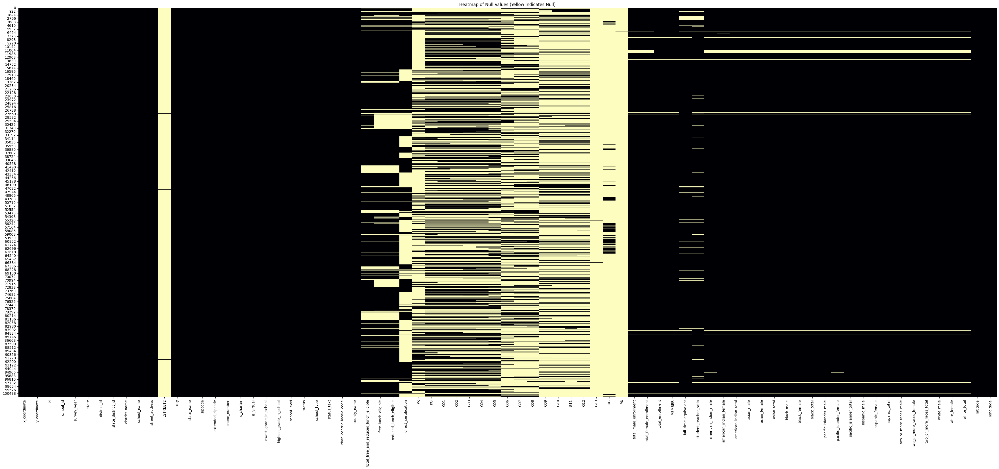

In [73]:
# Increase figure size to fit all features
plt.figure(figsize=(50, 20))  # Adjust width and height as needed

# Generate the heatmap of null values
heatmap = sns.heatmap(df.isnull(), cbar=False, cmap='magma')

# Rotate column labels for better readability
heatmap.set_xticklabels(df.columns, rotation=90)

# Set title for clarity
plt.title("Heatmap of Null Values (Yellow indicates Null)")

# Display the heatmap
plt.show()

##### LSTREET2 is dropped due to the high percentage of nulls

In [74]:
#percentage of null values in LSTREET2
print(df["LSTREET2"].isnull().sum()/len(df))
#drop LSTREET2
df = df.drop(columns=["LSTREET2"])



0.9943584179899398


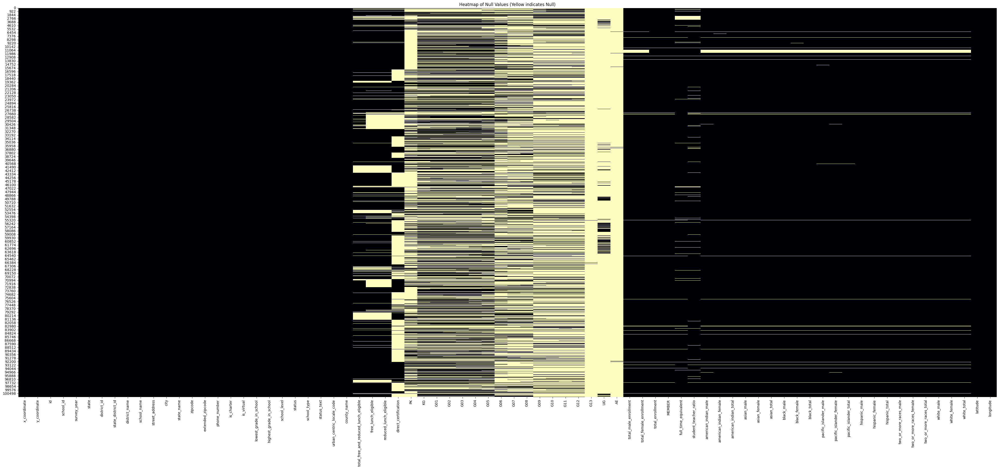

In [75]:
# Increase figure size to fit all features
plt.figure(figsize=(50, 20))  # Adjust width and height as needed

# Generate the heatmap of null values
heatmap = sns.heatmap(df.isnull(), cbar=False, cmap='magma')

# Rotate column labels for better readability
heatmap.set_xticklabels(df.columns, rotation=90)

# Set title for clarity
plt.title("Heatmap of Null Values (Yellow indicates Null)")

# Display the heatmap
plt.show()

In [76]:
df.shape

(101390, 76)

##### Checking if MEMBER and total_enrolment are the same column

In [77]:
#chcecking if the values are identical and the two features are just 1
are_columns_equal = (df['total_enrollment'] == df['MEMBER']).all()

if are_columns_equal:
    print("All values in the two columns are the same.")
else:
    print("Not all values in the two columns are the same.")

Not all values in the two columns are the same.


In [78]:
x = 0
y = 0

for i in range(len(df)):
    if df['total_enrollment'].iloc[i] == df['MEMBER'].iloc[i]:
        x += 1  # Increment count of same values
    else:
        y += 1  # Increment count of different values

print(f"Same Value: {x} \nDifferent Value: {y}")
#most of the data has the same value

Same Value: 99692 
Different Value: 1698


#### Exploring why there are some different values

##### First of all imputing the Grades, since they might be relevant

In [79]:
# Define the mapping of values to replace
replacement_dict = {
    '01': 'G01',
    '02': 'G02',
    '03': 'G03',
    '04': 'G04',
    '05': 'G05',
    '06': 'G06',
    '07': 'G07',
    '08': 'G08',
    '09': 'G09',
    '10': 'G10',
    '11': 'G11',
    '12': 'G12',
    '13': 'G13'
}

C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\3218190990.py:24: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax[0, 0].set_xticklabels(lowest_before.index, rotation=45)
C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\3218190990.py:30: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax[0, 1].set_xticklabels(highest_before.index, rotation=45)
C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\3218190990.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax[1, 0].set_xticklabels(lowest_after.index, rotation=45)
C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\3218190990.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax[1, 1].set_xticklabels(highes

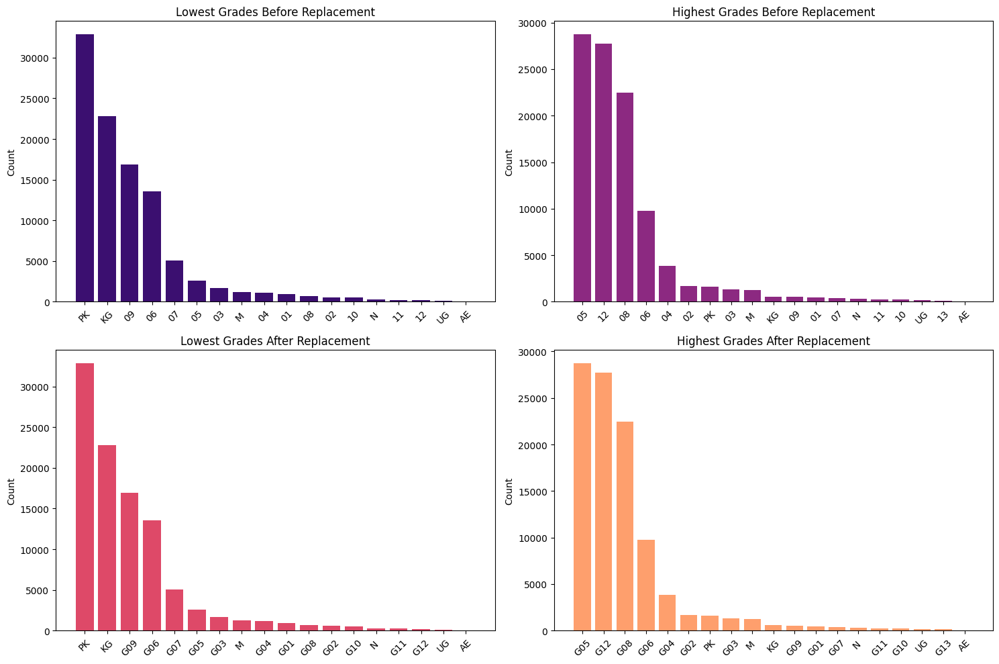

In [80]:
#making sure noting changed in the dataset 
import matplotlib.pyplot as plt
import numpy as np

# Before Replacement
lowest_before = df['lowest_grade_in_school'].value_counts()
highest_before = df['highest_grade_in_school'].value_counts()

# Replace values in the DataFrame
df['lowest_grade_in_school'] = df['lowest_grade_in_school'].replace(replacement_dict)
df['highest_grade_in_school'] = df['highest_grade_in_school'].replace(replacement_dict)

# After Replacement
lowest_after = df['lowest_grade_in_school'].value_counts()
highest_after = df['highest_grade_in_school'].value_counts()

# Create a bar graph for comparison
fig, ax = plt.subplots(2, 2, figsize=(15, 10))

# Lowest Grades Before Replacement
ax[0, 0].bar(lowest_before.index, lowest_before.values, color=plt.cm.magma(0.2))  # Adjust color intensity
ax[0, 0].set_title('Lowest Grades Before Replacement')
ax[0, 0].set_ylabel('Count')
ax[0, 0].set_xticklabels(lowest_before.index, rotation=45)

# Highest Grades Before Replacement
ax[0, 1].bar(highest_before.index, highest_before.values, color=plt.cm.magma(0.4))  # Adjust color intensity
ax[0, 1].set_title('Highest Grades Before Replacement')
ax[0, 1].set_ylabel('Count')
ax[0, 1].set_xticklabels(highest_before.index, rotation=45)

# Lowest Grades After Replacement
ax[1, 0].bar(lowest_after.index, lowest_after.values, color=plt.cm.magma(0.6))  # Adjust color intensity
ax[1, 0].set_title('Lowest Grades After Replacement')
ax[1, 0].set_ylabel('Count')
ax[1, 0].set_xticklabels(lowest_after.index, rotation=45)

# Highest Grades After Replacement
ax[1, 1].bar(highest_after.index, highest_after.values, color=plt.cm.magma(0.8))  # Adjust color intensity
ax[1, 1].set_title('Highest Grades After Replacement')
ax[1, 1].set_ylabel('Count')
ax[1, 1].set_xticklabels(highest_after.index, rotation=45)

# Adjust layout
plt.tight_layout()
plt.show()

##### Checking whether AE stands for Adult Education or Alternative Education

In [81]:
# to know if AE stand for Adult education or alternative education
# Get school names where the lowest or highest grade is "AE"
school_names_with_AE = df.loc[
    (df['lowest_grade_in_school'] == 'AE') | (df['highest_grade_in_school'] == 'AE'),
    'school_name'
]

# Display the school names
school_names_with_AE.head(100)

#We can confirm that AE stands for Adult Education

4768                             THE EXCEL CENTER
6131     Los Angeles Unified School District ROCP
6162               Santa Barbara County ROP-North
54626                   Churchill County Adult Ed
54969         So Desert Correctional Center Adult
54972              McClure  Florence Women's Corr
55024                 Douglas County Adult School
55059                             Adult Education
55083            Humboldt Adult Education Program
55087                      Lander County Adult Ed
55099            Lincoln County Adult High School
55119                 Lyon County Adult Education
55124              Mineral County Adult Education
55151                        NCSD Adult Education
55164                    Carson Adult High School
55279          RISE ACADEMY FOR ADULT ACHIEVEMENT
55302            Steptoe Valley Adult High School
82288                          ADULT LEARNING CTR
83269                                    ADULT ED
88890                     ADULT TRANSITION CENTER


###### Given that most schools that have students in 'AE' include Adult Education in the name, we can infer that AE stands for Adult Education.

##### Impute grades with 0 if the school doesn't provide that grade level

In [82]:
# replace grades with 0 based on lowest and highest grade
for index, row in df.iterrows():
    foundLow = False
    foundHigh = False
    bothSame = False

    lowest = row['lowest_grade_in_school']
    highest = row['highest_grade_in_school']
    
    if lowest == highest:
        bothSame = True

    for col in df.columns[30:47]:  # Slice columns starting from the third column
        if col != lowest and not foundLow:
            df.loc[index, col] = 0
        elif col == lowest and bothSame:
            foundLow = True
            fountHigh = True
        elif col == lowest and bothSame == False:
            foundLow = True
        elif col != highest and not foundHigh:
            pass
        elif col == highest:
            foundHigh = True
        elif col != highest and foundHigh:
            df.loc[index, col] = 0

In [83]:
#df is updated to show zeros for the grades that the school does not provide
df.head()

,x_coordinate,y_coordinate,id,school_id,survey_year,state,district_id,state_district_id,district_name,school_name,street_address,city,state_name,zipcode,extended_zipcode,phone_number,is_charter,is_virtual,lowest_grade_in_school,highest_grade_in_school,school_level,status,school_type,status_text,urban_centric_locale_code,county_name,total_free_and_reduced_lunch_eligible,free_lunch_eligible,reduced_lunch_eligible,direct_certification,PK,KG,G01,G02,G03,G04,G05,G06,G07,G08,G09,G10,G11,G12,G13,UG,AE,total_male_enrollment,total_female_enrollment,total_enrollment,MEMBER,full_time_equivalent,student_teacher_ratio,american_indian_male,american_indian_female,american_indian_total,asian_male,asian_female,asian_total,black_male,black_female,black_total,pacific_islander_male,pacific_islander_female,pacific_islander_total,hispanic_male,hispanic_female,hispanic_total,two_or_more_races_male,two_or_more_races_female,two_or_more_races_total,white_male,white_female,white_total,latitude,longitude
0,-9.596431e+06,4.063795e+06,1,10000500870,2022-2023,AL,100005,AL-101,Albertville City,Albertville Middle School,600 E Alabama Ave,Albertville,AL,35950,,(256)878-2341,No,Not Virtual,G07,G08,Middle,1,Regular School,Currently operational,32-Town: Distant,Marshall County,697.0,654.0,43.0,587.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,440.0,450.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,459.0,431.0,890.0,890.0,45.000000,19.78,4.0,1.0,5.0,4.0,2.0,6.0,15.0,14.0,29.0,0.0,1.0,1.0,251.0,251.0,502.0,17.0,15.0,32.0,168.0,147.0,315.0,34.2602,-86.206200
1,-9.596286e+06,4.064065e+06,2,10000500871,2022-2023,AL,100005,AL-101,Albertville City,Albertville High School,402 E McCord Ave,Albertville,AL,35950,2322,(256)894-5000,No,Not Virtual,G09,G12,High,1,Regular School,Currently operational,32-Town: Distant,Marshall County,1254.0,1178.0,76.0,1059.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,493.0,442.0,390.0,387.0,0.0,0.0,0.0,868.0,844.0,1712.0,1712.0,85.199997,20.09,0.0,2.0,2.0,4.0,5.0,9.0,23.0,34.0,57.0,0.0,0.0,0.0,490.0,468.0,958.0,26.0,19.0,45.0,325.0,316.0,641.0,34.2622,-86.204900
2,-9.597978e+06,4.065560e+06,3,10000500879,2022-2023,AL,100005,AL-101,Albertville City,Albertville Intermediate School,901 W McKinney Ave,Albertville,AL,35950,1300,(256)878-7698,No,Not Virtual,G05,G06,Middle,1,Regular School,Currently operational,32-Town: Distant,Marshall County,718.0,665.0,53.0,570.0,0.0,0.0,0.0,0.0,0.0,0.0,412.0,462.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,451.0,423.0,874.0,874.0,43.000000,20.33,1.0,4.0,5.0,4.0,0.0,4.0,22.0,28.0,50.0,0.0,0.0,0.0,263.0,241.0,504.0,7.0,6.0,13.0,154.0,144.0,298.0,34.2733,-86.220100
3,-9.598168e+06,4.062785e+06,4,10000500889,2022-2023,AL,100005,AL-101,Albertville City,Albertville Elementary School,145 West End Drive,Albertville,AL,35950,,(256)894-4822,No,Not Virtual,G03,G04,Elementary,1,Regular School,Currently operational,32-Town: Distant,Marshall County,723.0,680.0,43.0,583.0,0.0,0.0,0.0,0.0,430.0,444.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,463.0,411.0,874.0,874.0,43.000000,20.33,0.0,4.0,4.0,1.0,3.0,4.0,22.0,16.0,38.0,0.0,0.0,0.0,261.0,236.0,497.0,11.0,16.0,27.0,168.0,136.0,304.0,34.2527,-86.221806
4,-9.594995e+06,4.067783e+06,5,10000501616,2022-2023,AL,100005,AL-101,Albertville City,Albertville Kindergarten and PreK,257 Country Club Rd,Albertville,AL,35951,3927,(256)878-7922,No,Not Virtual,PK,KG,Elementary,1,Regular School,Currently operational,32-Town: Distant,Marshall County,392.0,367.0,25.0,240.0,133.0,473.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,304.0,302.0,606.0,606.0,26.000000,23.31,1.0,3.0,4.0,2.0,0.0,2.0,26.0,23.0,49.0,0.0,0.0,0.0,167.0,152.0,319.0,4.0,4.0,8.0,104.0,120.0,224.0,34.2898,-86.193300


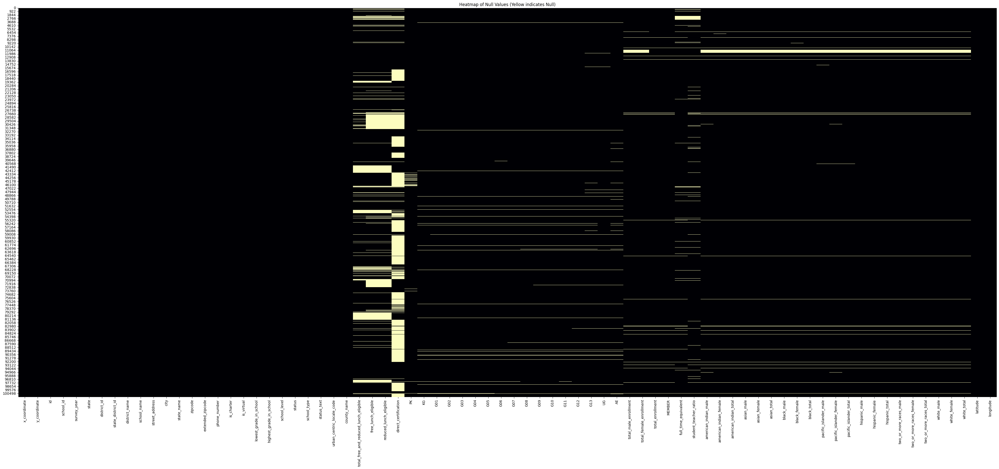

In [84]:
# Increase figure size to fit all features
plt.figure(figsize=(50, 20))  # Adjust width and height as needed

# Generate the heatmap of null values
heatmap = sns.heatmap(df.isnull(), cbar=False, cmap='magma')

# Rotate column labels for better readability
heatmap.set_xticklabels(df.columns, rotation=90)

# Set title for clarity
plt.title("Heatmap of Null Values (Yellow indicates Null)")

# Display the heatmap
plt.show()

In [85]:
# List of columns to check for null values
columns_to_check = ['PK', 'KG', 'G01', 'G02', 'G03', 'G04', 'G05', 
                    'G06', 'G07', 'G08', 'G09', 'G10', 'G11', 
                    'G12', 'G13', 'UG', 'AE']

# Create a DataFrame where any of the specified columns are null
null_rows_df = df[df[columns_to_check].isnull().any(axis=1)]

# Display the resulting DataFrame
null_rows_df.head(10)

#instances where the known grades levels in the school are null

,x_coordinate,y_coordinate,id,school_id,survey_year,state,district_id,state_district_id,district_name,school_name,street_address,city,state_name,zipcode,extended_zipcode,phone_number,is_charter,is_virtual,lowest_grade_in_school,highest_grade_in_school,school_level,status,school_type,status_text,urban_centric_locale_code,county_name,total_free_and_reduced_lunch_eligible,free_lunch_eligible,reduced_lunch_eligible,direct_certification,PK,KG,G01,G02,G03,G04,G05,G06,G07,G08,G09,G10,G11,G12,G13,UG,AE,total_male_enrollment,total_female_enrollment,total_enrollment,MEMBER,full_time_equivalent,student_teacher_ratio,american_indian_male,american_indian_female,american_indian_total,asian_male,asian_female,asian_total,black_male,black_female,black_total,pacific_islander_male,pacific_islander_female,pacific_islander_total,hispanic_male,hispanic_female,hispanic_total,two_or_more_races_male,two_or_more_races_female,two_or_more_races_total,white_male,white_female,white_total,latitude,longitude
8,-9.603578e+06,4.083571e+06,9,10000600876,2022-2023,AL,100006,AL-048,Marshall County,Claysville School,140 Claysville School Rd,Guntersville,AL,35976,,(256)582-4444,No,Not Virtual,PK,PK,Prekindergarten,1,Regular School,Currently operational,41-Rural: Fringe,Marshall County,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,34.406900,-86.270400
50,-9.656679e+06,4.121297e+06,51,10000802522,2022-2023,AL,100008,AL-169,Madison City,Journey Middle School,217 Celtic Drive,Madison,AL,35758,,(256)464-8370,No,Not Reported,G06,G08,Middle,7,Regular School,School to be operational within two years,21-Suburb: Large,Madison County,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,34.686038,-86.747416
51,-9.584445e+06,3.952782e+06,52,10000901403,2022-2023,AL,100009,AL-600,Al Inst Deaf And Blind,Alabama School For Deaf,205 E South Street,Talladega,AL,35160,2411,(256)761-3214,No,Not Virtual,KG,G12,Other,1,Special Education School,Currently operational,32-Town: Distant,Talladega County,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33.431960,-86.098534
52,-9.583461e+06,3.952997e+06,53,10000901404,2022-2023,AL,100009,AL-600,Al Inst Deaf And Blind,Alabama School For Blind,705 E South Street,Talladega,AL,35160,,(256)761-3259,No,Not Virtual,KG,G12,Other,1,Special Education School,Currently operational,32-Town: Distant,Talladega County,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33.433574,-86.089689
53,-9.586554e+06,3.952157e+06,54,10000901405,2022-2023,AL,100009,AL-600,Al Inst Deaf And Blind,Helen Keller School,1221 Cochran Ave,Talladega,AL,35161,,(256)761-3250,No,Not Virtual,KG,G12,Other,1,Special Education School,Currently operational,32-Town: Distant,Talladega County,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33.427279,-86.117477
54,-9.586580e+06,3.951912e+06,55,10000901406,2022-2023,AL,100009,AL-600,Al Inst Deaf And Blind,E H Gentry Technical Facility,1105 Fort Lashley,Talladega,AL,35160,,(256)761-3402,No,Not Virtual,G07,G12,High,1,Special Education School,Currently operational,32-Town: Distant,Talladega County,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33.425440,-86.117706
55,-9.639206e+06,4.126225e+06,56,10000902

In [86]:
# List of columns to check for null values
columns_to_check = ['PK', 'KG', 'G01', 'G02', 'G03', 'G04', 'G05', 
                    'G06', 'G07', 'G08', 'G09', 'G10', 'G11', 
                    'G12', 'G13', 'UG', 'AE']  # Replace with your actual column names

# Count the number of rows where any of the specified columns are null
null_count = df[columns_to_check].isnull().any(axis=1).sum()

# Print the count of rows with null values
print(f"Number of rows where any of the specified columns are null: {null_count}")

Number of rows where any of the specified columns are null: 3841


##### 3841 represents the number of rows where there is no data in grades that are offered by the school

In [ ]:
# Select only numeric columns for correlation

specific_columns = ['x_coordinate', 'y_coordinate', 'id', 'school_id', 'district_id', 'state_district_id', 'status', 'total_free_and_reduced_lunch_eligible', 'free_lunch_eligible',
       'reduced_lunch_eligible',  'direct_certification', 'total_enrollment', 'MEMBER',
       'full_time_equivalent', 'student_teacher_ratio', 'american_indian_total', 'asian_total', 'black_total', 'pacific_islander_total', 'hispanic_total', 'tribal_total', 'white_total',
       'latitude_code', 'longitude_code']
numeric_df = df[specific_columns].select_dtypes(include=['number'])

# correlation matrix calculation
cormat = numeric_df.corr()

# heatmap
plt.figure(figsize=(100,100))
sns.set(font_scale=5.0)

ax = sns.heatmap(
    cormat,
    vmin=-1, vmax=1, center=0,
    cmap='magma',
    square=True, 
    annot=True,  # Show correlation values
    annot_kws={'size': 50}
)

plt.title('Correlation Matrix Heatmap', fontsize=100)
plt.show()


##### This correlation matrix shows that 

##### Drop rows where any of the grades are null

###### The missing values are dependent on other features that add up to MEMBER, so imputing the missing values would cause data inaccuracy since the numbers won't add up correctly.
###### Since the number of nulls are relatively small and imputing the grade columns might cause data inaccuracy, I chose to drop them

In [87]:
# List of columns to check for null values
columns_to_check = ['PK', 'KG', 'G01', 'G02', 'G03', 'G04', 'G05', 
                    'G06', 'G07', 'G08', 'G09', 'G10', 'G11', 
                    'G12', 'G13', 'UG', 'AE']  # Replace with your actual column names

# Drop rows where any of the specified columns are null
df.dropna(subset=columns_to_check, inplace=True)

# Optionally, print the shape of the DataFrame after dropping rows
print(f"New shape of the DataFrame after dropping rows with nulls in specified columns: {df.shape}")

New shape of the DataFrame after dropping rows with nulls in specified columns: (97549, 76)


In [88]:
# Calculate the total number of rows in the DataFrame
total_rows = df.shape[0]

# Calculate the number of nulls and then the percentage of nulls
null_columns = df.isnull().sum()
null_percentage = (null_columns[null_columns > 0] / total_rows) * 100  # Calculate percentage

fig = go.Figure()
fig.add_trace(go.Bar(
    x=null_percentage.index,
    y=null_percentage,
    marker=dict(
        color=null_percentage,
        colorscale='magma',
        colorbar=dict(title='Percentage of Nulls')
    ),  
    text=[f"{round(p, 2)}%" for p in null_percentage],  # Show percentage as text
    textposition='outside'  # Position text outside the bars
))

# Update layout with increased figure size
fig.update_layout(
    title='Percentage Of Nulls Per Column',
    xaxis_title='Columns',
    yaxis_title='Percentage of Nulls',
    width=1200,  # Set the width of the figure
    height=600   # Set the height of the figure
)

fig.show()

###### Due to the small percentage of null values in these columns, I dropped the rows that had nulls.

In [89]:
columns_to_drop = ['american_indian_male',
       'american_indian_female', 'american_indian_total', 'asian_male',
       'asian_female', 'asian_total', 'black_male', 'black_female',
       'black_total', 'pacific_islander_male', 'pacific_islander_female',
       'pacific_islander_total', 'hispanic_male', 'hispanic_female',
       'hispanic_total', 'tribal_male', 'tribal_female',
       'tribal_total', 'white_male', 'white_female', 'white_total', 'total_enrollment', 'MEMBER']  # Replace with your actual column names

# Drop rows where any of the specified columns are null
df.dropna(subset=columns_to_drop, inplace=True)

In [90]:
sumBoth = 0
sumTotal = 0
sumMember = 0
BothDiff = 0
for i in range(len(df)):
    sum = df.iloc[i, 30:47].sum()  # Adjust the column indices as needed
    males = df['total_male_enrollment'].iloc[i]
    females = df['total_female_enrollment'].iloc[i]
    total = df['total_enrollment'].iloc[i]
    members = df['MEMBER'].iloc[i]
    if sum != total and sum != members:
        print("Sum not equal to total enrollement or member")
        print(f"Sum: {sum} total: {total} malesAndFemales: {males+females} member: {members}")
        print("---------------------------------------------------------------------")
        BothDiff = BothDiff + 1
    elif sum != members:
        print(f"Sum equal to total but not member")
        print(f"Sum: {sum} total: {total} malesAndFemales: {males+females} member: {members}")
        print("---------------------------------------------------------------------")
        sumTotal = sumTotal + 1
    elif sum != total:
        print(f"Sum equal to member but not total")
        print(f"Sum: {sum} total: {total} malesAndFemales: {males+females} member: {members}")
        print("---------------------------------------------------------------------")
        sumMember = sumMember + 1
    else:
        sumBoth = sumBoth + 1
    

print(f"Same with Total: {sumTotal}  Same with Member: {sumMember} Same with Both: {sumBoth} Different Both: {BothDiff}")

Sum not equal to total enrollement or member
Sum: 198.0 total: 236.0 malesAndFemales: 236.0 member: 236.0
---------------------------------------------------------------------
Sum not equal to total enrollement or member
Sum: 1109.0 total: 1113.0 malesAndFemales: 1113.0 member: 1113.0
---------------------------------------------------------------------
Sum not equal to total enrollement or member
Sum: 508.0 total: 509.0 malesAndFemales: 509.0 member: 509.0
---------------------------------------------------------------------
Sum not equal to total enrollement or member
Sum: 401.0 total: 403.0 malesAndFemales: 403.0 member: 403.0
---------------------------------------------------------------------
Sum not equal to total enrollement or member
Sum: 531.0 total: 537.0 malesAndFemales: 537.0 member: 537.0
---------------------------------------------------------------------
Sum not equal to total enrollement or member
Sum: 314.0 total: 332.0 malesAndFemales: 332.0 member: 332.0
----------

In [91]:
sumBoth = 0
sumTotal = 0
sumMember = 0
BothDiff = 0
for i in range(len(df)):
    sum = df.iloc[i, 30:47].sum()  # Adjust the column indices as needed
    males = df['total_male_enrollment'].iloc[i]
    females = df['total_female_enrollment'].iloc[i]
    total = df['total_enrollment'].iloc[i]
    members = df['MEMBER'].iloc[i]
    if males+females != total and males+females != members:
        print("Sum not equal to total enrollement or member")
        print(f"Sum: {sum} total: {total} malesAndFemales: {males+females} member: {members}")
        print("---------------------------------------------------------------------")
        BothDiff = BothDiff + 1
    elif males+females != members:
        print(f"Sum equal to total but not member")
        print(f"Sum: {sum} total: {total} malesAndFemales: {males+females} member: {members}")
        print("---------------------------------------------------------------------")
        sumTotal = sumTotal + 1
    elif males+females != total:
        print(f"Sum equal to member but not total")
        print(f"Sum: {sum} total: {total} malesAndFemales: {males+females} member: {members}")
        print("---------------------------------------------------------------------")
        sumMember = sumMember + 1
    else:
        sumBoth = sumBoth + 1
    

print(f"Same with Total: {sumTotal}  Same with Member: {sumMember} Same with Both: {sumBoth} Different Both: {BothDiff}")

Sum not equal to total enrollement or member
Sum: 359.0 total: 359.0 malesAndFemales: 358.0 member: 359.0
---------------------------------------------------------------------
Sum not equal to total enrollement or member
Sum: 294.0 total: 294.0 malesAndFemales: 293.0 member: 294.0
---------------------------------------------------------------------
Sum not equal to total enrollement or member
Sum: 236.0 total: 236.0 malesAndFemales: 235.0 member: 236.0
---------------------------------------------------------------------
Sum not equal to total enrollement or member
Sum: 615.0 total: 615.0 malesAndFemales: 614.0 member: 615.0
---------------------------------------------------------------------
Sum not equal to total enrollement or member
Sum: 303.0 total: 303.0 malesAndFemales: 302.0 member: 303.0
---------------------------------------------------------------------
Sum not equal to total enrollement or member
Sum: 279.0 total: 279.0 malesAndFemales: 278.0 member: 279.0
--------------

###### The columns appear to have the same value for most of the data except for certain situations where data accuracy is questioned

In [92]:
# Define the column groups
grade_columns = ['PK', 'KG', 'G01', 'G02', 'G03', 'G04', 'G05', 
                 'G06', 'G07', 'G08', 'G09', 'G10', 'G11', 
                 'G12', 'G13', 'UG', 'AE']
enrollment_columns = ['total_female_enrollment', 'total_male_enrollment']

# Calculate the sums for each row
df['sum_grades'] = df[grade_columns].sum(axis=1)
df['sum_gender_enrollment'] = df[enrollment_columns].sum(axis=1)

# Filter rows where all values match
df = df[(df['MEMBER'] == df['total_enrollment']) &
          (df['MEMBER'] == df['sum_grades']) &
          (df['MEMBER'] == df['sum_gender_enrollment'])]

# Drop the temporary columns used for calculations
df = df.drop(columns=['sum_grades', 'sum_gender_enrollment'])

# Display the filtered dataframe
print(df.shape)


(82256, 76)


In [93]:
same = 0
diff = 0
BothSame = 0
NotBothSame = 0

# List to hold indices of rows to drop
indices_to_drop = []

for i in range(len(df)):
    sum = df.iloc[i, 30:47].sum()  # Adjust the column indices as needed
    males = df['total_male_enrollment'].iloc[i]
    females = df['total_female_enrollment'].iloc[i]
    total = df['total_enrollment'].iloc[i]
    members = df['MEMBER'].iloc[i]
    
    if total == members:
        if sum == females + males:
            same += 1  # Increment same counter if conditions are met
        else:
            diff = diff + 1  # Add index to drop list
    else:
        diff = diff + 1  
        
print(f'diff: {diff} same: {same}')

diff: 0 same: 82256


### Feature Dropping

In [94]:
#dropping repeated columns
df.drop(columns=["MEMBER",'state_name'],inplace= True)
#member repeated with total enrollment and state name is identical to state

In [95]:
#has encoded column 
df.drop(columns=['status_text','district_name'], inplace= True)

C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\3284859559.py:23: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



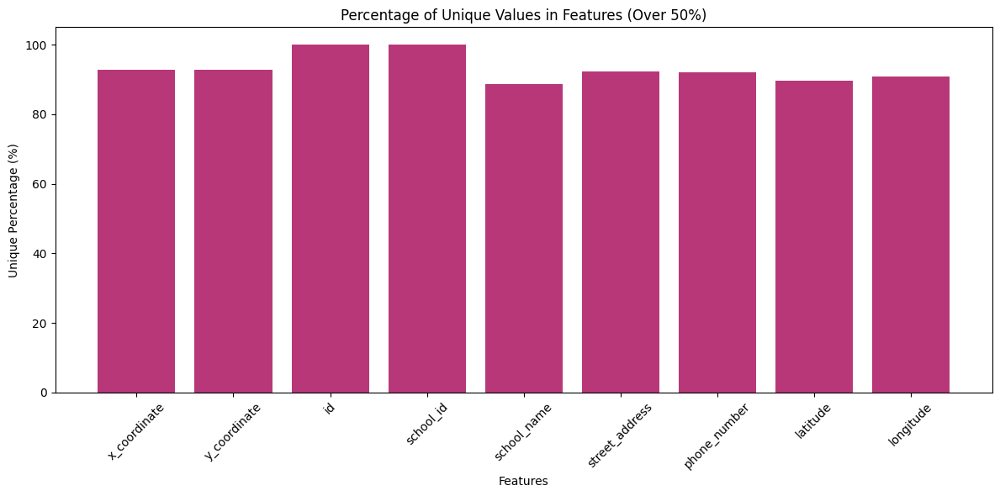

In [96]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm  # Import the colormap module

# Calculate the percentage of unique values for each feature in the DataFrame
unique_percentages = {}
total_rows = len(df)  # Total number of rows in the DataFrame

# Iterate through all columns in the DataFrame
for feature in df.columns:
    unique_count = df[feature].nunique()  # Count of unique values
    unique_percentage = (unique_count / total_rows) * 100  # Calculate percentage
    unique_percentages[feature] = unique_percentage  # Store in dictionary

# Convert the dictionary to a DataFrame for plotting
unique_df = pd.DataFrame(list(unique_percentages.items()), columns=['Feature', 'Unique Percentage'])

# Filter for features with unique percentage over 50%
filtered_unique_df = unique_df[unique_df['Unique Percentage'] > 50]

# Plotting the results for filtered features
plt.figure(figsize=(12, 6))
plt.bar(filtered_unique_df['Feature'], filtered_unique_df['Unique Percentage'], color=cm.get_cmap('magma')(0.5))  # Use colormap
plt.title('Percentage of Unique Values in Features (Over 50%)')
plt.xlabel('Features')
plt.ylabel('Unique Percentage (%)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [97]:
df.drop(columns=['x_coordinate', 'y_coordinate', 'id', 'school_id', 'school_name', 'street_address', 'phone_number', 'latitude', 'longitude'], inplace = True)

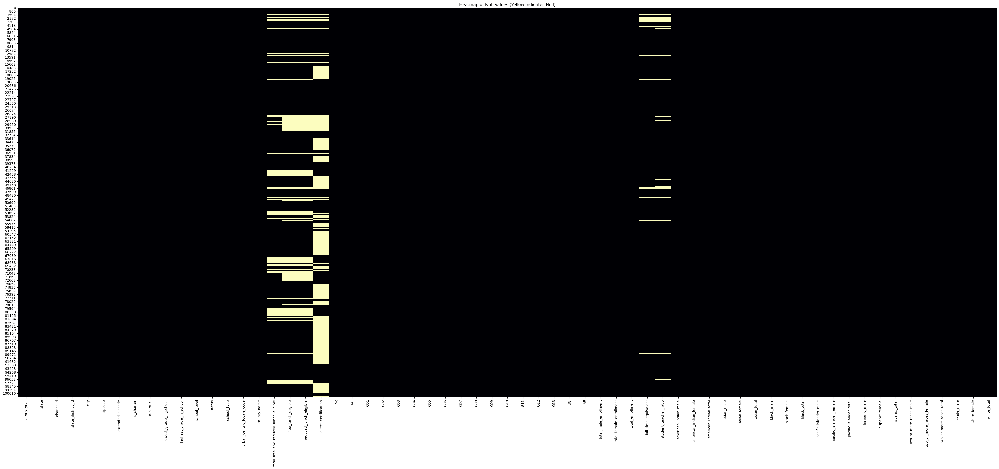

In [98]:
# Increase figure size to fit all features
plt.figure(figsize=(50, 20))  # Adjust width and height as needed

# Generate the heatmap of null values
heatmap = sns.heatmap(df.isnull(), cbar=False, cmap='magma')

# Rotate column labels for better readability
heatmap.set_xticklabels(df.columns, rotation=90)

# Set title for clarity
plt.title("Heatmap of Null Values (Yellow indicates Null)")

# Display the heatmap
plt.show()

C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\2691361093.py:13: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




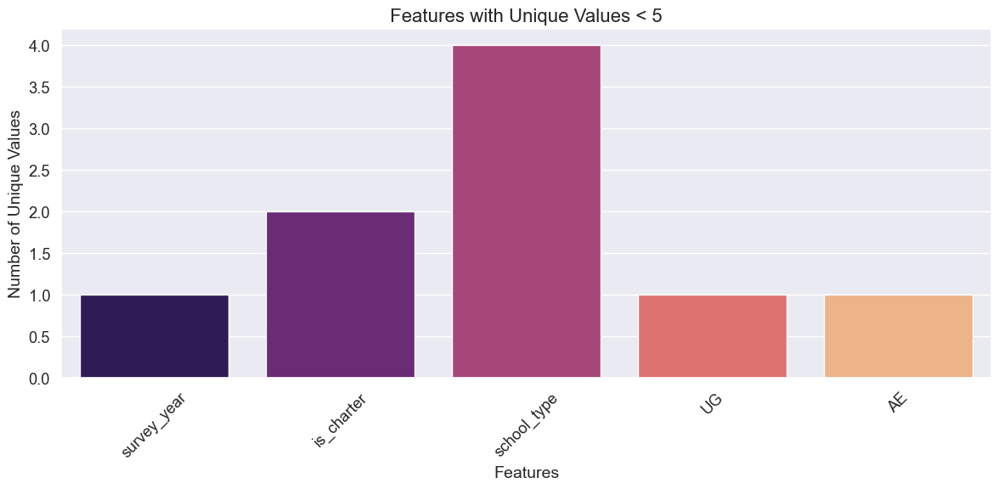

In [99]:
sns.set(font_scale=1.2)

# Calculate the number of unique values for each feature
unique_counts = df.nunique()

# Filter features with unique values less than 5
filtered_unique_counts = unique_counts[unique_counts < 5]

# Set the figure size
plt.figure(figsize=(12, 6))  # Adjusted for better visibility

# Create a bar plot for the number of unique values
sns.barplot(x=filtered_unique_counts.index, y=filtered_unique_counts.values, palette='magma')

# Set the title and labels
plt.title('Features with Unique Values < 5', fontsize=16)
plt.xlabel('Features', fontsize=14)
plt.ylabel('Number of Unique Values', fontsize=14)

# Rotate x-tick labels for better readability
plt.xticks(rotation=45)

# Display the plot
plt.tight_layout()
plt.show()

In [100]:
df.drop(columns=['survey_year','UG','AE'], inplace=True)

### Data Imputation

In [101]:
df_imputed = df.copy()

In [102]:
df_imputed.info()

<class 'pandas.core.frame.DataFrame'>
Index: 82256 entries, 0 to 101389
Data columns (total 60 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   state                                  82256 non-null  object 
 1   district_id                            82256 non-null  int64  
 2   state_district_id                      82256 non-null  object 
 3   city                                   82256 non-null  object 
 4   zipcode                                82256 non-null  int64  
 5   extended_zipcode                       82256 non-null  object 
 6   is_charter                             82256 non-null  object 
 7   is_virtual                             82256 non-null  object 
 8   lowest_grade_in_school                 82256 non-null  object 
 9   highest_grade_in_school                82256 non-null  object 
 10  school_level                           82256 non-null  object 
 11  status

In [103]:
#Imputing int features
knn_imputer = KNNImputer(n_neighbors=5)  

#imputing int values only 

# Select the column to impute
int_columns_to_impute = [ 'total_free_and_reduced_lunch_eligible',
                     'free_lunch_eligible', 'reduced_lunch_eligible', 
                     'direct_certification']


# Fit the imputer and transform the data
imputed_data = knn_imputer.fit_transform(df_imputed[int_columns_to_impute])

# Replace the original column with the imputed values and convert to int
df_imputed[int_columns_to_impute] = imputed_data.astype(int)


In [104]:
print(df_imputed[['total_free_and_reduced_lunch_eligible',
                     'free_lunch_eligible', 'reduced_lunch_eligible', 
                     'direct_certification']].isnull().sum())  # Check for any remaining nulls

total_free_and_reduced_lunch_eligible    0
free_lunch_eligible                      0
reduced_lunch_eligible                   0
direct_certification                     0
dtype: int64


In [105]:

# Imputing float features
knn_imputer = KNNImputer(n_neighbors=5)  # You can adjust the number of neighbors as needed

# Select the relevant columns for imputation (including total_enrollment)
float_columns_to_impute = ['full_time_equivalent', 'student_teacher_ratio']

# Fit the imputer and transform the data
df_imputed[float_columns_to_impute] = knn_imputer.fit_transform(df_imputed[float_columns_to_impute])

# Display the updated DataFrame
print(df_imputed[['full_time_equivalent', 'student_teacher_ratio']].isnull().sum())  # Check for any remaining nulls

full_time_equivalent     0
student_teacher_ratio    0
dtype: int64


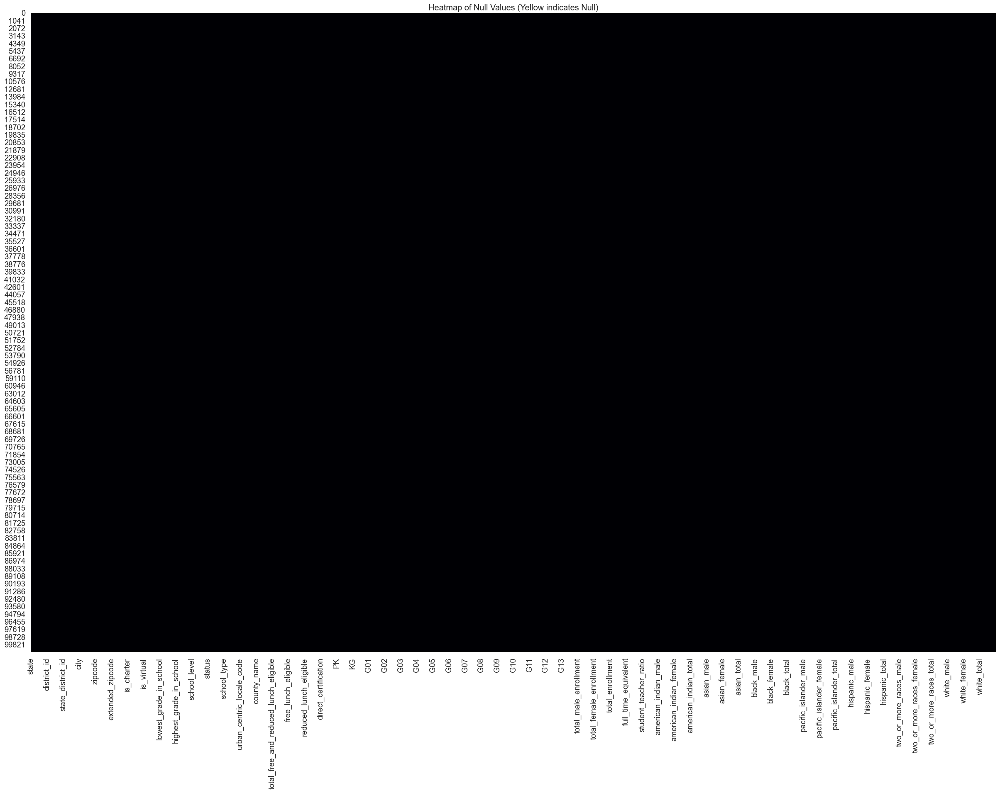

In [106]:
# Increase figure size to fit all features
plt.figure(figsize=(30, 20))  # Adjust width and height as needed

# Generate the heatmap of null values
heatmap = sns.heatmap(df_imputed.isnull(), cbar=False, cmap='magma')

# Set x-tick labels correctly and rotate them for better readability
heatmap.set_xticks(range(len(df_imputed.columns)))  # Set the correct number of ticks
heatmap.set_xticklabels(df_imputed.columns, rotation=90)

# Set title for clarity
plt.title("Heatmap of Null Values (Yellow indicates Null)")

# Display the heatmap
plt.show()


### Checking Data Distribution After Imputation

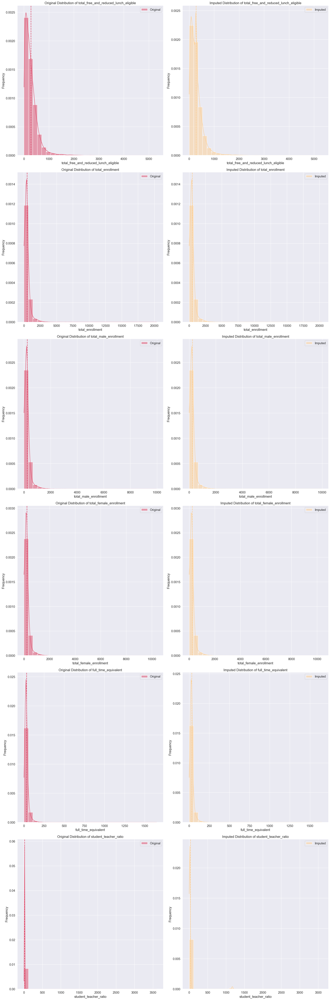

In [107]:
import matplotlib.pyplot as plt
import seaborn as sns

# List of 6 features to plot
features_to_plot = [
    'total_free_and_reduced_lunch_eligible',
    'total_enrollment',
    'total_male_enrollment',
    'total_female_enrollment',
    'full_time_equivalent',
    'student_teacher_ratio'
]  # Add or modify features as needed

# Set the number of rows and columns for subplots
n_features = len(features_to_plot)
n_cols = 2  # Number of columns for subplots
n_rows = (n_features * 2 + n_cols - 1) // n_cols  # Calculate number of rows needed for original and imputed

plt.figure(figsize=(20, 10 * n_rows))  # Adjust figure size based on number of features

for i, feature in enumerate(features_to_plot):
    # Original distribution
    plt.subplot(n_rows, n_cols, i * 2 + 1)  # Adjust index for original
    sns.histplot(df[feature], bins=30, kde=True, color=plt.cm.magma(0.6), label='Original', stat='density')
    plt.axvline(df[feature].mean(), color=plt.cm.magma(0.6), linestyle='dashed', linewidth=2)
    plt.title(f'Original Distribution of {feature}')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.legend()

    # Imputed distribution
    plt.subplot(n_rows, n_cols, i * 2 + 2)  # Adjust index for imputed
    sns.histplot(df_imputed[feature], bins=30, kde=True, color=plt.cm.magma(0.9), label='Imputed', stat='density')
    plt.axvline(df_imputed[feature].mean(), color=plt.cm.magma(0.9), linestyle='dashed', linewidth=2)
    plt.title(f'Imputed Distribution of {feature}')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.legend()

plt.tight_layout()
plt.show()

In [108]:
df[['total_free_and_reduced_lunch_eligible',
    'total_enrollment',
    'total_male_enrollment',
    'total_female_enrollment',
    'full_time_equivalent',
    'student_teacher_ratio']].describe().T

,count,mean,std,min,25%,50%,75%,max
total_free_and_reduced_lunch_eligible,71244.0,277.816728,265.548511,0.0,101.00,214.000000,375.000000,5314.000000
total_enrollment,82256.0,480.391096,440.197036,0.0,226.00,404.000000,610.000000,20355.000000
total_male_enrollment,82256.0,246.310445,223.523316,0.0,115.00,207.000000,314.000000,9978.000000
total_female_enrollment,82256.0,234.080651,218.290155,0.0,109.00,196.000000,297.000000,10377.000000
full_time_equivalent,80022.0,31.537568,25.264147,0.0,17.00,27.200001,39.970001,1648.119995
student_teacher_ratio,78655.0,15.666474,22.944715,0.0,12.23,14.690000,17.500000,3600.000000


In [109]:
df_imputed[['total_free_and_reduced_lunch_eligible',
    'total_enrollment',
    'total_male_enrollment',
    'total_female_enrollment',
    'full_time_equivalent',
    'student_teacher_ratio']].describe().T

,count,mean,std,min,25%,50%,75%,max
total_free_and_reduced_lunch_eligible,82256.0,276.711826,252.655639,0.0,108.000000,231.000000,360.00,5314.000000
total_enrollment,82256.0,480.391096,440.197036,0.0,226.000000,404.000000,610.00,20355.000000
total_male_enrollment,82256.0,246.310445,223.523316,0.0,115.000000,207.000000,314.00,9978.000000
total_female_enrollment,82256.0,234.080651,218.290155,0.0,109.000000,196.000000,297.00,10377.000000
full_time_equivalent,82256.0,31.537568,24.918705,0.0,17.190001,27.950001,39.41,1648.119995
student_teacher_ratio,82256.0,34.850168,149.265013,0.0,12.370000,14.890000,17.61,3600.000000


###### student_teacher_ratio distribution has changed (mean and standard deviation significantly increased)

In [110]:
df_imputed['student_teacher_ratio'] = df['student_teacher_ratio']
print(f"Null Values in Student Teacher Ratio Feature: {df_imputed['student_teacher_ratio'].isnull().sum()}")

Null Values in Student Teacher Ratio Feature: 3601


In [111]:
# Impute missing values of 'student_teacher_ratio' with the mean of the entire column
df_imputed['student_teacher_ratio'] = df_imputed['student_teacher_ratio'].fillna(df_imputed['student_teacher_ratio'].mean())


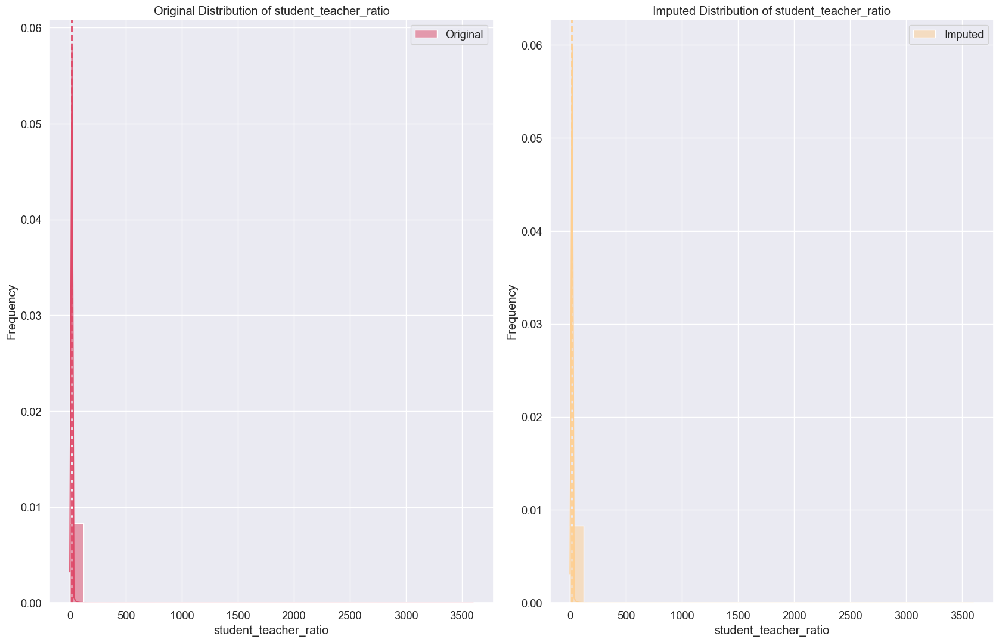

In [112]:
import matplotlib.pyplot as plt
import seaborn as sns

# Specify the feature to plot
feature_to_plot = 'student_teacher_ratio'

plt.figure(figsize=(17, 11))  # Adjust figure size

# Original distribution
plt.subplot(1, 2, 1)  # One row, two columns, first subplot
sns.histplot(df[feature_to_plot], bins=30, kde=True, color=plt.cm.magma(0.6), label='Original', stat='density')
plt.axvline(df[feature_to_plot].mean(), color=plt.cm.magma(0.6), linestyle='dashed', linewidth=2)
plt.title(f'Original Distribution of {feature_to_plot}')
plt.xlabel(feature_to_plot)
plt.ylabel('Frequency')
plt.legend()

# Imputed distribution
plt.subplot(1, 2, 2)  # One row, two columns, second subplot
sns.histplot(df_imputed[feature_to_plot], bins=30, kde=True, color=plt.cm.magma(0.9), label='Imputed', stat='density')
plt.axvline(df_imputed[feature_to_plot].mean(), color=plt.cm.magma(0.9), linestyle='dashed', linewidth=2)
plt.title(f'Imputed Distribution of {feature_to_plot}')
plt.xlabel(feature_to_plot)
plt.ylabel('Frequency')
plt.legend()

plt.tight_layout()
plt.show()

In [113]:
df['student_teacher_ratio'].describe().T

count    78655.000000
mean        15.666474
std         22.944715
min          0.000000
25%         12.230000
50%         14.690000
75%         17.500000
max       3600.000000
Name: student_teacher_ratio, dtype: float64

In [114]:
df_imputed['student_teacher_ratio'].describe().T

count    82256.000000
mean        15.666474
std         22.436852
min          0.000000
25%         12.370000
50%         14.890000
75%         17.330000
max       3600.000000
Name: student_teacher_ratio, dtype: float64

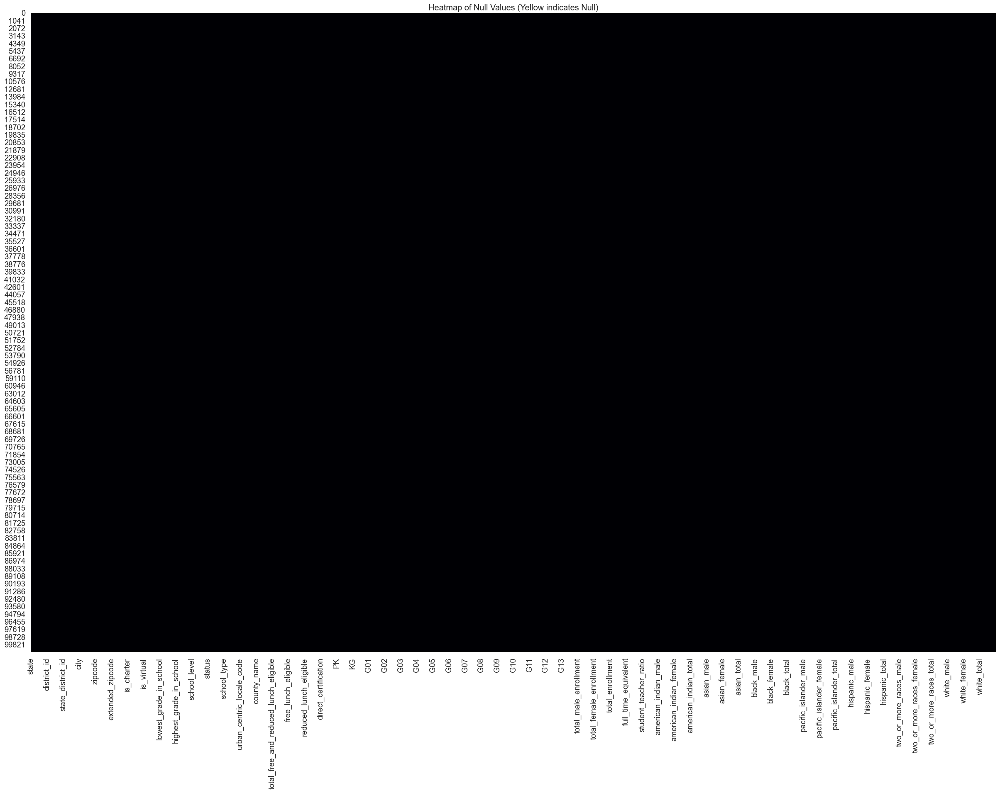

In [115]:
# Increase figure size to fit all features
plt.figure(figsize=(30, 20))  # Adjust width and height as needed

# Generate the heatmap of null values
heatmap = sns.heatmap(df_imputed.isnull(), cbar=False, cmap='magma')

# Set x-tick labels correctly and rotate them for better readability
heatmap.set_xticks(range(len(df_imputed.columns)))  # Set the correct number of ticks
heatmap.set_xticklabels(df_imputed.columns, rotation=90)

# Set title for clarity
plt.title("Heatmap of Null Values (Yellow indicates Null)")

# Display the heatmap
plt.show()


In [2]:
df_imputed.to_csv("imputed_school.csv", index = False)

In [119]:
df_imputed = pd.read_csv("imputed_school.csv")

### Outliers

In [120]:
def calculate_outlier_percentage(series):
    Q1 = series.quantile(0.25)
    Q3 = series.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Find the number of outliers
    outliers = ((series < lower_bound) | (series > upper_bound)).sum()
    
    # Calculate the percentage of outliers
    percentage = (outliers / len(series)) * 100
    return percentage

# Iterate over each numerical column and print the outlier percentage
for col in df_imputed.select_dtypes(include='number').columns:
    percentage = calculate_outlier_percentage(df_imputed[col])
    if percentage>5:
        print(f'Column "{col}": {percentage:.2f}% outliers')



Column "reduced_lunch_eligible": 5.88% outliers
Column "PK": 13.08% outliers
Column "G06": 12.62% outliers
Column "G07": 19.32% outliers
Column "G08": 18.77% outliers
Column "G09": 22.87% outliers
Column "G10": 23.32% outliers
Column "G11": 23.58% outliers
Column "G12": 23.42% outliers
Column "total_female_enrollment": 5.11% outliers
Column "total_enrollment": 5.06% outliers
Column "student_teacher_ratio": 6.50% outliers
Column "american_indian_male": 14.28% outliers
Column "american_indian_female": 13.70% outliers
Column "american_indian_total": 8.74% outliers
Column "asian_male": 13.10% outliers
Column "asian_female": 14.16% outliers
Column "asian_total": 13.64% outliers
Column "black_male": 11.36% outliers
Column "black_female": 11.61% outliers
Column "black_total": 11.42% outliers
Column "pacific_islander_male": 23.98% outliers
Column "pacific_islander_female": 23.06% outliers
Column "pacific_islander_total": 11.42% outliers
Column "hispanic_male": 8.82% outliers
Column "hispanic_f

In [121]:
def calculate_outlier_percentage(series):
    Q1 = series.quantile(0.25)
    Q3 = series.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Find the number of outliers
    outliers = ((series < lower_bound) | (series > upper_bound)).sum()
    
    # Calculate the percentage of outliers
    percentage = (outliers / len(series)) * 100
    return percentage

# Iterate over each numerical column and print the outlier percentage
for col in df_imputed.select_dtypes(include='number').columns:
    percentage = calculate_outlier_percentage(df_imputed[col])
    if (percentage>10) and df_imputed[col].nunique()>13 : # since they are numerical in their nature, we want to take care of their outliers
        print(f'Column "{col}": {percentage:.2f}% outliers')



Column "PK": 13.08% outliers
Column "G06": 12.62% outliers
Column "G07": 19.32% outliers
Column "G08": 18.77% outliers
Column "G09": 22.87% outliers
Column "G10": 23.32% outliers
Column "G11": 23.58% outliers
Column "G12": 23.42% outliers
Column "american_indian_male": 14.28% outliers
Column "american_indian_female": 13.70% outliers
Column "asian_male": 13.10% outliers
Column "asian_female": 14.16% outliers
Column "asian_total": 13.64% outliers
Column "black_male": 11.36% outliers
Column "black_female": 11.61% outliers
Column "black_total": 11.42% outliers
Column "pacific_islander_male": 23.98% outliers
Column "pacific_islander_female": 23.06% outliers
Column "pacific_islander_total": 11.42% outliers


In [122]:
df_imputed.columns

Index(['state', 'district_id', 'state_district_id', 'city', 'zipcode',
       'extended_zipcode', 'is_charter', 'is_virtual',
       'lowest_grade_in_school', 'highest_grade_in_school', 'school_level',
       'status', 'school_type', 'urban_centric_locale_code', 'county_name',
       'total_free_and_reduced_lunch_eligible', 'free_lunch_eligible',
       'reduced_lunch_eligible', 'direct_certification', 'PK', 'KG', 'G01',
       'G02', 'G03', 'G04', 'G05', 'G06', 'G07', 'G08', 'G09', 'G10', 'G11',
       'G12', 'G13', 'total_male_enrollment', 'total_female_enrollment',
       'total_enrollment', 'full_time_equivalent', 'student_teacher_ratio',
       'american_indian_male', 'american_indian_female',
       'american_indian_total', 'asian_male', 'asian_female', 'asian_total',
       'black_male', 'black_female', 'black_total', 'pacific_islander_male',
       'pacific_islander_female', 'pacific_islander_total', 'hispanic_male',
       'hispanic_female', 'hispanic_total', 'two_or_more_race

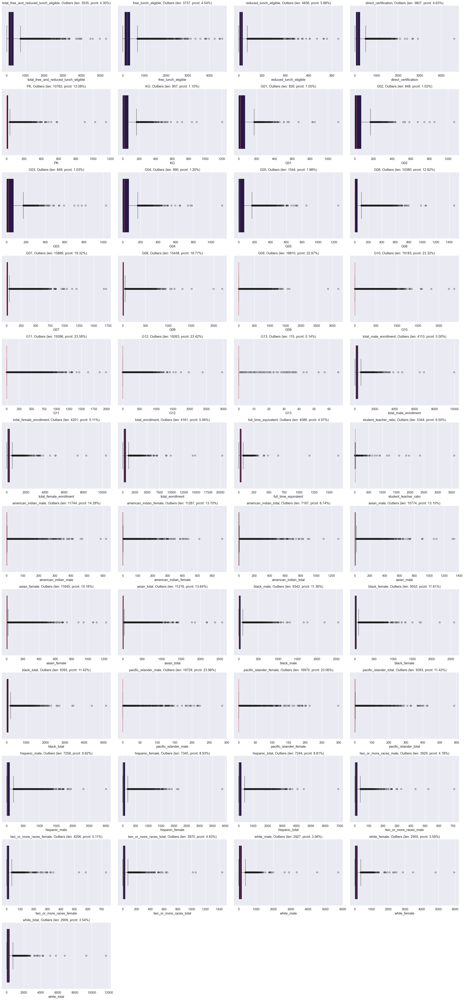

In [123]:
#find the outliers of all numerical data

#interquartile range
def calculateOutliersPercentage(column):
    Q1 = df_imputed[column].quantile(0.25)
    Q3 = df_imputed[column].quantile(0.75)

    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    outliers = df_imputed[(df_imputed[column] < lower_bound) | (df_imputed[column] > upper_bound)]
    return f'(len: {len(outliers)}, prcnt: {((len(outliers) / len(df_imputed)) * 100):.2f}%)'

numerical_columns = [
'total_free_and_reduced_lunch_eligible', 'free_lunch_eligible',
       'reduced_lunch_eligible', 'direct_certification', 'PK', 'KG', 'G01',
       'G02', 'G03', 'G04', 'G05', 'G06', 'G07', 'G08', 'G09', 'G10', 'G11',
       'G12', 'G13', 'total_male_enrollment', 'total_female_enrollment',
       'total_enrollment', 'full_time_equivalent', 'student_teacher_ratio',
       'american_indian_male', 'american_indian_female',
       'american_indian_total', 'asian_male', 'asian_female', 'asian_total',
       'black_male', 'black_female', 'black_total', 'pacific_islander_male',
       'pacific_islander_female', 'pacific_islander_total', 'hispanic_male',
       'hispanic_female', 'hispanic_total', 'tribal_male',
       'tribal_female', 'tribal_total', 'white_male',
       'white_female', 'white_total']

num_columns = len(numerical_columns)
rows = (num_columns + 3) // 4  
fig, axes = plt.subplots(rows, 4, figsize=(28, 5 * rows))

axes = axes.flatten()

for i, column in enumerate(numerical_columns):
    ax = axes[i]  
    sns.boxplot(x=df_imputed[column], 
                color=sns.color_palette("magma")[0], 
                medianprops=dict(color='#f1605d'),  
                ax=ax)  
    ax.set_title(f'{column}, Outliers {calculateOutliersPercentage(column)}')

for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout()  
plt.show()

#### Handling Ouliers (Dropping and Transformations)

##### Log Transfomation

C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\2705945108.py:21: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



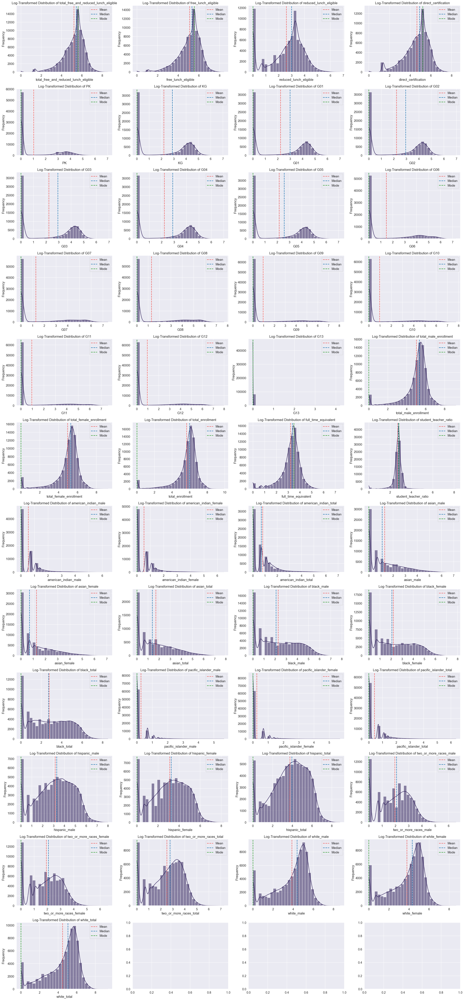

In [124]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Get all numerical columns from the cleaned DataFrame
numerical_columns = [
'total_free_and_reduced_lunch_eligible', 'free_lunch_eligible',
       'reduced_lunch_eligible', 'direct_certification', 'PK', 'KG', 'G01',
       'G02', 'G03', 'G04', 'G05', 'G06', 'G07', 'G08', 'G09', 'G10', 'G11',
       'G12', 'G13', 'total_male_enrollment', 'total_female_enrollment',
       'total_enrollment', 'full_time_equivalent', 'student_teacher_ratio',
       'american_indian_male', 'american_indian_female',
       'american_indian_total', 'asian_male', 'asian_female', 'asian_total',
       'black_male', 'black_female', 'black_total', 'pacific_islander_male',
       'pacific_islander_female', 'pacific_islander_total', 'hispanic_male',
       'hispanic_female', 'hispanic_total', 'tribal_male',
       'tribal_female', 'tribal_total', 'white_male',
       'white_female', 'white_total']

# Apply log transformation to handle zeros and negatives safely
df_imputed_log = df_imputed[numerical_columns].applymap(lambda x: np.log1p(x))  # log1p(x) = log(1 + x)

num_columns = len(numerical_columns)
rows = (num_columns + 3) // 4  
fig, axes = plt.subplots(rows, 4, figsize=(28, 5 * rows))

# Flatten axes if there is only one row
axes = axes.flatten() if rows == 1 else axes

# Plot the data distribution showing the mean, median, and mode
for i, column in enumerate(numerical_columns):
    ax = axes[i // 4, i % 4] if rows > 1 else axes[i]  # Handle both 1D and 2D indexing
    
    # Plot transformed data
    sns.histplot(df_imputed_log[column], bins=30, kde=True, color=sns.color_palette("magma")[0], ax=ax)
    ax.set_title(f'Log-Transformed Distribution of {column}')
    ax.set_xlabel(column)
    ax.set_ylabel('Frequency')

    mean_value = df_imputed_log[column].mean()
    median_value = df_imputed_log[column].median()
    mode_value = df_imputed_log[column].mode()[0]

    ax.axvline(mean_value, color='#f1605d', linestyle='--', linewidth=2, label='Mean') 
    ax.axvline(median_value, color='#1f77b4', linestyle='--', linewidth=2, label='Median') 
    ax.axvline(mode_value, color='#2ca02c', linestyle='--', linewidth=2, label='Mode') 

    ax.legend()

# Adjust layout to prevent overlap
plt.tight_layout() 
plt.show()


In [125]:
log_df = df_imputed.copy()
columns_to_transform = ['total_free_and_reduced_lunch_eligible', 'free_lunch_eligible',
       'reduced_lunch_eligible', 'direct_certification', 'PK', 'KG', 'G01',
       'G02', 'G03', 'G04', 'G05', 'G06', 'G07', 'G08', 'G09', 'G10', 'G11',
       'G12', 'G13', 'total_male_enrollment', 'total_female_enrollment',
       'total_enrollment', 'full_time_equivalent', 'student_teacher_ratio',
       'american_indian_male', 'american_indian_female',
       'american_indian_total', 'asian_male', 'asian_female', 'asian_total',
       'black_male', 'black_female', 'black_total', 'pacific_islander_male',
       'pacific_islander_female', 'pacific_islander_total', 'hispanic_male',
       'hispanic_female', 'hispanic_total', 'tribal_male',
       'tribal_female', 'tribal_total', 'white_male',
       'white_female', 'white_total']

for column in columns_to_transform:
    log_df[column] = np.log1p(log_df[column])

##### Box-Cox Transformation

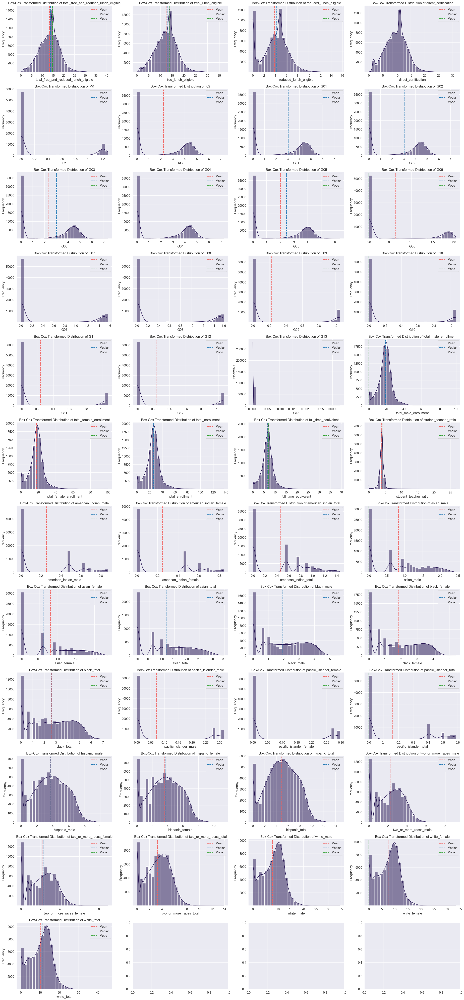

In [126]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import boxcox

# Get all numerical columns from the cleaned DataFrame
numerical_columns = ['total_free_and_reduced_lunch_eligible', 'free_lunch_eligible',
       'reduced_lunch_eligible', 'direct_certification', 'PK', 'KG', 'G01',
       'G02', 'G03', 'G04', 'G05', 'G06', 'G07', 'G08', 'G09', 'G10', 'G11',
       'G12', 'G13', 'total_male_enrollment', 'total_female_enrollment',
       'total_enrollment', 'full_time_equivalent', 'student_teacher_ratio',
       'american_indian_male', 'american_indian_female',
       'american_indian_total', 'asian_male', 'asian_female', 'asian_total',
       'black_male', 'black_female', 'black_total', 'pacific_islander_male',
       'pacific_islander_female', 'pacific_islander_total', 'hispanic_male',
       'hispanic_female', 'hispanic_total', 'tribal_male',
       'tribal_female', 'tribal_total', 'white_male',
       'white_female', 'white_total']

# Apply Box-Cox transformation to handle skewness
# Ensure that all values are positive (Box-Cox only works for positive values)
df_imputed_boxcox = df_imputed[numerical_columns].copy()

for column in numerical_columns:
    # Shift data if necessary to make all values positive
    min_value = df_imputed_boxcox[column].min()
    if min_value <= 0:
        df_imputed_boxcox[column] += (1 - min_value)
    
    # Apply Box-Cox transformation
    df_imputed_boxcox[column], _ = boxcox(df_imputed_boxcox[column])

num_columns = len(numerical_columns)
rows = (num_columns + 3) // 4  
fig, axes = plt.subplots(rows, 4, figsize=(28, 5 * rows))

# Flatten axes if there is only one row
axes = axes.flatten() if rows == 1 else axes

# Plot the data distribution showing the mean, median, and mode
for i, column in enumerate(numerical_columns):
    ax = axes[i // 4, i % 4] if rows > 1 else axes[i]  # Handle both 1D and 2D indexing
    
    # Plot transformed data
    sns.histplot(df_imputed_boxcox[column], bins=30, kde=True, color=sns.color_palette("magma")[0], ax=ax)
    ax.set_title(f'Box-Cox Transformed Distribution of {column}')
    ax.set_xlabel(column)
    ax.set_ylabel('Frequency')

    mean_value = df_imputed_boxcox[column].mean()
    median_value = df_imputed_boxcox[column].median()
    mode_value = df_imputed_boxcox[column].mode()[0]

    ax.axvline(mean_value, color='#f1605d', linestyle='--', linewidth=2, label='Mean') 
    ax.axvline(median_value, color='#1f77b4', linestyle='--', linewidth=2, label='Median') 
    ax.axvline(mode_value, color='#2ca02c', linestyle='--', linewidth=2, label='Mode') 

    ax.legend()

# Adjust layout to prevent overlap
plt.tight_layout() 
plt.show()


In [127]:
from scipy.stats import boxcox

# Copy the DataFrame
boxcox_df = df_imputed.copy()

# Columns to transform
columns_to_transform = ['PK', 'KG', 'G01', 'G02', 'G03', 'G04', 'G05', 'G06', 'G07', 'G08', 'G09', 'G10', 'G11',
                        'G12', 'G13', 'total_male_enrollment', 'total_female_enrollment', 'total_enrollment',
                        'full_time_equivalent', 'student_teacher_ratio', 'american_indian_male', 'american_indian_female',
                        'american_indian_total', 'asian_male', 'asian_female', 'asian_total', 'black_male', 'black_female',
                        'black_total', 'pacific_islander_male', 'pacific_islander_female', 'pacific_islander_total',
                        'hispanic_male', 'hispanic_female', 'hispanic_total', 'tribal_male',
                        'tribal_female', 'tribal_total', 'white_male', 'white_female', 'white_total']

# Apply Box-Cox transformation to each column
for column in columns_to_transform:
    # Check for any zero or negative values and handle them by shifting if necessary
    if (boxcox_df[column] <= 0).any():
        boxcox_df[column] = boxcox_df[column] - boxcox_df[column].min() + 1
    
    # Apply Box-Cox transformation and store the lambda value for each column (optional)
    boxcox_df[column], lambda_value = boxcox(boxcox_df[column])
    print(f"Box-Cox transformation applied to {column} with lambda: {lambda_value}")


Box-Cox transformation applied to PK with lambda: -0.7802277531102225
Box-Cox transformation applied to KG with lambda: 0.006938982984860871
Box-Cox transformation applied to G01 with lambda: 0.018913423014376027
Box-Cox transformation applied to G02 with lambda: 0.019747988862615997
Box-Cox transformation applied to G03 with lambda: 0.017174514572082453
Box-Cox transformation applied to G04 with lambda: 0.009088396527843734
Box-Cox transformation applied to G05 with lambda: -0.0323795152827183
Box-Cox transformation applied to G06 with lambda: -0.4730235531687592
Box-Cox transformation applied to G07 with lambda: -0.625369013298255
Box-Cox transformation applied to G08 with lambda: -0.6183294486407486
Box-Cox transformation applied to G09 with lambda: -0.9457575036097803
Box-Cox transformation applied to G10 with lambda: -0.9326870635409514
Box-Cox transformation applied to G11 with lambda: -0.9312415373240627
Box-Cox transformation applied to G12 with lambda: -0.9341695008766088
Box-

##### Dropping

In [128]:
dropped_outliers_df = df_imputed.copy()

def drop_outliers(df, columns):
    for column in columns:
        Q1 = df[column].quantile(0.25) 
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1 
        
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    
    return df

columns_to_check = ['total_free_and_reduced_lunch_eligible', 'free_lunch_eligible',
       'reduced_lunch_eligible', 'direct_certification', 'PK', 'KG', 'G01',
       'G02', 'G03', 'G04', 'G05', 'G06', 'G07', 'G08', 'G09', 'G10', 'G11',
       'G12', 'G13', 'total_male_enrollment', 'total_female_enrollment',
       'total_enrollment', 'full_time_equivalent', 'student_teacher_ratio',
       'american_indian_male', 'american_indian_female',
       'american_indian_total', 'asian_male', 'asian_female', 'asian_total',
       'black_male', 'black_female', 'black_total', 'pacific_islander_male',
       'pacific_islander_female', 'pacific_islander_total', 'hispanic_male',
       'hispanic_female', 'hispanic_total', 'tribal_male',
       'tribal_female', 'tribal_total', 'white_male',
       'white_female', 'white_total']

dropped_outliers_df = drop_outliers(dropped_outliers_df, columns_to_check)

print("Shape of cleaned DataFrame:", dropped_outliers_df.shape)

Shape of cleaned DataFrame: (5943, 60)


# Data Visualizations

##### Correlation Matrix Between All Features

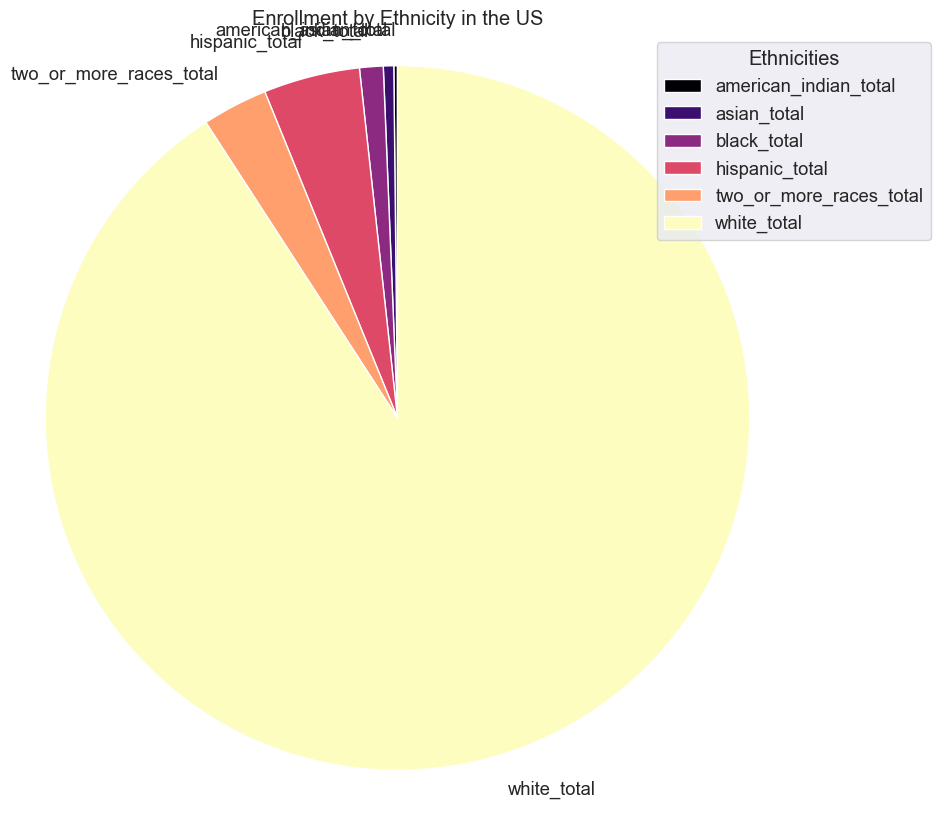

In [158]:
# Generate a list of colors from the magma colormap
colors = plt.get_cmap('magma')(np.linspace(0, 1, 6))  # 6 colors for 6 ethnicities

# Create the pie chart
sizes = dropped_outliers_df[['american_indian_total', 'asian_total', 'black_total', 'hispanic_total', 
    'tribal_total', 'white_total']].sum()
labels = sizes.index  # Use the index for labels

# Plot the pie chart with percentages instead of names
sizes.plot(kind='pie', figsize=(10, 10), colors=colors, startangle=90, autopct=None, label=None)  # Show percentages
plt.title("Enrollment by Ethnicity in the US")
plt.ylabel("")  # Remove the y-label
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

# Add a legend
plt.legend(labels, title="Ethnicities", loc="upper right", bbox_to_anchor=(1.2, 1))

plt.show()


### It is shown that the majority of enrolled students in the United States are white and the ultimate minority are american indians. 

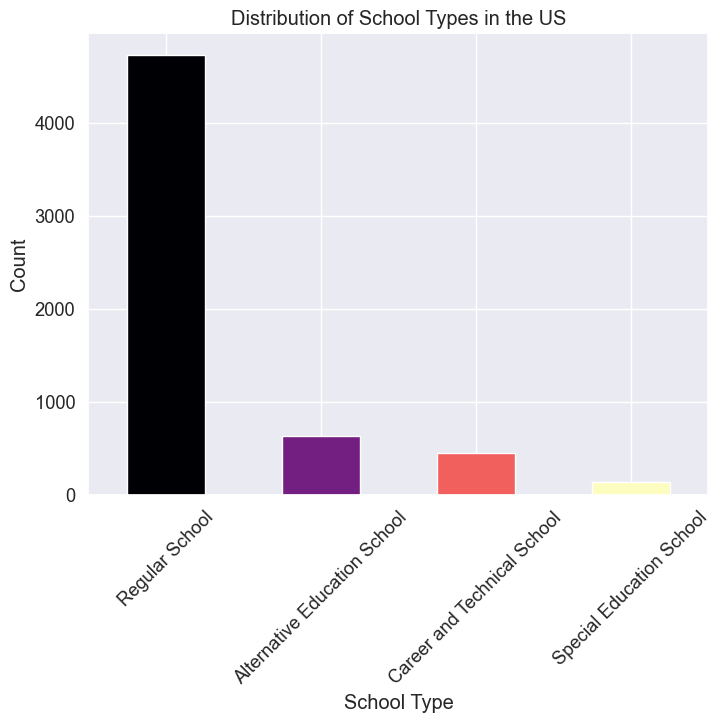

In [146]:
# Generate colors from the magma colormap
colors = plt.get_cmap('magma')(np.linspace(0, 1, dropped_outliers_df['school_type'].nunique()))  # Number of unique school types

# Create the bar chart
dropped_outliers_df['school_type'].value_counts().plot(kind='bar', figsize=(8, 6), color=colors)  # Set color map to magma
plt.title("Distribution of School Types in the US")
plt.xlabel("School Type")
plt.ylabel("Count")
plt.xticks(rotation=45)  # Rotate x-tick labels for better readability
plt.show()

### This indicates that most schools in the US are regular schools with signigicantly higher frequency than other types of schools.

##### This indicates class imbalance that might affect performance and classification for the minority classes

C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\1234914314.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




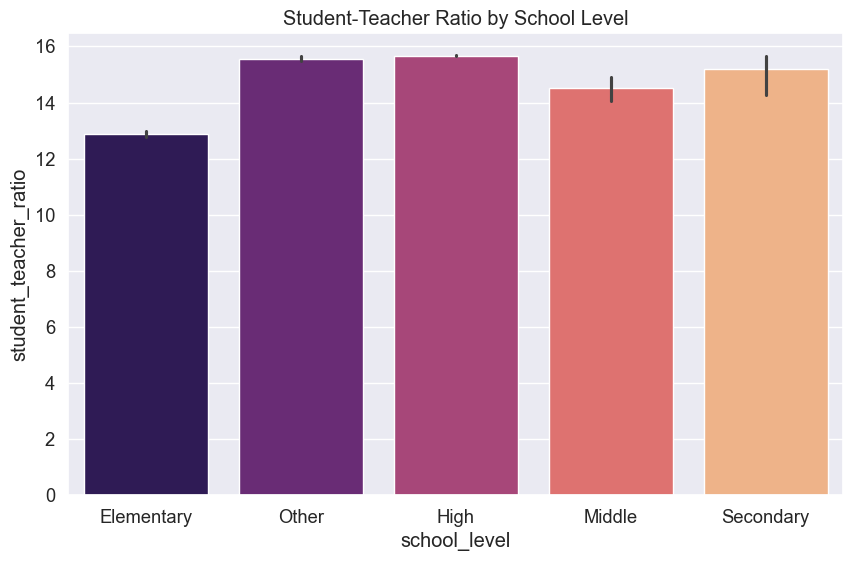

In [144]:
plt.figure(figsize=(10, 6))
# Create the bar plot with magma colormap
sns.barplot(x='school_level', y='student_teacher_ratio', data=dropped_outliers_df, palette='magma')
plt.title("Student-Teacher Ratio by School Level")
plt.show()

### Student Teacher ratios are relatively close in all school levels ranging between about 13 to 15 students for every teacher

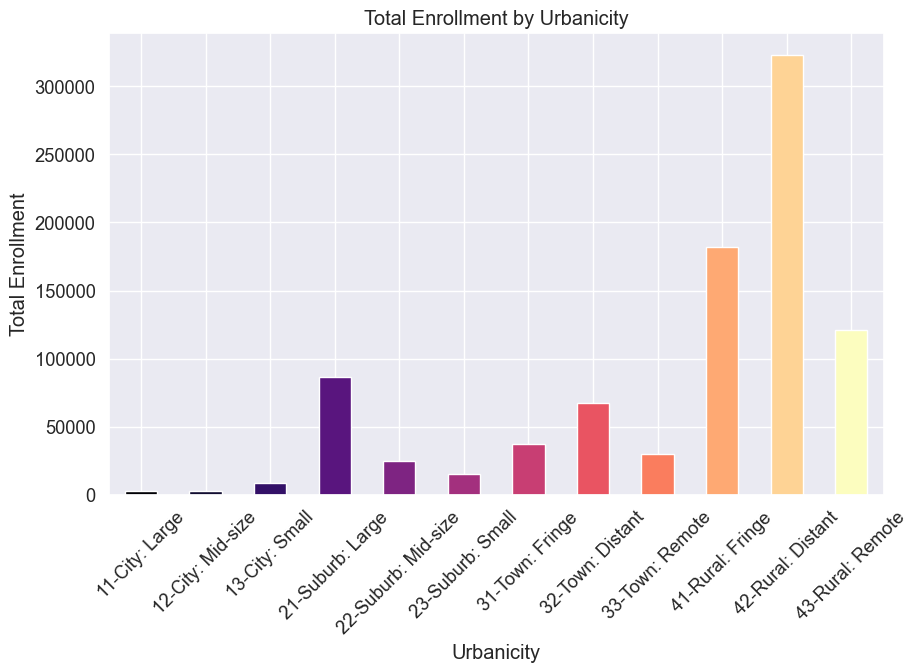

In [164]:
# Group the data by 'urban_centric_locale_code' and sum the 'total_enrollment'
enrollment_data = dropped_outliers_df.groupby('urban_centric_locale_code')['total_enrollment'].sum()

# Generate colors from the magma colormap
colors = plt.get_cmap('magma')(np.linspace(0, 1, len(enrollment_data)))  # Generate colors based on the number of categories

# Create a bar plot with the magma colormap
plt.figure(figsize=(10, 6))
enrollment_data.plot(kind='bar', color=colors)  # Apply the colors
plt.title("Total Enrollment by Urbanicity")
plt.ylabel("Total Enrollment")
plt.xlabel("Urbanicity")
plt.xticks(rotation=45)  # Rotate x-tick labels for better readability
plt.show()

#### Data shows that most students in public schools in the US come from rural areas

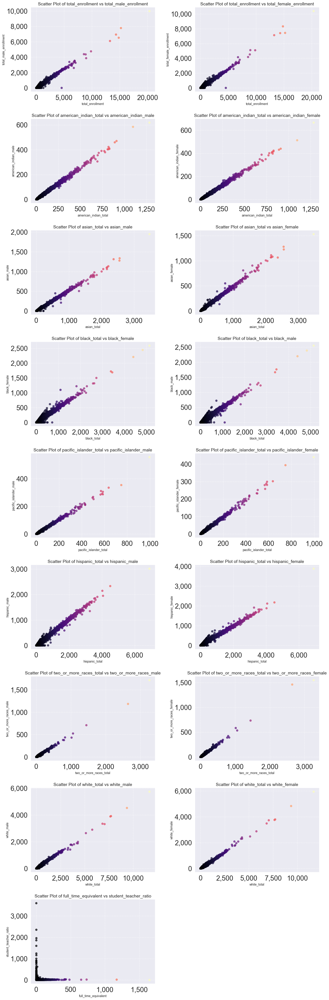

In [ ]:
sns.set(font_scale=2.0)

# Visualizing the relationships between features
feature_pairs = [
    ('total_enrollment', 'total_male_enrollment'),
    ('total_enrollment', 'total_female_enrollment'),
    ('american_indian_total', 'american_indian_male'),
    ('american_indian_total', 'american_indian_female'),
    ('asian_total', 'asian_male'),
    ('asian_total', 'asian_female'),
    ('black_total', 'black_female'),
    ('black_total', 'black_male'),
    ('pacific_islander_total', 'pacific_islander_male'),
    ('pacific_islander_total', 'pacific_islander_female'),
    ('hispanic_total', 'hispanic_male'),
    ('hispanic_total', 'hispanic_female'),
    ('tribal_total', 'tribal_male'),
    ('tribal_total', 'tribal_female'),
    ('white_total', 'white_male'),
    ('white_total', 'white_female'),
    ('full_time_equivalent', 'student_teacher_ratio')
]

# Set up the subplot grid
n_pairs = len(feature_pairs)
n_cols = 2  # Define the number of columns for subplots
n_rows = (n_pairs + n_cols - 1) // n_cols  # Automatically adjust rows based on the number of pairs

# Increase the figure size for better visibility
fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 5))  # Adjusted figure size

# Flatten axs to easily iterate if it's a multi-row subplot
axs = axs.flatten()

for i, (feature1, feature2) in enumerate(feature_pairs):
    scatter = axs[i].scatter(df[feature1], df[feature2], alpha=0.7, c=df[feature1], cmap='magma')
    axs[i].set_title(f'Scatter Plot of {feature1} vs {feature2}', fontsize=14)
    axs[i].set_xlabel(feature1, fontsize=10)
    axs[i].set_ylabel(feature2, fontsize=10)
    axs[i].grid(True, linestyle='--', alpha=0.7)
    
    # Format axis numbers using scientific notation with fewer digits
    axs[i].ticklabel_format(style='sci', scilimits=(-3,3), axis='both')
    axs[i].yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: format(int(x), ',')))
    axs[i].xaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: format(int(x), ',')))

# Hide any empty subplots if the number of plots is odd
for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

plt.tight_layout()
plt.show()

##### According to the data there is a linear relationship between total student number of any ethnicity and the male/female number. Linear regression could be used to impute the missing data.

# Encoding

In [227]:
# List of columns to convert to integer
columns_to_convert = ['PK', 'KG', 'G01',
       'G02', 'G03', 'G04', 'G05', 'G06', 'G07', 'G08', 'G09', 'G10', 'G11',
       'G12', 'G13', 'total_male_enrollment', 'total_female_enrollment',
       'total_enrollment','american_indian_male', 'american_indian_female',
       'american_indian_total', 'asian_male', 'asian_female', 'asian_total',
       'black_male', 'black_female', 'black_total', 'pacific_islander_male',
       'pacific_islander_female', 'pacific_islander_total', 'hispanic_male',
       'hispanic_female', 'hispanic_total', 'tribal_male',
       'tribal_female', 'tribal_total', 'white_male',
       'white_female', 'white_total']  

# Convert specified columns to integer
for column in columns_to_convert:
    df_imputed[column] = df_imputed[column].astype(int)



In [228]:
df_encoded = df_imputed.copy()
log_df_encoded = log_df.copy()
boxcox_df_encoded = boxcox_df.copy()
dropped_outliers_df_encoded = dropped_outliers_df.copy()


In [229]:
allLabel_df_encoded = df_imputed.copy()
allLabel_log_df_encoded = log_df.copy()
allLabel_boxcox_df_encoded = boxcox_df.copy()
allLabel_dropped_outliers_df_encoded = dropped_outliers_df.copy()

In [230]:
print(f'Original: {df_encoded.shape}')
print(f'Log Transformation: {log_df_encoded.shape}')
print(f'Box-Cox Transformation: {boxcox_df_encoded.shape}')
print(f'Dropped Outliers: {dropped_outliers_df_encoded.shape}')

Original: (82256, 60)
Log Transformation: (82256, 60)
Box-Cox Transformation: (82256, 60)
Dropped Outliers: (5943, 60)


In [231]:
print(f'Original: {df_encoded.shape}')
print(f'Log Transformation: {log_df_encoded.shape}')
print(f'Box-Cox Transformation: {boxcox_df_encoded.shape}')
print(f'Dropped Outliers: {dropped_outliers_df_encoded.shape}')

Original: (82256, 60)
Log Transformation: (82256, 60)
Box-Cox Transformation: (82256, 60)
Dropped Outliers: (5943, 60)


##### Label Encoding

In [232]:
from sklearn.preprocessing import LabelEncoder

# Initialize the LabelEncoder
label_encoder = LabelEncoder()

# Fit and transform the 'school_type' column
df_encoded['school_type_encoded'] = label_encoder.fit_transform(df_encoded['school_type'])

# Display the unique values and their corresponding encoded labels
label_mapping = dict(zip(label_encoder.classes_, range(len(label_encoder.classes_))))
print("Label Encoding Mapping Original:")
print(label_mapping)

#----------------------------------------------------------------------------------------------------
label_encoder = LabelEncoder()

# Fit and transform the 'school_type' column
log_df_encoded['school_type_encoded'] = label_encoder.fit_transform(log_df_encoded['school_type'])

# Display the unique values and their corresponding encoded labels
label_mapping = dict(zip(label_encoder.classes_, range(len(label_encoder.classes_))))
print("Label Encoding Mapping Log Transformation:")
print(label_mapping)

#------------------------------------------------------------------------------------------------------
label_encoder = LabelEncoder()

# Fit and transform the 'school_type' column
boxcox_df_encoded['school_type_encoded'] = label_encoder.fit_transform(boxcox_df_encoded['school_type'])

# Display the unique values and their corresponding encoded labels
label_mapping = dict(zip(label_encoder.classes_, range(len(label_encoder.classes_))))
print("Label Encoding Mapping Box-Cox Transformation:")
print(label_mapping)

#--------------------------------------------------------------------------------------------------------
label_encoder = LabelEncoder()

# Fit and transform the 'school_type' column
dropped_outliers_df_encoded['school_type_encoded'] = label_encoder.fit_transform(dropped_outliers_df_encoded['school_type'])

# Display the unique values and their corresponding encoded labels
label_mapping = dict(zip(label_encoder.classes_, range(len(label_encoder.classes_))))
print("Label Encoding Mapping Dropped Outliers:")
print(label_mapping)



Label Encoding Mapping Original:
{'Alternative Education School': 0, 'Career and Technical School': 1, 'Regular School': 2, 'Special Education School': 3}
Label Encoding Mapping Log Transformation:
{'Alternative Education School': 0, 'Career and Technical School': 1, 'Regular School': 2, 'Special Education School': 3}
Label Encoding Mapping Box-Cox Transformation:
{'Alternative Education School': 0, 'Career and Technical School': 1, 'Regular School': 2, 'Special Education School': 3}
Label Encoding Mapping Dropped Outliers:
{'Alternative Education School': 0, 'Career and Technical School': 1, 'Regular School': 2, 'Special Education School': 3}


In [233]:
df_encoded.drop(columns='school_type', inplace = True)
log_df_encoded.drop(columns='school_type', inplace = True)
boxcox_df_encoded.drop(columns='school_type', inplace = True)
dropped_outliers_df_encoded.drop(columns='school_type', inplace = True)

In [234]:
print(f'Original: {df_encoded.shape}')
print(f'Log Transformation: {log_df_encoded.shape}')
print(f'Box-Cox Transformation: {boxcox_df_encoded.shape}')
print(f'Dropped Outliers: {dropped_outliers_df_encoded.shape}')

Original: (82256, 60)
Log Transformation: (82256, 60)
Box-Cox Transformation: (82256, 60)
Dropped Outliers: (5943, 60)


In [235]:
from sklearn.preprocessing import LabelEncoder

# Initialize the LabelEncoder
label_encoder = LabelEncoder()

# Fit and transform the 'school_type' column
allLabel_df_encoded['school_type_encoded'] = label_encoder.fit_transform(allLabel_df_encoded['school_type'])

# Display the unique values and their corresponding encoded labels
label_mapping = dict(zip(label_encoder.classes_, range(len(label_encoder.classes_))))
print("Label Encoding Mapping Original:")
print(label_mapping)

#----------------------------------------------------------------------------------------------------
label_encoder = LabelEncoder()

# Fit and transform the 'school_type' column
allLabel_log_df_encoded['school_type_encoded'] = label_encoder.fit_transform(allLabel_log_df_encoded['school_type'])

# Display the unique values and their corresponding encoded labels
label_mapping = dict(zip(label_encoder.classes_, range(len(label_encoder.classes_))))
print("Label Encoding Mapping Log Transformation:")
print(label_mapping)

#------------------------------------------------------------------------------------------------------
label_encoder = LabelEncoder()

# Fit and transform the 'school_type' column
allLabel_boxcox_df_encoded['school_type_encoded'] = label_encoder.fit_transform(allLabel_boxcox_df_encoded['school_type'])

# Display the unique values and their corresponding encoded labels
label_mapping = dict(zip(label_encoder.classes_, range(len(label_encoder.classes_))))
print("Label Encoding Mapping Box-Cox Transformation:")
print(label_mapping)

#--------------------------------------------------------------------------------------------------------
label_encoder = LabelEncoder()

# Fit and transform the 'school_type' column
allLabel_dropped_outliers_df_encoded['school_type_encoded'] = label_encoder.fit_transform(allLabel_dropped_outliers_df_encoded['school_type'])

# Display the unique values and their corresponding encoded labels
label_mapping = dict(zip(label_encoder.classes_, range(len(label_encoder.classes_))))
print("Label Encoding Mapping Dropped Outliers:")
print(label_mapping)



Label Encoding Mapping Original:
{'Alternative Education School': 0, 'Career and Technical School': 1, 'Regular School': 2, 'Special Education School': 3}
Label Encoding Mapping Log Transformation:
{'Alternative Education School': 0, 'Career and Technical School': 1, 'Regular School': 2, 'Special Education School': 3}
Label Encoding Mapping Box-Cox Transformation:
{'Alternative Education School': 0, 'Career and Technical School': 1, 'Regular School': 2, 'Special Education School': 3}
Label Encoding Mapping Dropped Outliers:
{'Alternative Education School': 0, 'Career and Technical School': 1, 'Regular School': 2, 'Special Education School': 3}


In [236]:
allLabel_df_encoded.drop(columns='school_type', inplace = True)
allLabel_log_df_encoded.drop(columns='school_type', inplace = True)
allLabel_boxcox_df_encoded.drop(columns='school_type', inplace = True)
allLabel_dropped_outliers_df_encoded.drop(columns='school_type', inplace = True)

In [237]:
print(f'Original: {allLabel_df_encoded.shape}')
print(f'Log Transformation: {allLabel_log_df_encoded.shape}')
print(f'Box-Cox Transformation: {allLabel_boxcox_df_encoded.shape}')
print(f'Dropped Outliers: {allLabel_dropped_outliers_df_encoded.shape}')

Original: (82256, 60)
Log Transformation: (82256, 60)
Box-Cox Transformation: (82256, 60)
Dropped Outliers: (5943, 60)


##### Binary Encoding

In [238]:
# Binary encoding for 'is_charter' column
df_encoded['is_charter_encoded'] = df_encoded['is_charter'].apply(lambda x: 1 if x == 'Yes' else 0)
log_df_encoded['is_charter_encoded'] = log_df_encoded['is_charter'].apply(lambda x: 1 if x == 'Yes' else 0)
boxcox_df_encoded['is_charter_encoded'] = boxcox_df_encoded['is_charter'].apply(lambda x: 1 if x == 'Yes' else 0)
dropped_outliers_df_encoded['is_charter_encoded'] = dropped_outliers_df_encoded['is_charter'].apply(lambda x: 1 if x == 'Yes' else 0)

In [239]:
# Binary encoding for 'is_charter' column
allLabel_df_encoded['is_charter_encoded'] = allLabel_df_encoded['is_charter'].apply(lambda x: 1 if x == 'Yes' else 0)
allLabel_log_df_encoded['is_charter_encoded'] = allLabel_log_df_encoded['is_charter'].apply(lambda x: 1 if x == 'Yes' else 0)
allLabel_boxcox_df_encoded['is_charter_encoded'] = allLabel_boxcox_df_encoded['is_charter'].apply(lambda x: 1 if x == 'Yes' else 0)
allLabel_dropped_outliers_df_encoded['is_charter_encoded'] = allLabel_dropped_outliers_df_encoded['is_charter'].apply(lambda x: 1 if x == 'Yes' else 0)

In [240]:
df_encoded.drop(columns='is_charter', inplace = True)
log_df_encoded.drop(columns='is_charter', inplace = True)
boxcox_df_encoded.drop(columns='is_charter', inplace = True)
dropped_outliers_df_encoded.drop(columns='is_charter', inplace = True)

In [241]:
allLabel_df_encoded.drop(columns='is_charter', inplace = True)
allLabel_log_df_encoded.drop(columns='is_charter', inplace = True)
allLabel_boxcox_df_encoded.drop(columns='is_charter', inplace = True)
allLabel_dropped_outliers_df_encoded.drop(columns='is_charter', inplace = True)

In [242]:
print(f'Original: {df_encoded.shape}')
print(f'Log Transformation: {log_df_encoded.shape}')
print(f'Box-Cox Transformation: {boxcox_df_encoded.shape}')
print(f'Dropped Outliers: {dropped_outliers_df_encoded.shape}')

Original: (82256, 60)
Log Transformation: (82256, 60)
Box-Cox Transformation: (82256, 60)
Dropped Outliers: (5943, 60)


In [243]:
print(f'Original: {allLabel_df_encoded.shape}')
print(f'Log Transformation: {allLabel_log_df_encoded.shape}')
print(f'Box-Cox Transformation: {allLabel_boxcox_df_encoded.shape}')
print(f'Dropped Outliers: {allLabel_dropped_outliers_df_encoded.shape}')

Original: (82256, 60)
Log Transformation: (82256, 60)
Box-Cox Transformation: (82256, 60)
Dropped Outliers: (5943, 60)


##### One Hot Encoding

In [244]:

columns_to_encode = [
    'is_virtual', 
    'lowest_grade_in_school', 
    'highest_grade_in_school', 
    'school_level', 
    'urban_centric_locale_code'
]

# Apply one-hot encoding
df_encoded = pd.get_dummies(df_encoded, columns=columns_to_encode, prefix=columns_to_encode)

log_df_encoded = pd.get_dummies(log_df_encoded, columns=columns_to_encode, prefix=columns_to_encode)

boxcox_df_encoded = pd.get_dummies(boxcox_df_encoded, columns=columns_to_encode, prefix=columns_to_encode)

dropped_outliers_df_encoded = pd.get_dummies(dropped_outliers_df_encoded, columns=columns_to_encode, prefix=columns_to_encode)



In [245]:

columns_to_encode = [
    'is_virtual', 
    'lowest_grade_in_school', 
    'highest_grade_in_school', 
    'school_level', 
    'urban_centric_locale_code'
]

# Apply one-hot encoding
allLabel_df_encoded = pd.get_dummies(allLabel_df_encoded, columns=columns_to_encode, prefix=columns_to_encode)

allLabel_log_df_encoded = pd.get_dummies(allLabel_log_df_encoded, columns=columns_to_encode, prefix=columns_to_encode)

allLabel_boxcox_df_encoded = pd.get_dummies(allLabel_boxcox_df_encoded, columns=columns_to_encode, prefix=columns_to_encode)

allLabel_dropped_outliers_df_encoded = pd.get_dummies(allLabel_dropped_outliers_df_encoded, columns=columns_to_encode, prefix=columns_to_encode)



In [246]:
print(f'Original: {df_encoded.shape}')
print(f'Log Transformation: {log_df_encoded.shape}')
print(f'Box-Cox Transformation: {boxcox_df_encoded.shape}')
print(f'Dropped Outliers: {dropped_outliers_df_encoded.shape}')

Original: (82256, 105)
Log Transformation: (82256, 105)
Box-Cox Transformation: (82256, 105)
Dropped Outliers: (5943, 104)


In [247]:
print(f'Original: {allLabel_df_encoded.shape}')
print(f'Log Transformation: {allLabel_log_df_encoded.shape}')
print(f'Box-Cox Transformation: {allLabel_boxcox_df_encoded.shape}')
print(f'Dropped Outliers: {allLabel_dropped_outliers_df_encoded.shape}')

Original: (82256, 105)
Log Transformation: (82256, 105)
Box-Cox Transformation: (82256, 105)
Dropped Outliers: (5943, 104)


##### Target Encoding

In [108]:
#%pip install category_encoders

In [248]:
#Using label encoder and target encoding on the same features to compare between the performance
from sklearn.preprocessing import LabelEncoder

features_to_encode = [
    'state', 
    'district_id', 
    'state_district_id', 
    'city', 
    'zipcode', 
    'extended_zipcode', 
    'county_name'
]

label_encoder = LabelEncoder()


label_mappings = {}

for feature in features_to_encode:
    # Fit and transform the feature
    allLabel_df_encoded[f'{feature}_encoded'] = label_encoder.fit_transform(allLabel_df_encoded[feature])
    
    # Store the label mapping
    label_mapping = dict(zip(label_encoder.classes_, range(len(label_encoder.classes_))))
    label_mappings[feature] = label_mapping

    # Display the unique values and their corresponding encoded labels
    print(f"Label Encoding Mapping for {feature}:")
    print(label_mapping)

#----------------------------------------------------------------------------------------------------
label_encoder = LabelEncoder()


label_mappings = {}

for feature in features_to_encode:
    # Fit and transform the feature
    allLabel_log_df_encoded[f'{feature}_encoded'] = label_encoder.fit_transform(allLabel_log_df_encoded[feature])
    
    # Store the label mapping
    label_mapping = dict(zip(label_encoder.classes_, range(len(label_encoder.classes_))))
    label_mappings[feature] = label_mapping

    # Display the unique values and their corresponding encoded labels
    print(f"Label Encoding Mapping for {feature}:")
    print(label_mapping)

#------------------------------------------------------------------------------------------------------
label_encoder = LabelEncoder()

label_mappings = {}

for feature in features_to_encode:
    # Fit and transform the feature
    allLabel_boxcox_df_encoded[f'{feature}_encoded'] = label_encoder.fit_transform(allLabel_boxcox_df_encoded[feature])
    
    # Store the label mapping
    label_mapping = dict(zip(label_encoder.classes_, range(len(label_encoder.classes_))))
    label_mappings[feature] = label_mapping

    # Display the unique values and their corresponding encoded labels
    print(f"Label Encoding Mapping for {feature}:")
    print(label_mapping)

#--------------------------------------------------------------------------------------------------------
label_encoder = LabelEncoder()


label_mappings = {}

for feature in features_to_encode:
    # Fit and transform the feature
    allLabel_dropped_outliers_df_encoded[f'{feature}_encoded'] = label_encoder.fit_transform(allLabel_dropped_outliers_df_encoded[feature])
    
    # Store the label mapping
    label_mapping = dict(zip(label_encoder.classes_, range(len(label_encoder.classes_))))
    label_mappings[feature] = label_mapping

    # Display the unique values and their corresponding encoded labels
    print(f"Label Encoding Mapping for {feature}:")
    print(label_mapping)


Label Encoding Mapping for state:
{'AK': 0, 'AL': 1, 'AR': 2, 'AZ': 3, 'CA': 4, 'CO': 5, 'CT': 6, 'DC': 7, 'DE': 8, 'FL': 9, 'GA': 10, 'HI': 11, 'IA': 12, 'ID': 13, 'IL': 14, 'IN': 15, 'KS': 16, 'KY': 17, 'LA': 18, 'MA': 19, 'MD': 20, 'ME': 21, 'MI': 22, 'MN': 23, 'MO': 24, 'MP': 25, 'MS': 26, 'MT': 27, 'NC': 28, 'ND': 29, 'NE': 30, 'NH': 31, 'NJ': 32, 'NM': 33, 'NV': 34, 'NY': 35, 'OH': 36, 'OK': 37, 'OR': 38, 'PA': 39, 'PR': 40, 'RI': 41, 'SC': 42, 'SD': 43, 'TN': 44, 'TX': 45, 'UT': 46, 'VA': 47, 'VI': 48, 'VT': 49, 'WA': 50, 'WI': 51, 'WV': 52, 'WY': 53}
Label Encoding Mapping for district_id:
{np.int64(100005): 0, np.int64(100006): 1, np.int64(100007): 2, np.int64(100008): 3, np.int64(100011): 4, np.int64(100012): 5, np.int64(100013): 6, np.int64(100030): 7, np.int64(100060): 8, np.int64(100090): 9, np.int64(100100): 10, np.int64(100120): 11, np.int64(100180): 12, np.int64(100185): 13, np.int64(100188): 14, np.int64(100189): 15, np.int64(100190): 16, np.int64(100194): 17, np.int64

In [249]:
allLabel_df_encoded.drop(columns=[
    'state', 
    'district_id', 
    'state_district_id', 
    'city', 
    'zipcode', 
    'extended_zipcode', 
    'county_name'
], inplace = True)
allLabel_log_df_encoded.drop(columns=[
    'state', 
    'district_id', 
    'state_district_id', 
    'city', 
    'zipcode', 
    'extended_zipcode', 
    'county_name'
], inplace = True)
allLabel_boxcox_df_encoded.drop(columns=[
    'state', 
    'district_id', 
    'state_district_id', 
    'city', 
    'zipcode', 
    'extended_zipcode', 
    'county_name'
], inplace = True)
allLabel_dropped_outliers_df_encoded.drop(columns=[
    'state', 
    'district_id', 
    'state_district_id', 
    'city', 
    'zipcode', 
    'extended_zipcode', 
    'county_name'
], inplace = True)

In [250]:
print(f'Original: {allLabel_df_encoded.shape}')
print(f'Log Transformation: {allLabel_log_df_encoded.shape}')
print(f'Box-Cox Transformation: {allLabel_boxcox_df_encoded.shape}')
print(f'Dropped Outliers: {allLabel_dropped_outliers_df_encoded.shape}')

Original: (82256, 105)
Log Transformation: (82256, 105)
Box-Cox Transformation: (82256, 105)
Dropped Outliers: (5943, 104)


In [251]:
import category_encoders as ce


columns_to_encode = [
    'state', 
    'district_id', 
    'state_district_id', 
    'city', 
    'zipcode', 
    'extended_zipcode', 
    'county_name'
]

# Assuming df_encoded is your original DataFrame and columns_to_encode is defined
# Initialize the TargetEncoder
target_encoder = ce.TargetEncoder(cols=columns_to_encode, smoothing=50)

# Fit the encoder on the DataFrame and transform the columns
encoded_features = target_encoder.fit_transform(df_encoded[columns_to_encode], df_encoded['school_type_encoded'])

# Combine the encoded features with the original DataFrame, excluding the original categorical columns
df_encoded = df_encoded.drop(columns=columns_to_encode)  # Drop original categorical columns
df_encoded = pd.concat([df_encoded, encoded_features], axis=1)  # Concatenate encoded features

#----------------------------------------------------------------------------------------------------------------------------------
# Assuming log_df_encoded is your original DataFrame and columns_to_encode is defined
# Initialize the TargetEncoder
target_encoder = ce.TargetEncoder(cols=columns_to_encode, smoothing=50)

# Fit the encoder on the DataFrame and transform the columns
encoded_features = target_encoder.fit_transform(log_df_encoded[columns_to_encode], log_df_encoded['school_type_encoded'])

# Combine the encoded features with the original DataFrame, excluding the original categorical columns
log_df_encoded = log_df_encoded.drop(columns=columns_to_encode)  # Drop original categorical columns
log_df_encoded = pd.concat([log_df_encoded, encoded_features], axis=1)  # Concatenate encoded features

#----------------------------------------------------------------------------------------------------------------------------------
# Assuming boxcox_df_encoded is your original DataFrame and columns_to_encode is defined
# Initialize the TargetEncoder
target_encoder = ce.TargetEncoder(cols=columns_to_encode, smoothing=50)

# Fit the encoder on the DataFrame and transform the columns
encoded_features = target_encoder.fit_transform(boxcox_df_encoded[columns_to_encode], boxcox_df_encoded['school_type_encoded'])

# Combine the encoded features with the original DataFrame, excluding the original categorical columns
boxcox_df_encoded = boxcox_df_encoded.drop(columns=columns_to_encode)  # Drop original categorical columns
boxcox_df_encoded = pd.concat([boxcox_df_encoded, encoded_features], axis=1)  # Concatenate encoded features

#----------------------------------------------------------------------------------------------------------------------------------
# Assuming dropped_outliers_df_encoded is your original DataFrame and columns_to_encode is defined
# Initialize the TargetEncoder
target_encoder = ce.TargetEncoder(cols=columns_to_encode, smoothing=50)

# Fit the encoder on the DataFrame and transform the columns
encoded_features = target_encoder.fit_transform(dropped_outliers_df_encoded[columns_to_encode], dropped_outliers_df_encoded['school_type_encoded'])

# Combine the encoded features with the original DataFrame, excluding the original categorical columns
dropped_outliers_df_encoded = dropped_outliers_df_encoded.drop(columns=columns_to_encode)  # Drop original categorical columns
dropped_outliers_df_encoded = pd.concat([dropped_outliers_df_encoded, encoded_features], axis=1)  # Concatenate encoded features

#----------------------------------------------------------------------------------------------------------------------------------

In [252]:
print(f'Original: {df_encoded.shape}')
print(f'Log Transformation: {log_df_encoded.shape}')
print(f'Box-Cox Transformation: {boxcox_df_encoded.shape}')
print(f'Dropped Outliers: {dropped_outliers_df_encoded.shape}')

Original: (82256, 105)
Log Transformation: (82256, 105)
Box-Cox Transformation: (82256, 105)
Dropped Outliers: (5943, 104)


## SMOTE 

In [212]:
#%pip install imblearn

##### Before SMOTE

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier

# List of DataFrames to compare
dataframes = [df_encoded, log_df_encoded, boxcox_df_encoded, dropped_outliers_df_encoded, allLabel_df_encoded, allLabel_log_df_encoded, allLabel_boxcox_df_encoded, allLabel_dropped_outliers_df_encoded] 
dataframes_names = ['Original Encoded', 'Log Transformation Encoded', 'BoxCox Transformation Encoded', 'Dropped Outliers Encoded', 'Original Encoded All Label Enc', 'Log Transformation Encoded All Label Enc', 'BoxCox Transformation Encoded All Label Enc', 'Dropped Outliers Encoded All Label Enc'] 
results = []

# Specify the target variable
target_variable = 'school_type_encoded' 

for i, df in enumerate(dataframes):
    # Split the DataFrame into features and target
    X = df.drop(columns=[target_variable])  # Features
    y = df[target_variable]  # Target variable

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Initialize the Decision Tree Regressor
    model = RandomForestClassifier(class_weight='balanced', random_state=42)
    # Fit the model
    model.fit(X_train, y_train)

    # Make predictions
    y_pred = model.predict(X_test)

    # Calculate performance metrics
    accuracy = accuracy_score(y_test, y_pred)
    report = classification_report(y_test, y_pred, output_dict=True)

    # Store the results
    results.append({
        'DataFrame': f'{dataframes_names[i]}',  # Naming the DataFrame for results
        'Accuracy': accuracy,
        'Precision': report['weighted avg']['precision'],
        'Recall': report['weighted avg']['recall'],
        'F1 Score': report['weighted avg']['f1-score']
    })

results_df = pd.DataFrame(results)
results_df.head(7)

,DataFrame,Accuracy,Precision,Recall,F1 Score
0,Original Encoded,0.984379,0.984189,0.984379,0.983898
1,Log Transformation Encoded,0.984440,0.984188,0.984440,0.983917
2,BoxCox Transformation Encoded,0.984440,0.984171,0.984440,0.983907
3,Dropped Outliers Encoded,0.980656,0.981180,0.980656,0.980476
4,Original Encoded All Label Enc,0.973559,0.972224,0.973559,0.972246
5,Log Transformation Encoded All Label Enc,0.973681,0.972397,0.973681,0.972318
6,BoxCox Transformation Encoded All Label Enc,0.973803,0.972501,0.973803,0.972535


##### After SMOTE

In [257]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from imblearn.over_sampling import SMOTE  # Import SMOTE
from sklearn.metrics import accuracy_score, classification_report  # Ensure metrics are imported

# List of DataFrames to compare
dataframes = [df_encoded, log_df_encoded, boxcox_df_encoded, dropped_outliers_df_encoded, allLabel_df_encoded, allLabel_log_df_encoded, allLabel_boxcox_df_encoded, allLabel_dropped_outliers_df_encoded] 
dataframes_names = ['Original Encoded', 'Log Transformation Encoded', 'BoxCox Transformation Encoded', 'Dropped Outliers Encoded', 'Original Encoded All Label Enc', 'Log Transformation Encoded All Label Enc', 'BoxCox Transformation Encoded All Label Enc', 'Dropped Outliers Encoded All Label Enc'] 
results = []

# Specify the target variable
target_variable = 'school_type_encoded' 

for i, df in enumerate(dataframes):
    # Split the DataFrame into features and target
    X = df.drop(columns=[target_variable])  # Features
    y = df[target_variable]  # Target variable

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Apply SMOTE to the training data
    smote = SMOTE(random_state=42)  # Initialize SMOTE
    X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)  # Resample the training data

    # Initialize the Random Forest Classifier
    model = RandomForestClassifier(class_weight='balanced', random_state=42, n_jobs=-1)
    # Fit the model on the resampled data
    model.fit(X_train_resampled, y_train_resampled)

    # Make predictions
    y_pred = model.predict(X_test)

    # Calculate performance metrics
    accuracy = accuracy_score(y_test, y_pred)
    report = classification_report(y_test, y_pred, output_dict=True)

    # Store the results
    results.append({
        'DataFrame': f'{dataframes_names[i]}',  # Naming the DataFrame for results
        'Accuracy': accuracy,
        'Precision': report['weighted avg']['precision'],
        'Recall': report['weighted avg']['recall'],
        'F1 Score': report['weighted avg']['f1-score']
    })

results_df = pd.DataFrame(results)
results_df.head(7)

,DataFrame,Accuracy,Precision,Recall,F1 Score
0,Original Encoded,0.985594,0.986191,0.985594,0.985792
1,Log Transformation Encoded,0.985230,0.985843,0.985230,0.985420
2,BoxCox Transformation Encoded,0.984926,0.985358,0.984926,0.985050
3,Dropped Outliers Encoded,0.983179,0.983880,0.983179,0.983276
4,Original Encoded All Label Enc,0.971554,0.974067,0.971554,0.972305
5,Log Transformation Encoded All Label Enc,0.973316,0.975278,0.973316,0.973797
6,BoxCox Transformation Encoded All Label Enc,0.973438,0.974977,0.973438,0.973804


In [258]:
df_encoded.to_csv('encoded_school.csv', index= False)

### Feature Selection

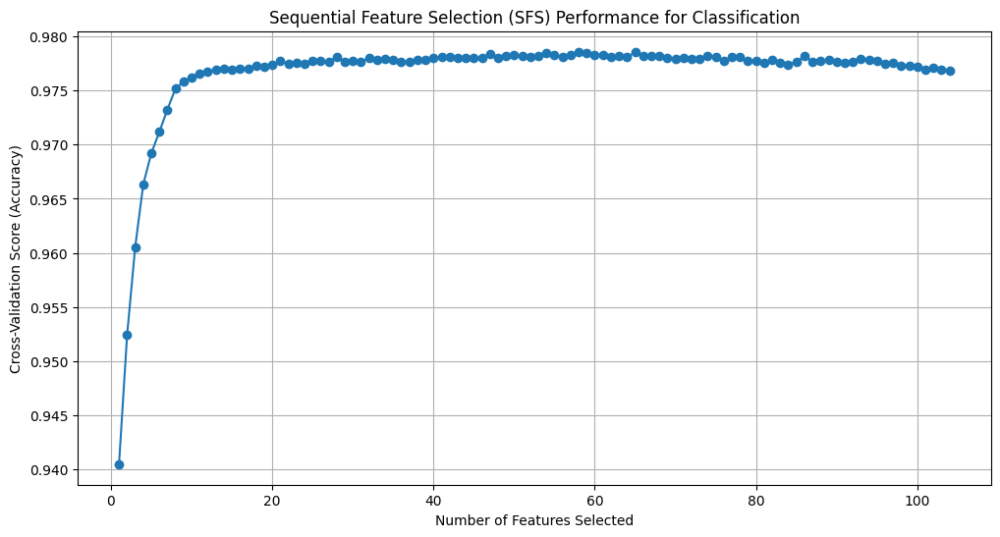

Best number of features: (3, 4, 5, 8, 9, 10, 11, 13, 15, 17, 18, 19, 21, 23, 24, 26, 28, 29, 32, 33, 35, 36, 38, 40, 43, 46, 47, 48, 51, 53, 54, 55, 56, 57, 58, 62, 64, 66, 67, 68, 71, 72, 73, 79, 81, 85, 86, 88, 90, 92, 94, 95, 96, 97, 98, 99, 101, 102)
Best cross-validation accuracy score: 0.9785685614471783
Selected feature names: ['reduced_lunch_eligible', 'direct_certification', 'PK', 'G02', 'G03', 'G04', 'G05', 'G07', 'G09', 'G11', 'G12', 'G13', 'total_female_enrollment', 'full_time_equivalent', 'student_teacher_ratio', 'american_indian_female', 'asian_male', 'asian_female', 'black_female', 'black_total', 'pacific_islander_female', 'pacific_islander_total', 'hispanic_female', 'two_or_more_races_male', 'white_male', 'is_charter_encoded', 'is_virtual_Full Virtual', 'is_virtual_Missing', 'is_virtual_Virtual with face to face options', 'lowest_grade_in_school_G02', 'lowest_grade_in_school_G03', 'lowest_grade_in_school_G04', 'lowest_grade_in_school_G05', 'lowest_grade_in_school_G06', 

In [50]:
import pandas as pd
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# Assuming log_hybrid_allTarget_df is already defined
X = df_encoded.drop(columns=['school_type_encoded'])  # Features
y = df_encoded['school_type_encoded']  # Target variable

# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the estimator
estimator = DecisionTreeClassifier(random_state=42)

# Sequential Forward Selection (SFS)
sfs = SFS(estimator,
          k_features='best',
          forward=True,  # Change to True for forward selection
          floating=False,
          scoring='accuracy',  # Use accuracy for classification
          cv=5)

# Fit SFS to the training data
sfs = sfs.fit(X_train, y_train)

# Extract the SFS results
sfs_results = pd.DataFrame.from_dict(sfs.get_metric_dict()).T

# Plotting the results
plt.figure(figsize=(12, 6))
plt.plot(sfs_results.index, sfs_results['avg_score'], marker='o')
plt.title('Sequential Feature Selection (SFS) Performance for Classification')
plt.xlabel('Number of Features Selected')
plt.ylabel('Cross-Validation Score (Accuracy)')
plt.grid()
plt.show()

# Print the best feature set and corresponding accuracy score
print("Best number of features:", sfs.k_feature_idx_)
print("Best cross-validation accuracy score:", sfs.k_score_)

# Get the feature names of the selected features
selected_feature_names = X.columns[list(sfs.k_feature_idx_)]
print("Selected feature names:", selected_feature_names.tolist())

# Optionally, evaluate the model with the selected features
X_train_selected = X_train[selected_feature_names]
X_test_selected = X_test[selected_feature_names]

# Fit the model with selected features
estimator.fit(X_train_selected, y_train)
y_pred = estimator.predict(X_test_selected)

# Calculate accuracy on the test set
test_accuracy = accuracy_score(y_test, y_pred)
print("Test Accuracy with Selected Features:", test_accuracy)

In [260]:
import pandas as pd
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
from imblearn.over_sampling import SMOTE  # Import SMOTE

# Assuming log_hybrid_allTarget_df is already defined
X = df_encoded.drop(columns=['school_type_encoded'])  # Features
y = df_encoded['school_type_encoded']  # Target variable

# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)  # Initialize SMOTE
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)  # Resample the training data

# Initialize the estimator
estimator = DecisionTreeClassifier(random_state=42)

# Sequential Forward Selection (SFS)
sfs = SFS(estimator,
          k_features='best',
          forward=True,  # Change to True for forward selection
          floating=False,
          scoring='accuracy',  # Use accuracy for classification
          cv=5,
          n_jobs= -1)

# Fit SFS to the resampled training data
sfs = sfs.fit(X_train_resampled, y_train_resampled)

# Extract the SFS results
sfs_results = pd.DataFrame.from_dict(sfs.get_metric_dict()).T

# Plotting the results
plt.figure(figsize=(12, 6))

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

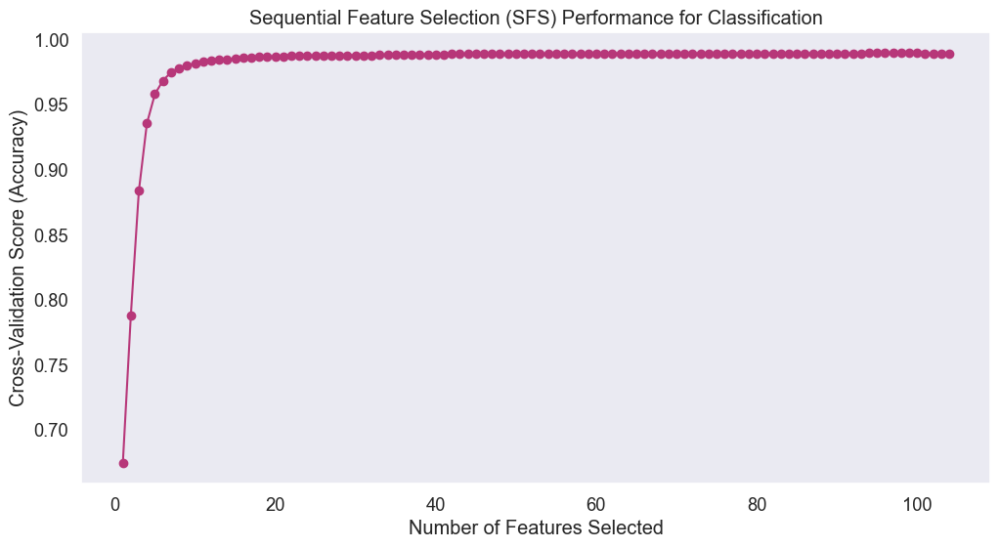

In [263]:
# Plotting the results
plt.figure(figsize=(12, 6))
plt.plot(sfs_results.index, sfs_results['avg_score'], marker='o', color= plt.cm.magma(0.5))
plt.title('Sequential Feature Selection (SFS) Performance for Classification')
plt.xlabel('Number of Features Selected')
plt.ylabel('Cross-Validation Score (Accuracy)')
plt.grid()
plt.show()

In [261]:
# Print the best feature set and corresponding accuracy score
print("Best number of features:", sfs.k_feature_idx_)
print("Best cross-validation accuracy score:", sfs.k_score_)

# Get the feature names of the selected features
selected_feature_names = X.columns[list(sfs.k_feature_idx_)]
print("Selected feature names:", selected_feature_names.tolist())

# Optionally, evaluate the model with the selected features
X_train_selected = X_train[selected_feature_names]
X_test_selected = X_test[selected_feature_names]

# Fit the model with selected features
estimator.fit(X_train_selected, y_train)
y_pred = estimator.predict(X_test_selected)

# Calculate accuracy on the test set
test_accuracy = accuracy_score(y_test, y_pred)
print("Test Accuracy with Selected Features:", test_accuracy)

Best number of features: (0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 80, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 101, 102, 103)
Best cross-validation accuracy score: 0.9899199694574952
Selected feature names: ['status', 'total_free_and_reduced_lunch_eligible', 'free_lunch_eligible', 'reduced_lunch_eligible', 'direct_certification', 'PK', 'KG', 'G01', 'G02', 'G03', 'G04', 'G05', 'G06', 'G07', 'G08', 'G09', 'G10', 'G11', 'G12', 'G13', 'total_male_enrollment', 'total_enrollment', 'full_time_equivalent', 'student_teacher_ratio', 'american_indian_male', 'american_indian_female', 'american_indian_total', 'asian_male', 'asian_female', 'asian_total', 'black_male', 'black_female', 'black_total', 'pacific_isla

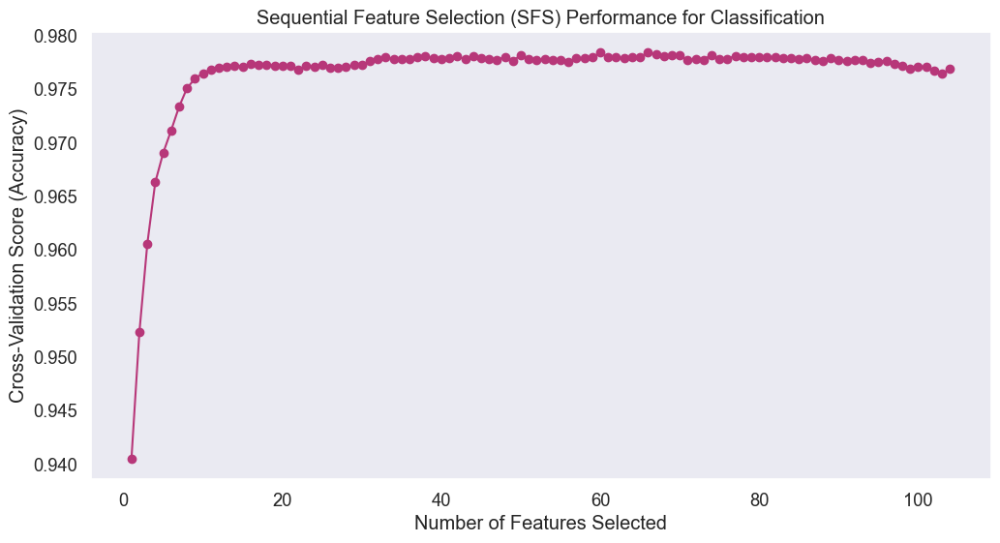

Best number of features: (0, 1, 4, 5, 9, 11, 13, 14, 15, 18, 19, 21, 22, 23, 24, 25, 26, 28, 31, 32, 33, 34, 35, 36, 37, 39, 40, 41, 46, 47, 48, 49, 50, 51, 53, 55, 56, 58, 62, 63, 65, 67, 68, 69, 71, 73, 74, 75, 78, 81, 82, 83, 86, 87, 88, 90, 92, 93, 94, 95, 96, 97, 98, 99, 101, 102)
Best cross-validation accuracy score: 0.9784296409066388
Selected feature names: ['status', 'total_free_and_reduced_lunch_eligible', 'direct_certification', 'PK', 'G03', 'G05', 'G07', 'G08', 'G09', 'G12', 'G13', 'total_female_enrollment', 'total_enrollment', 'full_time_equivalent', 'student_teacher_ratio', 'american_indian_male', 'american_indian_female', 'asian_male', 'black_male', 'black_female', 'black_total', 'pacific_islander_male', 'pacific_islander_female', 'pacific_islander_total', 'hispanic_male', 'hispanic_total', 'two_or_more_races_male', 'two_or_more_races_female', 'is_charter_encoded', 'is_virtual_Full Virtual', 'is_virtual_Missing', 'is_virtual_Not Virtual', 'is_virtual_Supplemental Virtual

In [223]:
import pandas as pd
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# Assuming log_hybrid_allTarget_df is already defined
X = log_df_encoded.drop(columns=['school_type_encoded'])  # Features
y = log_df_encoded['school_type_encoded']  # Target variable

# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the estimator
estimator = DecisionTreeClassifier(random_state=42)

# Sequential Forward Selection (SFS)
sfs = SFS(estimator,
          k_features='best',
          forward=True,  # Change to True for forward selection
          floating=False,
          scoring='accuracy',  # Use accuracy for classification
          cv=5,
          n_jobs= -1)

# Fit SFS to the training data
sfs = sfs.fit(X_train, y_train)

# Extract the SFS results
sfs_results = pd.DataFrame.from_dict(sfs.get_metric_dict()).T

# Plotting the results
plt.figure(figsize=(12, 6))
plt.plot(sfs_results.index, sfs_results['avg_score'], marker='o', color= plt.cm.magma(0.5))
plt.title('Sequential Feature Selection (SFS) Performance for Classification')
plt.xlabel('Number of Features Selected')
plt.ylabel('Cross-Validation Score (Accuracy)')
plt.grid()
plt.show()

# Print the best feature set and corresponding accuracy score
print("Best number of features:", sfs.k_feature_idx_)
print("Best cross-validation accuracy score:", sfs.k_score_)

# Get the feature names of the selected features
selected_feature_names = X.columns[list(sfs.k_feature_idx_)]
print("Selected feature names:", selected_feature_names.tolist())

# Optionally, evaluate the model with the selected features
X_train_selected = X_train[selected_feature_names]
X_test_selected = X_test[selected_feature_names]

# Fit the model with selected features
estimator.fit(X_train_selected, y_train)
y_pred = estimator.predict(X_test_selected)

# Calculate accuracy on the test set
test_accuracy = accuracy_score(y_test, y_pred)
print("Test Accuracy with Selected Features:", test_accuracy)

# Hyperparameter Tuning

In [329]:
import numpy as np
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# Load a dataset (e.g., Iris dataset)
X, y = load_iris(return_X_y=True)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define the models
dt_classifier = DecisionTreeClassifier(random_state=42)
rf_classifier = RandomForestClassifier(random_state=42)
log_reg_classifier = LogisticRegression(random_state=42)

# Define parameter distributions for RandomizedSearchCV
dt_param_dist = {
    'criterion': ['gini', 'entropy'],
    'max_depth': np.arange(1, 20),
    'min_samples_split': np.arange(2, 10)
}

rf_param_dist = {
    'n_estimators': np.arange(10, 200, 10),
    'max_depth': np.arange(1, 20),
    'class_weight': ['balanced', None]
}

log_reg_param_dist = {
    'penalty': ['l1', 'l2'],
    'C': np.logspace(-4, 4, 20),
    'solver': ['liblinear', 'lbfgs'],
    'class_weight': ['balanced', None]
}

# RandomizedSearchCV for Decision Tree
dt_search = RandomizedSearchCV(dt_classifier, dt_param_dist, n_iter=10, random_state=42, cv=3)
dt_search.fit(X_train, y_train)
print(f"Best parameters for Decision Tree Classifier: {dt_search.best_params_}")

# RandomizedSearchCV for Random Forest
rf_search = RandomizedSearchCV(rf_classifier, rf_param_dist, n_iter=10, random_state=42, cv=3)
rf_search.fit(X_train, y_train)
print(f"Best parameters for Random Forest Classifier: {rf_search.best_params_}")

# RandomizedSearchCV for Logistic Regression
log_reg_search = RandomizedSearchCV(log_reg_classifier, log_reg_param_dist, n_iter=10, random_state=42, cv=3)
log_reg_search.fit(X_train, y_train)
print(f"Best parameters for Logistic Regression: {log_reg_search.best_params_}")


Best parameters for Decision Tree Classifier: {'criterion': 'entropy', 'max_depth': 10, 'min_samples_split': 2}
Best parameters for Random Forest Classifier: {'n_estimators': 100, 'max_depth': 10, 'class_weight': balanced}
Best parameters for Logistic Regression: {'penalty': l2, 'C': 0.1, 'solver': 'liblinear', 'class_weight':'balanced'}


# Models

In [268]:
sfs_encoded_features_dt = ['reduced_lunch_eligible', 'direct_certification', 'PK', 'G02', 'G03', 'G04', 'G05', 'G07', 'G09', 'G11', 'G12', 'G13', 'total_female_enrollment', 'full_time_equivalent', 'student_teacher_ratio', 'american_indian_female', 'asian_male', 'asian_female', 'black_female', 'black_total', 'pacific_islander_female', 'pacific_islander_total', 'hispanic_female', 'tribal_male', 'white_male', 'is_charter_encoded', 'is_virtual_Full Virtual', 'is_virtual_Missing', 'is_virtual_Virtual with face to face options', 'lowest_grade_in_school_G02', 'lowest_grade_in_school_G03', 'lowest_grade_in_school_G04', 'lowest_grade_in_school_G05', 'lowest_grade_in_school_G06', 'lowest_grade_in_school_G07', 'lowest_grade_in_school_G11', 'lowest_grade_in_school_KG', 'highest_grade_in_school_G01', 'highest_grade_in_school_G02', 'highest_grade_in_school_G03', 'highest_grade_in_school_G06', 'highest_grade_in_school_G07', 'highest_grade_in_school_G08', 'highest_grade_in_school_KG', 'school_level_High', 'urban_centric_locale_code_11-City: Large', 'urban_centric_locale_code_12-City: Mid-size', 'urban_centric_locale_code_21-Suburb: Large', 'urban_centric_locale_code_23-Suburb: Small', 'urban_centric_locale_code_32-Town: Distant', 'urban_centric_locale_code_41-Rural: Fringe', 'urban_centric_locale_code_42-Rural: Distant', 'urban_centric_locale_code_43-Rural: Remote', 'state', 'district_id', 'state_district_id', 'zipcode', 'extended_zipcode']
sfs_log_encoded_features_dt = ['status', 'total_free_and_reduced_lunch_eligible', 'direct_certification', 'PK', 'G03', 'G05', 'G07', 'G08', 'G09', 'G12', 'G13', 'total_female_enrollment', 'total_enrollment', 'full_time_equivalent', 'student_teacher_ratio', 'american_indian_male', 'american_indian_female', 'asian_male', 'black_male', 'black_female', 'black_total', 'pacific_islander_male', 'pacific_islander_female', 'pacific_islander_total', 'hispanic_male', 'hispanic_total', 'tribal_male', 'tribal_female', 'is_charter_encoded', 'is_virtual_Full Virtual', 'is_virtual_Missing', 'is_virtual_Not Virtual', 'is_virtual_Supplemental Virtual', 'is_virtual_Virtual with face to face options', 'lowest_grade_in_school_G02', 'lowest_grade_in_school_G04', 'lowest_grade_in_school_G05', 'lowest_grade_in_school_G07', 'lowest_grade_in_school_G11', 'lowest_grade_in_school_G12', 'lowest_grade_in_school_PK', 'highest_grade_in_school_G02', 'highest_grade_in_school_G03', 'highest_grade_in_school_G04', 'highest_grade_in_school_G06', 'highest_grade_in_school_G08', 'highest_grade_in_school_G09', 'highest_grade_in_school_G10', 'highest_grade_in_school_G13', 'school_level_High', 'school_level_Middle', 'school_level_Other', 'urban_centric_locale_code_12-City: Mid-size', 'urban_centric_locale_code_13-City: Small', 'urban_centric_locale_code_21-Suburb: Large', 'urban_centric_locale_code_23-Suburb: Small', 'urban_centric_locale_code_32-Town: Distant', 'urban_centric_locale_code_33-Town: Remote', 'urban_centric_locale_code_41-Rural: Fringe', 'urban_centric_locale_code_42-Rural: Distant', 'urban_centric_locale_code_43-Rural: Remote', 'state', 'district_id', 'state_district_id', 'zipcode', 'extended_zipcode']
sfs_encoded_features_df_SMOTE = ['status', 'total_free_and_reduced_lunch_eligible', 'free_lunch_eligible', 'reduced_lunch_eligible', 'direct_certification', 'PK', 'KG', 'G01', 'G02', 'G03', 'G04', 'G05', 'G06', 'G07', 'G08', 'G09', 'G10', 'G11', 'G12', 'G13', 'total_male_enrollment', 'total_enrollment', 'full_time_equivalent', 'student_teacher_ratio', 'american_indian_male', 'american_indian_female', 'american_indian_total', 'asian_male', 'asian_female', 'asian_total', 'black_male', 'black_female', 'black_total', 'pacific_islander_male', 'pacific_islander_female', 'pacific_islander_total', 'hispanic_male', 'hispanic_female', 'hispanic_total', 'tribal_male', 'tribal_female', 'tribal_total', 'white_male', 'white_female', 'white_total', 'is_charter_encoded', 'is_virtual_Full Virtual', 'is_virtual_Missing', 'is_virtual_Not Virtual', 'is_virtual_Supplemental Virtual', 'is_virtual_Virtual with face to face options', 'lowest_grade_in_school_G01', 'lowest_grade_in_school_G02', 'lowest_grade_in_school_G03', 'lowest_grade_in_school_G04', 'lowest_grade_in_school_G05', 'lowest_grade_in_school_G06', 'lowest_grade_in_school_G07', 'lowest_grade_in_school_G08', 'lowest_grade_in_school_G09', 'lowest_grade_in_school_G10', 'lowest_grade_in_school_G11', 'lowest_grade_in_school_G12', 'lowest_grade_in_school_KG', 'lowest_grade_in_school_PK', 'highest_grade_in_school_G01', 'highest_grade_in_school_G02', 'highest_grade_in_school_G03', 'highest_grade_in_school_G04', 'highest_grade_in_school_G05', 'highest_grade_in_school_G06', 'highest_grade_in_school_G07', 'highest_grade_in_school_G08', 'highest_grade_in_school_G09', 'highest_grade_in_school_G10', 'highest_grade_in_school_G11', 'highest_grade_in_school_G13', 'highest_grade_in_school_KG', 'school_level_Elementary', 'school_level_Middle', 'school_level_Other', 'school_level_Secondary', 'urban_centric_locale_code_11-City: Large', 'urban_centric_locale_code_12-City: Mid-size', 'urban_centric_locale_code_13-City: Small', 'urban_centric_locale_code_21-Suburb: Large', 'urban_centric_locale_code_22-Suburb: Mid-size', 'urban_centric_locale_code_23-Suburb: Small', 'urban_centric_locale_code_31-Town: Fringe', 'urban_centric_locale_code_32-Town: Distant', 'urban_centric_locale_code_33-Town: Remote', 'urban_centric_locale_code_41-Rural: Fringe', 'urban_centric_locale_code_42-Rural: Distant', 'urban_centric_locale_code_43-Rural: Remote', 'state', 'district_id', 'state_district_id', 'zipcode', 'extended_zipcode', 'county_name']

In [292]:
model_randomized_search_dt = DecisionTreeClassifier(min_samples_split= 2, max_depth = 10, criterion = 'entropy', random_state=42)
model_randomized_search_rf = RandomForestClassifier(n_estimators=100, max_depth=10, class_weight='balanced', random_state=42)
model_randomized_search_lr = LogisticRegression(penalty='l2', C=0.1, solver='liblinear', class_weight='balanced', random_state=42)


##### Decision Tree Classifier

In [269]:
X = df_encoded.drop("school_type_encoded", axis=1) 
y = df_encoded["school_type_encoded"] 

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
X_train_sfs_encoded_features_dt = X_train[sfs_encoded_features_dt]
X_test_sfs_encoded_features_dt = X_test[sfs_encoded_features_dt]
X_train_sfs_encoded_features_df_SMOTE = X_train[sfs_encoded_features_df_SMOTE]
X_test_sfs_encoded_features_df_SMOTE = X_test[sfs_encoded_features_df_SMOTE]

results = []

# Define the models
models = {
    'model_vanilla': DecisionTreeClassifier(random_state=42),
    'model_randomized_search': DecisionTreeClassifier(min_samples_split= 2, max_depth = 10, criterion = 'entropy', random_state=42)
}

# List of training sets
training_sets = {
    'X_train': (X_train, y_train, X_test, y_test),
    'X_train_sfs_encoded_features_dt': (X_train_sfs_encoded_features_dt, y_train, X_test_sfs_encoded_features_dt, y_test),  
    'X_train_sfs_encoded_features_df_SMOTE': (X_train_sfs_encoded_features_df_SMOTE, y_train, X_test_sfs_encoded_features_df_SMOTE, y_test) 
}

# Train each model on each training set and store results
for model_name, model in models.items():
    for train_set_name, (X_train_set, y_train_set, X_test_set, y_test_set) in training_sets.items():
        # Fit the model
        model.fit(X_train_set, y_train_set)
        
        # Make predictions on the test set
        y_pred = model.predict(X_test_set)
        
        # Calculate performance metrics for classification
        accuracy = accuracy_score(y_test_set, y_pred)  # Change to accuracy
        precision = precision_score(y_test_set, y_pred, average='weighted')  # Optional: calculate precision
        recall = recall_score(y_test_set, y_pred, average='weighted')  # Optional: calculate recall
        f1 = f1_score(y_test_set, y_pred, average='weighted')  # Optional: calculate F1 score
        
        # Append results to the list
        results.append({
            'Model': model_name,
            'Training Set': train_set_name,
            'Accuracy': accuracy,  # Change to accuracy
            'Precision': precision,  # Optional: add precision
            'Recall': recall,  # Optional: add recall
            'F1 Score': f1  # Optional: add F1 score
        })

# Create a DataFrame from the results list
results_df = pd.DataFrame(results)

# Display the results DataFrame
results_df

,Model,Training Set,Accuracy,Precision,Recall,F1 Score
0,model_vanilla,X_train,0.978644,0.978454,0.978644,0.978540
1,model_vanilla,X_train_sfs_encoded_features_dt,0.978847,0.978699,0.978847,0.978745
2,model_vanilla,X_train_sfs_encoded_features_df_SMOTE,0.977834,0.977879,0.977834,0.977840
3,model_randomized_search,X_train,0.980589,0.981038,0.980589,0.980612
4,model_randomized_search,X_train_sfs_encoded_features_dt,0.982210,0.982420,0.982210,0.982099
5,model_randomized_search,X_train_sfs_encoded_features_df_SMOTE,0.980062,0.979944,0.980062,0.979816


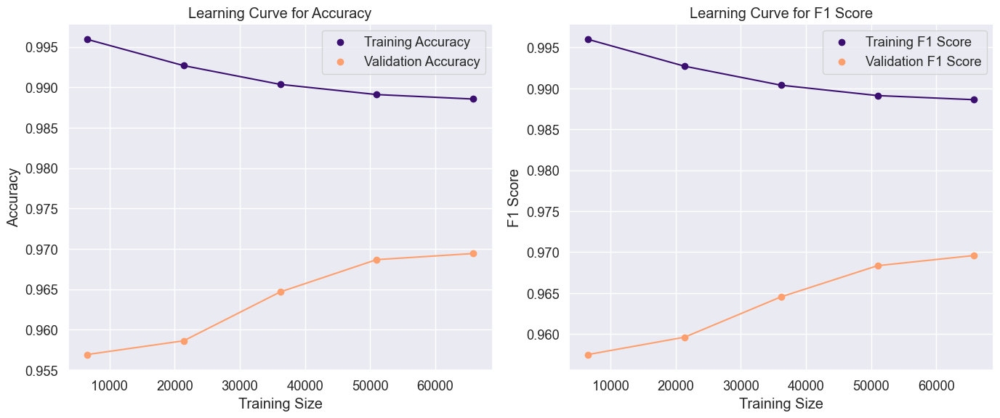

In [293]:
from sklearn.model_selection import learning_curve
import matplotlib.pyplot as plt
import numpy as np

# Generate learning curve data for accuracy
train_sizes_acc, train_scores_acc, valid_scores_acc, *_ = learning_curve(
    model_randomized_search_dt, X, y, cv=5, scoring='accuracy', n_jobs=-1
)

# Generate learning curve data for F1 score
train_sizes_f1, train_scores_f1, valid_scores_f1, *_ = learning_curve(
    model_randomized_search_dt, X, y, cv=5, scoring='f1_weighted', n_jobs=-1
)

# Create a plot with two subplots side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Plot accuracy learning curve
ax1.scatter(x=train_sizes_acc, y=train_scores_acc.mean(axis=1), color=plt.cm.magma(0.2), label='Training Accuracy')
ax1.scatter(x=train_sizes_acc, y=valid_scores_acc.mean(axis=1), color=plt.cm.magma(0.8), label='Validation Accuracy')
ax1.plot(train_sizes_acc, train_scores_acc.mean(axis=1), color=plt.cm.magma(0.2))
ax1.plot(train_sizes_acc, valid_scores_acc.mean(axis=1), color=plt.cm.magma(0.8))
ax1.set_xlabel('Training Size')
ax1.set_ylabel('Accuracy')
ax1.set_title('Learning Curve for Accuracy')
ax1.legend(loc='best')

# Plot F1 score learning curve
ax2.scatter(x=train_sizes_f1, y=train_scores_f1.mean(axis=1), color=plt.cm.magma(0.2), label='Training F1 Score')
ax2.scatter(x=train_sizes_f1, y=valid_scores_f1.mean(axis=1), color=plt.cm.magma(0.8), label='Validation F1 Score')
ax2.plot(train_sizes_f1, train_scores_f1.mean(axis=1), color=plt.cm.magma(0.2))
ax2.plot(train_sizes_f1, valid_scores_f1.mean(axis=1), color=plt.cm.magma(0.8))
ax2.set_xlabel('Training Size')
ax2.set_ylabel('F1 Score')
ax2.set_title('Learning Curve for F1 Score')
ax2.legend(loc='best')

# Show the plot
plt.tight_layout()
plt.show()


##### Both graphs show that the curves are converging into one another, which means that test accuracy/f1 score is getting better over time and training is losing some accuracy which is a sign of the model's good performance. The gap between the curves is measured to almost 0.02 which is a negligible number.

In [319]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from mlxtend.evaluate import bias_variance_decomp
from sklearn.datasets import load_iris
from sklearn.metrics import accuracy_score

X = df_encoded.drop("school_type_encoded", axis=1) 
y = df_encoded["school_type_encoded"] 

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Convert DataFrames to NumPy arrays
X_train_np = X_train.to_numpy()
y_train_np = y_train.to_numpy()
X_test_np = X_test.to_numpy()
y_test_np = y_test.to_numpy()

# Initialize the Decision Tree Classifier
model_randomized_search_dt = DecisionTreeClassifier(min_samples_split= 2, max_depth = 10, criterion = 'entropy', random_state=42)
# Fit the model on the training data
model_randomized_search_dt.fit(X_train_np, y_train_np)

# Calculate bias, variance, and 0-1 loss
loss_01, bias, var = bias_variance_decomp(
    model_randomized_search_dt,
    X_train_np,
    y_train_np,
    X_test_np,
    y_test_np,
    loss='0-1_loss',  # Using 0-1 loss for classification
    num_rounds=20,
    random_seed=42
)
y_pred = model_randomized_search_dt.predict(X_test_np)
accuracy = accuracy_score(y_test_np, y_pred)

print('Randomized Search Decision Tree Bias: %.3f' % bias)
print('Randomized Search Decision Tree Variance: %.3f' % var)




Randomized Search Decision Tree Bias: 0.016
Randomized Search Decision Tree Variance: 0.012


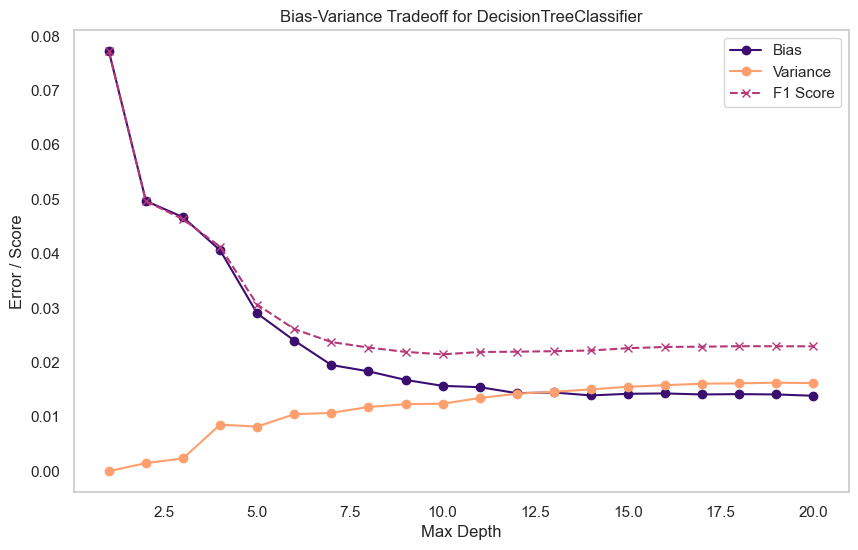

In [326]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from mlxtend.evaluate import bias_variance_decomp
from sklearn.metrics import accuracy_score, f1_score

# Define the range of max_depth values to test
max_depth_range = np.arange(1, 21)  # Testing max_depth from 1 to 20
bias_list = []
variance_list = []
f1_list = []

# Loop over the max_depth values
for max_depth in max_depth_range:
    
    model_randomized_search_dt = DecisionTreeClassifier(min_samples_split= 2, max_depth = max_depth, criterion = 'entropy', random_state=42)

    
    model_randomized_search_dt.fit(X_train, y_train)
    
    # Calculate bias, variance, and F1 score
    f1, bias, var = bias_variance_decomp(
        model_randomized_search_dt,
        X_train.values,
        y_train.values,
        X_test.values,
        y_test.values,
        loss='0-1_loss', 
        num_rounds=20,
        random_seed=42
    )
    
    # Append the results
    bias_list.append(bias)
    variance_list.append(var)
    f1_list.append(f1)

# Plotting the bias-variance tradeoff
plt.figure(figsize=(10, 6))
plt.plot(max_depth_range, bias_list, label='Bias', color=plt.cm.magma(0.2), marker='o')
plt.plot(max_depth_range, variance_list, label='Variance', color=plt.cm.magma(0.8), marker='o')
plt.plot(max_depth_range, f1_list, label='F1 Score', color=plt.cm.magma(0.5), linestyle='--', marker='x')
plt.xlabel('Max Depth')
plt.ylabel('Error / Score')
plt.title('Bias-Variance Tradeoff for DecisionTreeClassifier')
plt.legend()
plt.grid()
plt.show()

##### Random Forest

In [273]:
X = df_encoded.drop("school_type_encoded", axis=1) 
y = df_encoded["school_type_encoded"] 

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
X_train_sfs_encoded_features_dt = X_train[sfs_encoded_features_dt]
X_test_sfs_encoded_features_dt = X_test[sfs_encoded_features_dt]
X_train_sfs_encoded_features_df_SMOTE = X_train[sfs_encoded_features_df_SMOTE]
X_test_sfs_encoded_features_df_SMOTE = X_test[sfs_encoded_features_df_SMOTE]

results = []

# Define the models
models = {
    'model_vanilla': RandomForestClassifier(random_state=42),  # Random Forest Classifier
    'model_randomized_search': RandomForestClassifier(n_estimators=100, max_depth=10, class_weight='balanced', random_state=42)  # Example parameters
}

# List of training sets
training_sets = {
    'X_train': (X_train, y_train, X_test, y_test),
    'X_train_sfs_encoded_features_dt': (X_train_sfs_encoded_features_dt, y_train, X_test_sfs_encoded_features_dt, y_test),  
    'X_train_sfs_encoded_features_df_SMOTE': (X_train_sfs_encoded_features_df_SMOTE, y_train, X_test_sfs_encoded_features_df_SMOTE, y_test) 
}

# Train each model on each training set and store results
for model_name, model in models.items():
    for train_set_name, (X_train_set, y_train_set, X_test_set, y_test_set) in training_sets.items():
        # Fit the model
        model.fit(X_train_set, y_train_set)
        
        # Make predictions on the test set
        y_pred = model.predict(X_test_set)
        
        # Calculate performance metrics for classification
        accuracy = accuracy_score(y_test_set, y_pred)  # Change to accuracy
        precision = precision_score(y_test_set, y_pred, average='weighted')  # Optional: calculate precision
        recall = recall_score(y_test_set, y_pred, average='weighted')  # Optional: calculate recall
        f1 = f1_score(y_test_set, y_pred, average='weighted')  # Optional: calculate F1 score
        
        # Append results to the list
        results.append({
            'Model': model_name,
            'Training Set': train_set_name,
            'Accuracy': accuracy,  # Change to accuracy
            'Precision': precision,  # Optional: add precision
            'Recall': recall,  # Optional: add recall
            'F1 Score': f1  # Optional: add F1 score
        })

results_df = pd.DataFrame(results)

results_df

,Model,Training Set,Accuracy,Precision,Recall,F1 Score
0,model_vanilla,X_train,0.985655,0.985395,0.985655,0.985198
1,model_vanilla,X_train_sfs_encoded_features_dt,0.986222,0.985987,0.986222,0.985755
2,model_vanilla,X_train_sfs_encoded_features_df_SMOTE,0.985493,0.985298,0.985493,0.984967
3,model_randomized_search,X_train,0.967905,0.974278,0.967905,0.970218
4,model_randomized_search,X_train_sfs_encoded_features_dt,0.970377,0.975667,0.970377,0.972278
5,model_randomized_search,X_train_sfs_encoded_features_df_SMOTE,0.967297,0.973682,0.967297,0.969611


In [321]:
model_vanilla = RandomForestClassifier(random_state=42)

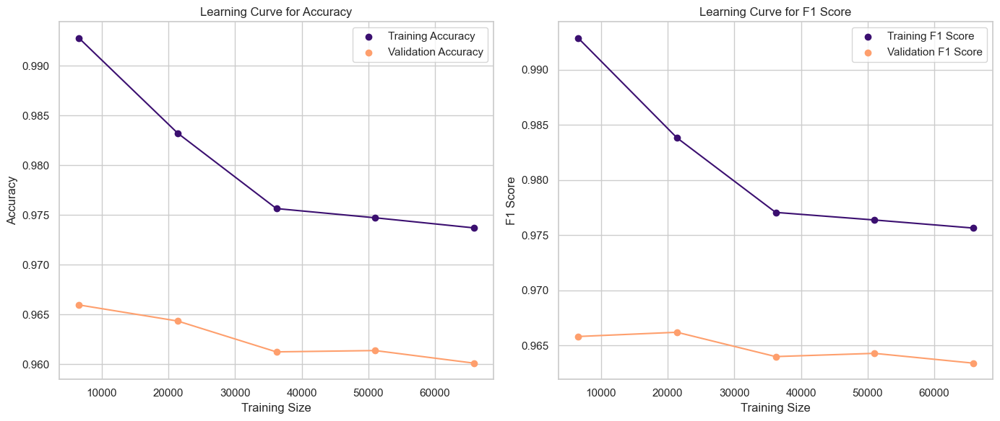

In [324]:
from sklearn.model_selection import learning_curve
import matplotlib.pyplot as plt
import numpy as np

# Generate learning curve data for accuracy
train_sizes_acc, train_scores_acc, valid_scores_acc, *_ = learning_curve(
    model_randomized_search_rf, X, y, cv=5, scoring='accuracy', n_jobs=-1
)

# Generate learning curve data for F1 score
train_sizes_f1, train_scores_f1, valid_scores_f1, *_ = learning_curve(
    model_randomized_search_rf, X, y, cv=5, scoring='f1_weighted', n_jobs=-1
)

# Create a plot with two subplots side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Plot accuracy learning curve
ax1.scatter(x=train_sizes_acc, y=train_scores_acc.mean(axis=1), color=plt.cm.magma(0.2), label='Training Accuracy')
ax1.scatter(x=train_sizes_acc, y=valid_scores_acc.mean(axis=1), color=plt.cm.magma(0.8), label='Validation Accuracy')
ax1.plot(train_sizes_acc, train_scores_acc.mean(axis=1), color=plt.cm.magma(0.2))
ax1.plot(train_sizes_acc, valid_scores_acc.mean(axis=1), color=plt.cm.magma(0.8))
ax1.set_xlabel('Training Size')
ax1.set_ylabel('Accuracy')
ax1.set_title('Learning Curve for Accuracy')
ax1.legend(loc='best')

# Plot F1 score learning curve
ax2.scatter(x=train_sizes_f1, y=train_scores_f1.mean(axis=1), color=plt.cm.magma(0.2), label='Training F1 Score')
ax2.scatter(x=train_sizes_f1, y=valid_scores_f1.mean(axis=1), color=plt.cm.magma(0.8), label='Validation F1 Score')
ax2.plot(train_sizes_f1, train_scores_f1.mean(axis=1), color=plt.cm.magma(0.2))
ax2.plot(train_sizes_f1, valid_scores_f1.mean(axis=1), color=plt.cm.magma(0.8))
ax2.set_xlabel('Training Size')
ax2.set_ylabel('F1 Score')
ax2.set_title('Learning Curve for F1 Score')
ax2.legend(loc='best')

# Show the plot
plt.tight_layout()
plt.show()


##### Initially I believed that the data might be overfitting because the validation Curve is almost flat and there appears to be some distance between the graphs. However, the gap is measured at almost 0.03 which is a very insignificant number, so even if there is overfitting, it is slight. However, this insignificant gap could be indication that the model is generalizing well. Additionally, accuracy and f1 score have the same shape and almost the same gap, so this indicates that the model is consistent. Compared to the decision trees, it looks like random forest is slighly overfitting, but that could be the result of it being a more complex model.

In [325]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from mlxtend.evaluate import bias_variance_decomp
from sklearn.datasets import load_iris
from sklearn.metrics import accuracy_score

X = df_encoded.drop("school_type_encoded", axis=1) 
y = df_encoded["school_type_encoded"] 

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Convert DataFrames to NumPy arrays
X_train_np = X_train.to_numpy()
y_train_np = y_train.to_numpy()
X_test_np = X_test.to_numpy()
y_test_np = y_test.to_numpy()

# Initialize the Decision Tree Classifier
model_randomized_search_rf = RandomForestClassifier(n_estimators=100, max_depth=10, class_weight='balanced', random_state=42)
# Fit the model on the training data
model_randomized_search_rf.fit(X_train_np, y_train_np)

# Calculate bias, variance, and 0-1 loss
loss_01, bias, var = bias_variance_decomp(
    model_randomized_search_rf,
    X_train_np,
    y_train_np,
    X_test_np,
    y_test_np,
    loss='0-1_loss',  # Using 0-1 loss for classification
    num_rounds=20,
    random_seed=42
)
y_pred = model_randomized_search_dt.predict(X_test_np)
accuracy = accuracy_score(y_test_np, y_pred)

print('Randomized Search Random Forest Bias: %.3f' % bias)
print('Randomized Search Random Forest Variance: %.3f' % var)




Randomized Search Random Forest Bias: 0.032
Randomized Search Random Forest Variance: 0.006


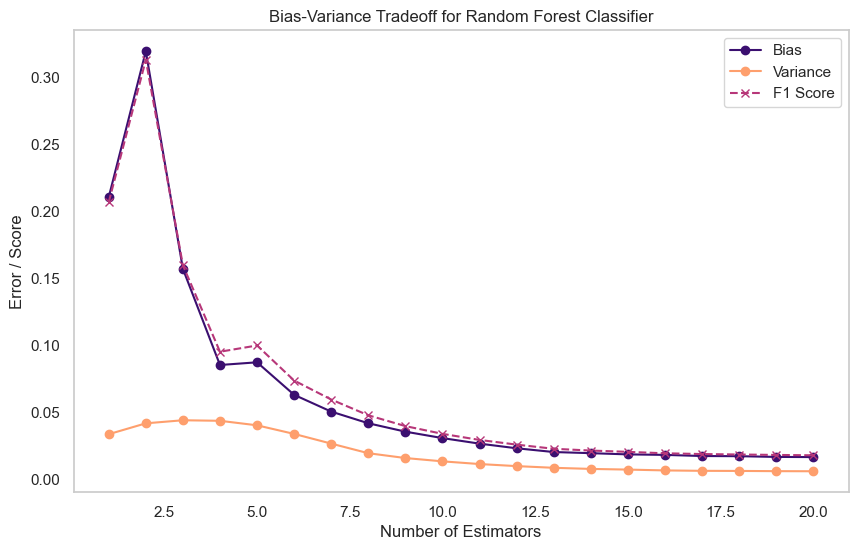

In [330]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from mlxtend.evaluate import bias_variance_decomp
from sklearn.metrics import accuracy_score, f1_score

# Define the range of max_depth values to test
max_depth_range = np.arange(1, 21)  # Testing max_depth from 1 to 20
bias_list = []
variance_list = []
f1_list = []

# Loop over the max_depth values
for max_depth in max_depth_range:
    
    model_randomized_search_dt = RandomForestClassifier(n_estimators=max_depth, max_depth=max_depth, class_weight='balanced', random_state=42)

    
    model_randomized_search_dt.fit(X_train, y_train)
    
    # Calculate bias, variance, and F1 score
    f1, bias, var = bias_variance_decomp(
        model_randomized_search_dt,
        X_train.values,
        y_train.values,
        X_test.values,
        y_test.values,
        loss='0-1_loss', 
        num_rounds=20,
        random_seed=42
    )
    
    # Append the results
    bias_list.append(bias)
    variance_list.append(var)
    f1_list.append(f1)

# Plotting the bias-variance tradeoff
plt.figure(figsize=(10, 6))
plt.plot(max_depth_range, bias_list, label='Bias', color=plt.cm.magma(0.2), marker='o')
plt.plot(max_depth_range, variance_list, label='Variance', color=plt.cm.magma(0.8), marker='o')
plt.plot(max_depth_range, f1_list, label='F1 Score', color=plt.cm.magma(0.5), linestyle='--', marker='x')
plt.xlabel('Number of Estimators')
plt.ylabel('Error / Score')
plt.title('Bias-Variance Tradeoff for Random Forest Classifier')
plt.legend()
plt.grid()
plt.show()

##### Logistic Regression

In [284]:
from sklearn.linear_model import LogisticRegression  # Import Logistic Regression

# Replace KNeighborsClassifier with LogisticRegression
models = {
    'model_vanilla': LogisticRegression(random_state=42, max_iter=10000),
    'model_randomized_search': LogisticRegression(penalty='l2', C=0.1, solver='liblinear', class_weight='balanced', random_state=42)
}

# Train each model on each training set and store results
results = []  # Reset the results list to avoid duplicating entries
for model_name, model in models.items():
    for train_set_name, (X_train_set, y_train_set, X_test_set, y_test_set) in training_sets.items():
        # Fit the model
        model.fit(X_train_set, y_train_set)
        
        # Make predictions on the test set
        y_pred = model.predict(X_test_set)
        
        # Calculate performance metrics for classification
        accuracy = accuracy_score(y_test_set, y_pred)
        precision = precision_score(y_test_set, y_pred, average='weighted', zero_division=0)
        recall = recall_score(y_test_set, y_pred, average='weighted', zero_division=0)
        f1 = f1_score(y_test_set, y_pred, average='weighted', zero_division=0)
        
        # Append results to the list
        results.append({
            'Model': model_name,
            'Training Set': train_set_name,
            'Accuracy': accuracy,
            'Precision': precision,
            'Recall': recall,
            'F1 Score': f1
        })

# Create a DataFrame from the results list
results_df = pd.DataFrame(results)

# Display the results DataFrame
results_df


c:\Users\zeina\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

c:\Users\zeina\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#log

,Model,Training Set,Accuracy,Precision,Recall,F1 Score
0,model_vanilla,X_train,0.976172,0.975237,0.976172,0.975587
1,model_vanilla,X_train_sfs_encoded_features_dt,0.974754,0.973534,0.974754,0.973970
2,model_vanilla,X_train_sfs_encoded_features_df_SMOTE,0.976496,0.975534,0.976496,0.975890
3,model_randomized_search,X_train,0.957815,0.965896,0.957815,0.960945
4,model_randomized_search,X_train_sfs_encoded_features_dt,0.959436,0.968819,0.959436,0.962971
5,model_randomized_search,X_train_sfs_encoded_features_df_SMOTE,0.958058,0.966052,0.958058,0.961193


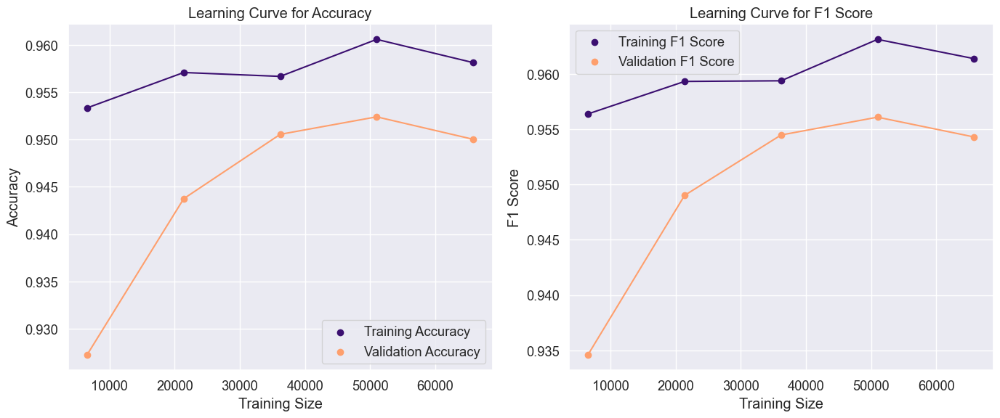

In [296]:
from sklearn.model_selection import learning_curve
import matplotlib.pyplot as plt
import numpy as np

# Generate learning curve data for accuracy
train_sizes_acc, train_scores_acc, valid_scores_acc, *_ = learning_curve(
    model_randomized_search_lr, X, y, cv=5, scoring='accuracy', n_jobs=-1
)

# Generate learning curve data for F1 score
train_sizes_f1, train_scores_f1, valid_scores_f1, *_ = learning_curve(
    model_randomized_search_lr, X, y, cv=5, scoring='f1_weighted', n_jobs=-1
)

# Create a plot with two subplots side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Plot accuracy learning curve
ax1.scatter(x=train_sizes_acc, y=train_scores_acc.mean(axis=1), color=plt.cm.magma(0.2), label='Training Accuracy')
ax1.scatter(x=train_sizes_acc, y=valid_scores_acc.mean(axis=1), color=plt.cm.magma(0.8), label='Validation Accuracy')
ax1.plot(train_sizes_acc, train_scores_acc.mean(axis=1), color=plt.cm.magma(0.2))
ax1.plot(train_sizes_acc, valid_scores_acc.mean(axis=1), color=plt.cm.magma(0.8))
ax1.set_xlabel('Training Size')
ax1.set_ylabel('Accuracy')
ax1.set_title('Learning Curve for Accuracy')
ax1.legend(loc='best')

# Plot F1 score learning curve
ax2.scatter(x=train_sizes_f1, y=train_scores_f1.mean(axis=1), color=plt.cm.magma(0.2), label='Training F1 Score')
ax2.scatter(x=train_sizes_f1, y=valid_scores_f1.mean(axis=1), color=plt.cm.magma(0.8), label='Validation F1 Score')
ax2.plot(train_sizes_f1, train_scores_f1.mean(axis=1), color=plt.cm.magma(0.2))
ax2.plot(train_sizes_f1, valid_scores_f1.mean(axis=1), color=plt.cm.magma(0.8))
ax2.set_xlabel('Training Size')
ax2.set_ylabel('F1 Score')
ax2.set_title('Learning Curve for F1 Score')
ax2.legend(loc='best')

# Show the plot
plt.tight_layout()
plt.show()


##### The learning curve indicates that the model’s performance is improving with more training data since the test accuracy/f1 score is increasing as the training data increases, indicating better generalization. The gap between the curves is decreasing as the model trains more, another indication for good performance and generalization. 

In [334]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from mlxtend.evaluate import bias_variance_decomp
from sklearn.datasets import load_iris
from sklearn.metrics import accuracy_score

X = df_encoded.drop("school_type_encoded", axis=1) 
y = df_encoded["school_type_encoded"] 

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Convert DataFrames to NumPy arrays
X_train_np = X_train.to_numpy()
y_train_np = y_train.to_numpy()
X_test_np = X_test.to_numpy()
y_test_np = y_test.to_numpy()

# Initialize the Decision Tree Classifier
model_randomized_search_lr = LogisticRegression(penalty='l2', C=0.1, solver='liblinear', class_weight='balanced', random_state=42)
# Fit the model on the tlr.fit(X_train_np, y_train_np)

# Calculate bias, variance, and 0-1 loss
loss_01, bias, var = bias_variance_decomp(
    model_randomized_search_lr,
    X_train_np,
    y_train_np,
    X_test_np,
    y_test_np,
    loss='0-1_loss',  # Using 0-1 loss for classification
    num_rounds=20,
    random_seed=42
)
y_pred = model_randomized_search_dt.predict(X_test_np)
accuracy = accuracy_score(y_test_np, y_pred)

print('Randomized Search Logistic Regression Bias: %.3f' % bias)
print('Randomized Search Logistic Regression Variance: %.3f' % var)


In [335]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from mlxtend.evaluate import bias_variance_decomp
from sklearn.metrics import accuracy_score, f1_score
from sklearn.datasets import load_iris

# Load the Iris dataset (you can replace it with your own dataset)
X, y = load_iris(return_X_y=True)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define the range of C values to test for Logistic Regression (regularization strength)
C_range = np.logspace(-4, 4, 20)  # Testing C values from 0.0001 to 10000
bias_list = []
variance_list = []
f1_list = []

# Loop over the C values
for C in C_range:
    
    # Initialize the Logistic Regression model with the current C value
    model_log_reg = LogisticRegression(C=C, max_iter=1000, solver='liblinear', class_weight='balanced', random_state=42)
    
    # Train the model
    model_log_reg.fit(X_train, y_train)
    
    # Calculate bias, variance, and F1 score
    f1, bias, var = bias_variance_decomp(
        model_log_reg,
        X_train,
        y_train,
        X_test,
        y_test,
        loss='0-1_loss', 
        num_rounds=20,
        random_seed=42
    )
    
    # Append the results
    bias_list.append(bias)
    variance_list.append(var)
    f1_list.append(f1)

# Plotting the bias-variance tradeoff
plt.figure(figsize=(10, 6))
plt.plot(C_range, bias_list, label='Bias', color=plt.cm.magma(0.2), marker='o')
plt.plot(C_range, variance_list, label='Variance', color=plt.cm.magma(0.8), marker='o')
plt.plot(C_range, f1_list, label='F1 Score', color=plt.cm.magma(0.5), linestyle='--', marker='x')
plt.xscale('log')  # Use logarithmic scale for C values
plt.xlabel('Regularization Strength (C)')
plt.ylabel('Error / Score')
plt.title('Bias-Variance Tradeoff for Logistic Regression')
plt.legend()
plt.grid(True)
plt.show()

#### Is the model overfitting?

##### Testing whether the class imbalance might be causing overfitting:
##### Comparing between the classifiers using SMOTE

In [298]:
# Import necessary libraries
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import pandas as pd

results = []

# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Apply SMOTE to the training data to balance the classes
smote = SMOTE(random_state=42)
X_train_res, y_train_res = smote.fit_resample(X_train, y_train)

# Define multiple models
models = {
    'Random Forest Vanilla': RandomForestClassifier(random_state=42),
    'Random Forest Randomized Search': RandomForestClassifier(n_estimators=100, max_depth=10, class_weight='balanced', random_state=42),
    "Decision Tree": DecisionTreeClassifier(random_state=42),
    "Decision Tree Randomized Search": DecisionTreeClassifier(min_samples_split= 2, max_depth = 10, criterion = 'entropy', random_state=42),
    "Logistic Regression Vanilla": LogisticRegression(random_state=42, max_iter=10000),
    "Logistic Regression Randomized Search": LogisticRegression(penalty='l2', C=0.1, solver='liblinear', class_weight='balanced', random_state=42)
}

# Train and evaluate each model
for model_name, model in models.items():
    # Train the model
    model.fit(X_train_res, y_train_res)
    
    # Make predictions on the test set
    y_pred = model.predict(X_test)
    
    # Evaluate the model
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted', zero_division=0)
    recall = recall_score(y_test, y_pred, average='weighted', zero_division=0)
    f1 = f1_score(y_test, y_pred, average='weighted', zero_division=0)
        
    # Append results to the list
    results.append({
        'Model': model_name,
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    })

# Convert results to a DataFrame
results_df = pd.DataFrame(results)

# Display the results DataFrame
print(results_df)


c:\Users\zeina\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



                                   Model  Accuracy  Precision    Recall  \
0                  Random Forest Vanilla  0.985594   0.986191  0.985594   
1        Random Forest Randomized Search  0.967481   0.974794  0.967481   
2                          Decision Tree  0.975748   0.977353  0.975748   
3        Decision Tree Randomized Search  0.959397   0.969808  0.959397   
4            Logistic Regression Vanilla  0.967967   0.972075  0.967967   
5  Logistic Regression Randomized Search  0.947484   0.959355  0.947484   

   F1 Score  
0  0.985792  
1  0.970040  
2  0.976408  
3  0.963131  
4  0.968666  
5  0.950277  


c:\Users\zeina\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\svm\_base.py:1235: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.



In [299]:
results_df

,Model,Accuracy,Precision,Recall,F1 Score
0,Random Forest Vanilla,0.985594,0.986191,0.985594,0.985792
1,Random Forest Randomized Search,0.967481,0.974794,0.967481,0.970040
2,Decision Tree,0.975748,0.977353,0.975748,0.976408
3,Decision Tree Randomized Search,0.959397,0.969808,0.959397,0.963131
4,Logistic Regression Vanilla,0.967967,0.972075,0.967967,0.968666
5,Logistic Regression Randomized Search,0.947484,0.959355,0.947484,0.950277


C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\3283019998.py:7: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


C:\Users\zeina\AppData\Local\Temp\ipykernel_19548\3283019998.py:15: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




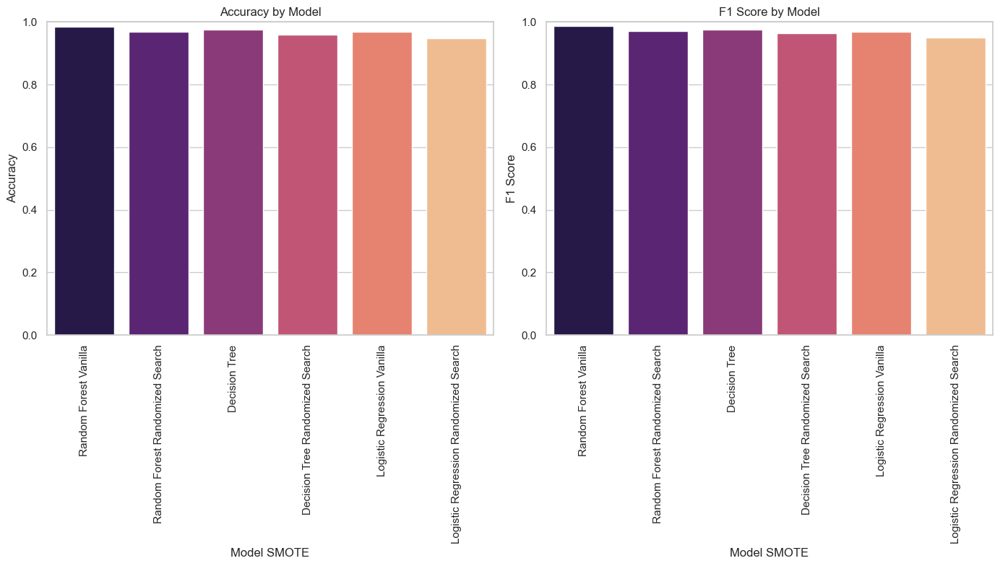

In [331]:
sns.set(style="whitegrid")

# Create a figure with subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 8))

# Plot Accuracy with magma colormap
sns.barplot(data=results_df, x='Model', y='Accuracy', ax=axes[0], palette='magma')
axes[0].set_title('Accuracy by Model')
axes[0].set_ylabel('Accuracy')
axes[0].set_xlabel('Model SMOTE')
axes[0].set_ylim(0, 1)  # Set y-axis limits for accuracy (0 to 1)
axes[0].tick_params(axis='x', rotation=90)  # Rotate x-axis labels for better readability

# Plot F1 Score with magma colormap
sns.barplot(data=results_df, x='Model', y='F1 Score', ax=axes[1], palette='magma')
axes[1].set_title('F1 Score by Model')
axes[1].set_ylabel('F1 Score')
axes[1].set_xlabel('Model SMOTE')
axes[1].set_ylim(0, 1)  # Set y-axis limits for F1 score (0 to 1)
axes[1].tick_params(axis='x', rotation=90)  # Rotate x-axis labels for better readability

# Adjust layout
plt.tight_layout()
plt.show()

c:\Users\zeina\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\svm\_base.py:1235: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.



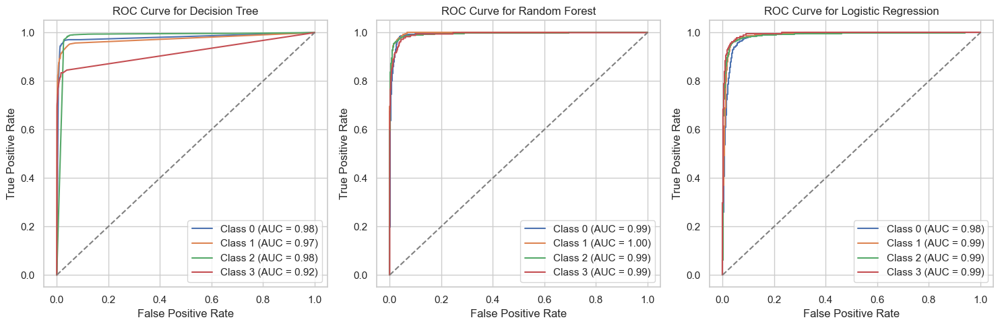

In [332]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve, auc

X = df_encoded.drop("school_type_encoded", axis=1) 
y = df_encoded["school_type_encoded"] 

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
# Define the classifiers
classifiers = {
    'Decision Tree': DecisionTreeClassifier(min_samples_split= 2, max_depth = 10, criterion = 'entropy', random_state=42),
    'Random Forest': RandomForestClassifier(n_estimators=100, max_depth=10, class_weight='balanced', random_state=42),
    'Logistic Regression': LogisticRegression(penalty='l2', C=0.1, solver='liblinear', class_weight='balanced', random_state=42)
}

# Initialize a dictionary to store ROC curve data
fpr = {}
tpr = {}
roc_auc = {}

# Prepare for plotting ROC curves
plt.figure(figsize=(15, 5))

# Loop over classifiers, fit them, and plot ROC curves
for i, (name, clf) in enumerate(classifiers.items(), 1):
    # Train the classifier
    clf.fit(X_train, y_train)
    
    # Predict probabilities for the test set
    y_probs = clf.predict_proba(X_test)
    
    # Handle multiclass ROC curve
    n_classes = np.unique(y).shape[0]
    fpr[name] = {}
    tpr[name] = {}
    roc_auc[name] = {}
    
    for j in range(n_classes):
        fpr[name][j], tpr[name][j], _ = roc_curve(y_test == j, y_probs[:, j])
        roc_auc[name][j] = auc(fpr[name][j], tpr[name][j])

    # Plot the ROC curve for each class in the classifier
    plt.subplot(1, 3, i)
    
    for j in range(n_classes):
        plt.plot(fpr[name][j], tpr[name][j], label=f'Class {j} (AUC = {roc_auc[name][j]:.2f})')
    
    # Add diagonal (chance line)
    plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
    
    # Labels and title
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'ROC Curve for {name}')
    plt.legend(loc='best')

# Show the ROC curve plot
plt.tight_layout()
plt.show()


#### AUC scores are better in Random Forest and Logistic Regression than decision trees. Decision tree's AUC score is good but shows that it's ability to distinguish between classes is less accurate than Random Forest and Logistic Regression. 